<a href="https://colab.research.google.com/github/ShuaimingJing/CV_project2/blob/main/shuaiming's_experiment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
! pip install torchmetrics
! pip install torch-fidelity
! pip install torchmetrics[image]

In [4]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms, datasets
import os
from torchvision.datasets import ImageFolder
from torchvision.transforms import ToTensor
from google.colab import drive
from torch.utils.data import random_split
import matplotlib.pyplot as plt
import torchvision.utils as vutils
import cv2
from PIL import Image
from pathlib import Path
from tqdm import tqdm
from torchmetrics.image.fid import FrechetInceptionDistance
from torchmetrics.image.inception import InceptionScore
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
def crop_faces(input_dir, output_dir, face_cascade_path='haarcascade_frontalface_default.xml'):
    """
    Detects and crops faces from images in the input directory and saves them to the output directory,
    maintaining class subdirectories.

    Args:
        input_dir (str): Path to the directory containing input images organized in class subdirectories.
        output_dir (str): Path to the directory where cropped face images will be saved, maintaining class subdirectories.
        face_cascade_path (str): Path to the Haar Cascade XML file for face detection.
    """
    # Initialize face cascade
    face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + face_cascade_path)
    if face_cascade.empty():
        raise IOError("Cannot load Haar cascade xml file for face detection.")

    # Get list of class directories
    class_dirs = [d for d in Path(input_dir).iterdir() if d.is_dir()]

    for class_dir in class_dirs:
        class_name = class_dir.name
        output_class_dir = Path(output_dir) / class_name
        output_class_dir.mkdir(parents=True, exist_ok=True)

        # Get list of image paths in the class directory
        image_paths = sorted(class_dir.glob("*.jpg"))  # Adjust extension if needed

        for i, img_path in enumerate(tqdm(image_paths, desc=f"Cropping Faces in {class_name}")):
            img = cv2.imread(str(img_path))
            if img is None:
                print(f"Warning: Unable to read image {img_path}. Skipping.")
                continue

            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            faces = face_cascade.detectMultiScale(gray, scaleFactor=1.3, minNeighbors=5)

            if len(faces) == 0:
                print(f"No face detected in image {img_path}. Skipping.")
                continue

            # Save only the first detected face
            (x, y, w, h) = faces[0]
            face = img[y:y+h, x:x+w]

            # Convert BGR to RGB before saving
            face_rgb = cv2.cvtColor(face, cv2.COLOR_BGR2RGB)
            face_pil = Image.fromarray(face_rgb)

            # Resize the face to a consistent size before saving
            face_pil = face_pil.resize((64, 64), Image.Resampling.LANCZOS)


            # Save the cropped face
            save_path = output_class_dir / f"{class_name}_{i}.jpg"
            face_pil.save(save_path)

# Preprocess images by cropping faces
input_dir = "/content/drive/My Drive/CV_team_project2/final_images"
cropped_dir = "/content/drive/My Drive/CV_team_project2/final_images_cropped"

print("Starting face cropping...")
crop_faces(input_dir, cropped_dir)
print("Face cropping completed.")

In [5]:
# Helper function for weight initialization
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

class Discriminator(nn.Module):
    def __init__(self, emb_size=32):
        super(Discriminator, self).__init__()
        self.emb_size = 32
        self.label_embeddings = nn.Embedding(7, self.emb_size)
        self.model = nn.Sequential(
            nn.Conv2d(3,64,4,2,1,bias=False),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Conv2d(64,64*2,4,2,1,bias=False),
            nn.BatchNorm2d(64*2),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Conv2d(64*2,64*4,4,2,1,bias=False),
            nn.BatchNorm2d(64*4),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Conv2d(64*4,64*8,4,2,1,bias=False),
            nn.BatchNorm2d(64*8),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Conv2d(64*8,64,4,2,1,bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Flatten()
        )
        self.model2 = nn.Sequential(
            nn.Linear(288,100),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Linear(100,1),
            nn.Sigmoid()
        )
        self.apply(weights_init)
    def forward(self, input, labels):
        x = self.model(input)
        y = self.label_embeddings(labels)
        input = torch.cat([x, y], 1)
        final_output = self.model2(input)
        return final_output


class Generator(nn.Module):
    def __init__(self, emb_size=32):
        super(Generator,self).__init__()
        self.emb_size = emb_size
        self.label_embeddings = nn.Embedding(7, self.emb_size)
        self.model = nn.Sequential(
            nn.ConvTranspose2d(100+self.emb_size,64*8,4,1,0,bias=False),
            nn.BatchNorm2d(64*8),
            nn.ReLU(True),
            nn.ConvTranspose2d(64*8,64*4,4,2,1,bias=False),
            nn.BatchNorm2d(64*4),
            nn.ReLU(True),
            nn.ConvTranspose2d(64*4,64*2,4,2,1,bias=False),
            nn.BatchNorm2d(64*2),
            nn.ReLU(True),
            nn.ConvTranspose2d(64*2,64,4,2,1,bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(64,3,4,2,1,bias=False),
            nn.Tanh()
        )
        self.apply(weights_init)
    def forward(self,input_noise,labels):
        label_embeddings = self.label_embeddings(labels).view(len(labels), self.emb_size, 1, 1)
        input = torch.cat([input_noise, label_embeddings], 1)
        return self.model(input)

In [13]:
age_range_to_label = {
    "15-20": 0,
    "20-25": 1,
    "25-30": 2,
    "30-40": 3,
    "40-50": 4,
    "50-60": 5,
    "60-70": 6
}

class CustomImageFolder(ImageFolder):
    def __init__(self, root, transform=None, label_map=None):
        super().__init__(root, transform)
        self.label_map = label_map

    def __getitem__(self, index):
        img, label = super().__getitem__(index)
        # Map label to the new label based on the folder name
        class_name = self.classes[label]
        mapped_label = self.label_map[class_name]
        return img, mapped_label

# Use the custom dataset
dataset = CustomImageFolder(
    root="/content/drive/My Drive/CV_team_project2/final_images_cropped",
    transform=transforms.Compose([
        transforms.Resize((64, 64)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.5], [0.5])  # Normalize to [-1, 1]
    ]),
    label_map=age_range_to_label
)
# Calculate split sizes
dataset_size = len(dataset)
train_size = int(0.5 * dataset_size)
test_size = dataset_size - train_size

# Split the dataset
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])

# DataLoaders for train and validation sets
batch_size = 128
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

num_classes = len(age_range_to_label)  # Number of age ranges

generator = Generator(emb_size=32)
discriminator = Discriminator(emb_size=32)

generator.label_embeddings = nn.Embedding(num_classes, 32)
discriminator.label_embeddings = nn.Embedding(num_classes, 32)



[Epoch 1/150] [Batch 1/79] [D loss: 0.1436738520860672] [G loss: 2.1139111518859863]
[Epoch 1/150] [Batch 2/79] [D loss: 0.34134718775749207] [G loss: 4.865762233734131]
[Epoch 1/150] [Batch 3/79] [D loss: 0.038277894258499146] [G loss: 5.429917812347412]
[Epoch 1/150] [Batch 4/79] [D loss: 0.050809096544981] [G loss: 5.16108512878418]
[Epoch 1/150] [Batch 5/79] [D loss: 0.04710085317492485] [G loss: 4.752118110656738]
[Epoch 1/150] [Batch 6/79] [D loss: 0.03446211665868759] [G loss: 4.449423789978027]
[Epoch 1/150] [Batch 7/79] [D loss: 0.04599979519844055] [G loss: 4.1404619216918945]
[Epoch 1/150] [Batch 8/79] [D loss: 0.07160112261772156] [G loss: 4.059122562408447]
[Epoch 1/150] [Batch 9/79] [D loss: 0.09186188876628876] [G loss: 4.940859317779541]
[Epoch 1/150] [Batch 10/79] [D loss: 0.07666876167058945] [G loss: 4.258397102355957]
[Epoch 1/150] [Batch 11/79] [D loss: 0.04227990657091141] [G loss: 4.280324459075928]
[Epoch 1/150] [Batch 12/79] [D loss: 0.10720884799957275] [G los

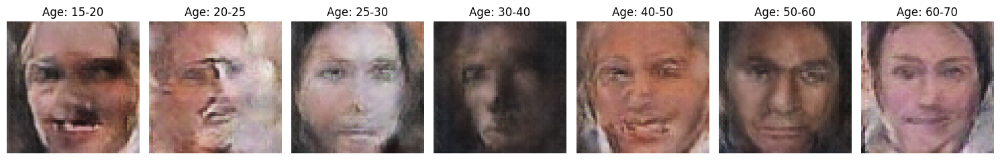

Saved checkpoint for epoch 1 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_1.pth
[Epoch 2/150] [Batch 1/79] [D loss: 0.04645000398159027] [G loss: 5.607276439666748]
[Epoch 2/150] [Batch 2/79] [D loss: 0.037783682346343994] [G loss: 5.895840644836426]
[Epoch 2/150] [Batch 3/79] [D loss: 0.05497470125555992] [G loss: 6.52052640914917]
[Epoch 2/150] [Batch 4/79] [D loss: 0.013776332139968872] [G loss: 6.654696464538574]
[Epoch 2/150] [Batch 5/79] [D loss: 0.10271099209785461] [G loss: 3.9816842079162598]
[Epoch 2/150] [Batch 6/79] [D loss: 0.14534682035446167] [G loss: 7.758970737457275]
[Epoch 2/150] [Batch 7/79] [D loss: 0.07276014238595963] [G loss: 7.306957244873047]
[Epoch 2/150] [Batch 8/79] [D loss: 0.032438572496175766] [G loss: 5.9753522872924805]
[Epoch 2/150] [Batch 9/79] [D loss: 0.048486851155757904] [G loss: 4.638232231140137]
[Epoch 2/150] [Batch 10/79] [D loss: 0.049010585993528366] [G loss: 5.483994960784912]
[Epoch 2/150] [Batch 11/79] [

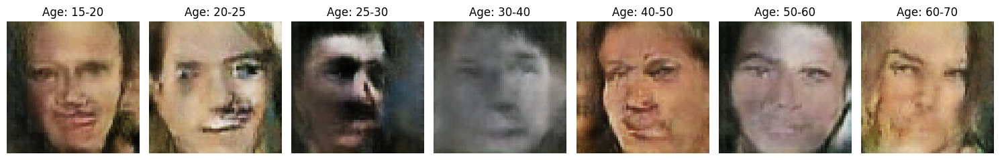

Saved checkpoint for epoch 2 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_2.pth
[Epoch 3/150] [Batch 1/79] [D loss: 0.023793380707502365] [G loss: 5.044224739074707]
[Epoch 3/150] [Batch 2/79] [D loss: 0.2943897545337677] [G loss: 11.52944564819336]
[Epoch 3/150] [Batch 3/79] [D loss: 1.5043327808380127] [G loss: 10.036808013916016]
[Epoch 3/150] [Batch 4/79] [D loss: 0.5738146305084229] [G loss: 7.423550605773926]
[Epoch 3/150] [Batch 5/79] [D loss: 0.014575419016182423] [G loss: 4.457998275756836]
[Epoch 3/150] [Batch 6/79] [D loss: 0.2796613872051239] [G loss: 7.212388515472412]
[Epoch 3/150] [Batch 7/79] [D loss: 0.011622963473200798] [G loss: 7.270256996154785]
[Epoch 3/150] [Batch 8/79] [D loss: 0.013008547946810722] [G loss: 6.852351188659668]
[Epoch 3/150] [Batch 9/79] [D loss: 0.031639400869607925] [G loss: 6.257180213928223]
[Epoch 3/150] [Batch 10/79] [D loss: 0.05129709094762802] [G loss: 6.155255317687988]
[Epoch 3/150] [Batch 11/79] [D lo

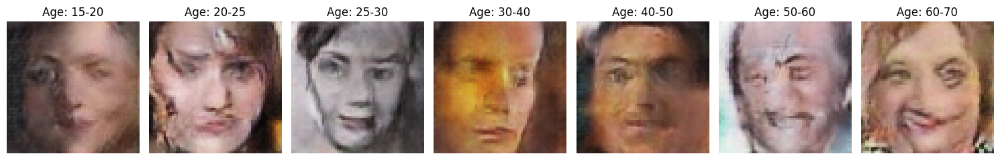

Saved checkpoint for epoch 3 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_3.pth
[Epoch 4/150] [Batch 1/79] [D loss: 0.030402250587940216] [G loss: 5.005640029907227]
[Epoch 4/150] [Batch 2/79] [D loss: 0.042710915207862854] [G loss: 6.649538993835449]
[Epoch 4/150] [Batch 3/79] [D loss: 0.023867357522249222] [G loss: 5.91589879989624]
[Epoch 4/150] [Batch 4/79] [D loss: 0.00830099731683731] [G loss: 5.734005928039551]
[Epoch 4/150] [Batch 5/79] [D loss: 0.07234903424978256] [G loss: 7.368497848510742]
[Epoch 4/150] [Batch 6/79] [D loss: 0.17361240088939667] [G loss: 1.9514625072479248]
[Epoch 4/150] [Batch 7/79] [D loss: 0.5043298006057739] [G loss: 13.192078590393066]
[Epoch 4/150] [Batch 8/79] [D loss: 2.5069282054901123] [G loss: 10.486088752746582]
[Epoch 4/150] [Batch 9/79] [D loss: 0.9034956097602844] [G loss: 6.781744956970215]
[Epoch 4/150] [Batch 10/79] [D loss: 0.0336502268910408] [G loss: 3.5668492317199707]
[Epoch 4/150] [Batch 11/79] [D lo

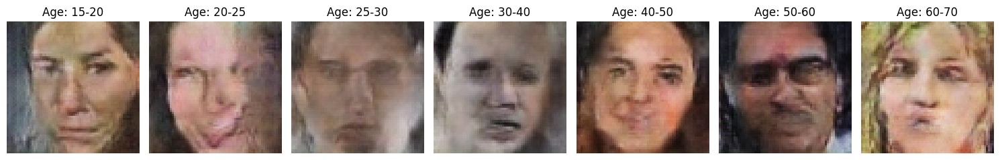

Saved checkpoint for epoch 4 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_4.pth
[Epoch 5/150] [Batch 1/79] [D loss: 0.3253188133239746] [G loss: 4.502490043640137]
[Epoch 5/150] [Batch 2/79] [D loss: 0.12016570568084717] [G loss: 3.9207680225372314]
[Epoch 5/150] [Batch 3/79] [D loss: 0.09781225770711899] [G loss: 5.268451690673828]
[Epoch 5/150] [Batch 4/79] [D loss: 0.018726851791143417] [G loss: 5.5602707862854]
[Epoch 5/150] [Batch 5/79] [D loss: 0.027880815789103508] [G loss: 5.2557759284973145]
[Epoch 5/150] [Batch 6/79] [D loss: 0.05137452483177185] [G loss: 4.786544322967529]
[Epoch 5/150] [Batch 7/79] [D loss: 0.03375745564699173] [G loss: 4.5688371658325195]
[Epoch 5/150] [Batch 8/79] [D loss: 0.030319785699248314] [G loss: 4.185941219329834]
[Epoch 5/150] [Batch 9/79] [D loss: 0.02665158174932003] [G loss: 4.37626838684082]
[Epoch 5/150] [Batch 10/79] [D loss: 0.04628182202577591] [G loss: 4.122189521789551]
[Epoch 5/150] [Batch 11/79] [D lo

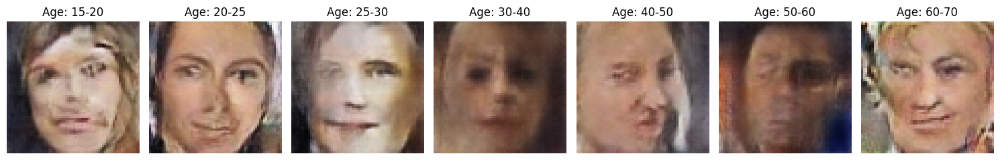

Saved checkpoint for epoch 5 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_5.pth
[Epoch 6/150] [Batch 1/79] [D loss: 0.022109393030405045] [G loss: 5.539804458618164]
[Epoch 6/150] [Batch 2/79] [D loss: 0.02656703069806099] [G loss: 5.064899444580078]
[Epoch 6/150] [Batch 3/79] [D loss: 0.05093550682067871] [G loss: 3.5653600692749023]
[Epoch 6/150] [Batch 4/79] [D loss: 0.16636887192726135] [G loss: 9.428093910217285]
[Epoch 6/150] [Batch 5/79] [D loss: 0.5000219941139221] [G loss: 6.426795959472656]
[Epoch 6/150] [Batch 6/79] [D loss: 0.02239719033241272] [G loss: 4.828984260559082]
[Epoch 6/150] [Batch 7/79] [D loss: 0.17061194777488708] [G loss: 8.936116218566895]
[Epoch 6/150] [Batch 8/79] [D loss: 0.0860481783747673] [G loss: 8.755563735961914]
[Epoch 6/150] [Batch 9/79] [D loss: 0.0817442387342453] [G loss: 6.092374801635742]
[Epoch 6/150] [Batch 10/79] [D loss: 0.025840578600764275] [G loss: 5.464879035949707]
[Epoch 6/150] [Batch 11/79] [D loss

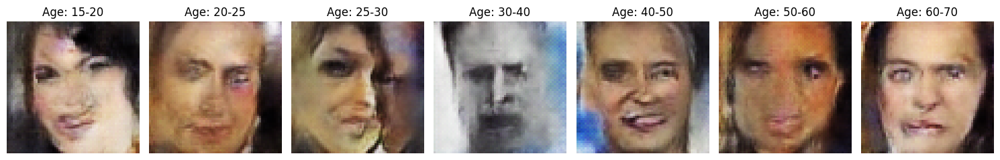

Saved checkpoint for epoch 6 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_6.pth
[Epoch 7/150] [Batch 1/79] [D loss: 0.18955440819263458] [G loss: 12.119709014892578]
[Epoch 7/150] [Batch 2/79] [D loss: 0.23774053156375885] [G loss: 11.30674934387207]
[Epoch 7/150] [Batch 3/79] [D loss: 0.04743177816271782] [G loss: 9.124712944030762]
[Epoch 7/150] [Batch 4/79] [D loss: 0.006952041760087013] [G loss: 8.376167297363281]
[Epoch 7/150] [Batch 5/79] [D loss: 0.04408515989780426] [G loss: 8.39250373840332]
[Epoch 7/150] [Batch 6/79] [D loss: 0.006107344292104244] [G loss: 8.131047248840332]
[Epoch 7/150] [Batch 7/79] [D loss: 0.020750734955072403] [G loss: 7.187378883361816]
[Epoch 7/150] [Batch 8/79] [D loss: 0.01306887436658144] [G loss: 7.340093612670898]
[Epoch 7/150] [Batch 9/79] [D loss: 0.03996264562010765] [G loss: 6.239195823669434]
[Epoch 7/150] [Batch 10/79] [D loss: 0.013937393203377724] [G loss: 6.181605815887451]
[Epoch 7/150] [Batch 11/79] [D 

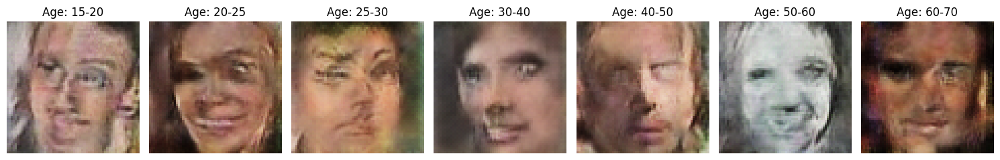

Saved checkpoint for epoch 7 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_7.pth
[Epoch 8/150] [Batch 1/79] [D loss: 0.03826330974698067] [G loss: 6.089073181152344]
[Epoch 8/150] [Batch 2/79] [D loss: 0.012946072965860367] [G loss: 6.151196479797363]
[Epoch 8/150] [Batch 3/79] [D loss: 0.06275754421949387] [G loss: 4.628911018371582]
[Epoch 8/150] [Batch 4/79] [D loss: 0.09127034991979599] [G loss: 7.150694847106934]
[Epoch 8/150] [Batch 5/79] [D loss: 0.06586450338363647] [G loss: 6.034306526184082]
[Epoch 8/150] [Batch 6/79] [D loss: 0.0375593863427639] [G loss: 5.7422003746032715]
[Epoch 8/150] [Batch 7/79] [D loss: 0.0164177305996418] [G loss: 6.454469680786133]
[Epoch 8/150] [Batch 8/79] [D loss: 0.025688912719488144] [G loss: 6.699875354766846]
[Epoch 8/150] [Batch 9/79] [D loss: 0.01771383360028267] [G loss: 6.451274871826172]
[Epoch 8/150] [Batch 10/79] [D loss: 0.020134367048740387] [G loss: 6.151945114135742]
[Epoch 8/150] [Batch 11/79] [D lo

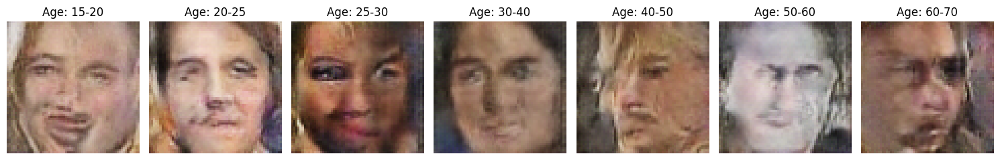

Saved checkpoint for epoch 8 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_8.pth
[Epoch 9/150] [Batch 1/79] [D loss: 1.5717270374298096] [G loss: 11.816844940185547]
[Epoch 9/150] [Batch 2/79] [D loss: 0.8934433460235596] [G loss: 9.029413223266602]
[Epoch 9/150] [Batch 3/79] [D loss: 0.04939887672662735] [G loss: 6.685778617858887]
[Epoch 9/150] [Batch 4/79] [D loss: 0.12298053503036499] [G loss: 6.551267623901367]
[Epoch 9/150] [Batch 5/79] [D loss: 0.10182800889015198] [G loss: 5.986005783081055]
[Epoch 9/150] [Batch 6/79] [D loss: 0.05331473797559738] [G loss: 7.285691261291504]
[Epoch 9/150] [Batch 7/79] [D loss: 0.08716699481010437] [G loss: 5.021384239196777]
[Epoch 9/150] [Batch 8/79] [D loss: 0.16543667018413544] [G loss: 9.633256912231445]
[Epoch 9/150] [Batch 9/79] [D loss: 0.5264164209365845] [G loss: 5.801990509033203]
[Epoch 9/150] [Batch 10/79] [D loss: 0.08271753787994385] [G loss: 7.389424800872803]
[Epoch 9/150] [Batch 11/79] [D loss: 

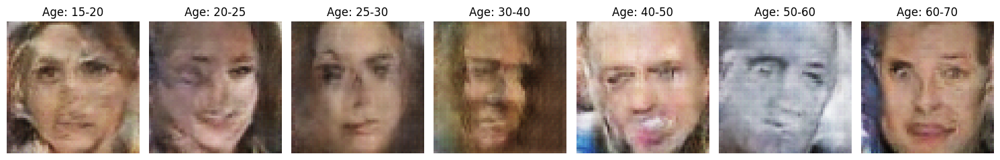

Saved checkpoint for epoch 9 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_9.pth
[Epoch 10/150] [Batch 1/79] [D loss: 0.035457901656627655] [G loss: 5.181363582611084]
[Epoch 10/150] [Batch 2/79] [D loss: 0.04242660850286484] [G loss: 4.954347133636475]
[Epoch 10/150] [Batch 3/79] [D loss: 0.06280533969402313] [G loss: 4.882408618927002]
[Epoch 10/150] [Batch 4/79] [D loss: 0.04393293708562851] [G loss: 4.986428737640381]
[Epoch 10/150] [Batch 5/79] [D loss: 0.03403625637292862] [G loss: 4.883288860321045]
[Epoch 10/150] [Batch 6/79] [D loss: 0.03475411608815193] [G loss: 4.778809547424316]
[Epoch 10/150] [Batch 7/79] [D loss: 0.06570932269096375] [G loss: 5.445376873016357]
[Epoch 10/150] [Batch 8/79] [D loss: 0.04362710937857628] [G loss: 4.975686073303223]
[Epoch 10/150] [Batch 9/79] [D loss: 0.04009038209915161] [G loss: 4.9716386795043945]
[Epoch 10/150] [Batch 10/79] [D loss: 0.030924292281270027] [G loss: 4.9226226806640625]
[Epoch 10/150] [Batch

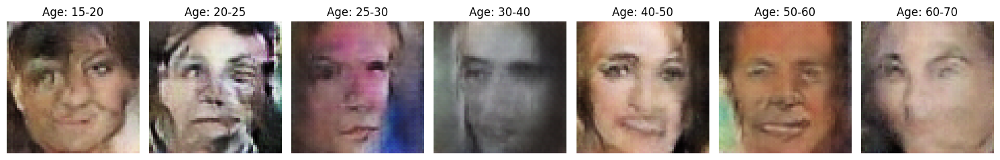

Saved checkpoint for epoch 10 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_10.pth
[Epoch 11/150] [Batch 1/79] [D loss: 0.09949102252721786] [G loss: 4.626688003540039]
[Epoch 11/150] [Batch 2/79] [D loss: 0.07215039432048798] [G loss: 6.4933061599731445]
[Epoch 11/150] [Batch 3/79] [D loss: 0.029289979487657547] [G loss: 6.155451774597168]
[Epoch 11/150] [Batch 4/79] [D loss: 0.029023427516222] [G loss: 5.544264316558838]
[Epoch 11/150] [Batch 5/79] [D loss: 0.09477750957012177] [G loss: 6.92951774597168]
[Epoch 11/150] [Batch 6/79] [D loss: 0.06085493415594101] [G loss: 5.968469142913818]
[Epoch 11/150] [Batch 7/79] [D loss: 0.04932664334774017] [G loss: 5.508218765258789]
[Epoch 11/150] [Batch 8/79] [D loss: 0.11998844891786575] [G loss: 8.414356231689453]
[Epoch 11/150] [Batch 9/79] [D loss: 0.14893090724945068] [G loss: 6.291614055633545]
[Epoch 11/150] [Batch 10/79] [D loss: 0.06802286952733994] [G loss: 8.073630332946777]
[Epoch 11/150] [Batch 11

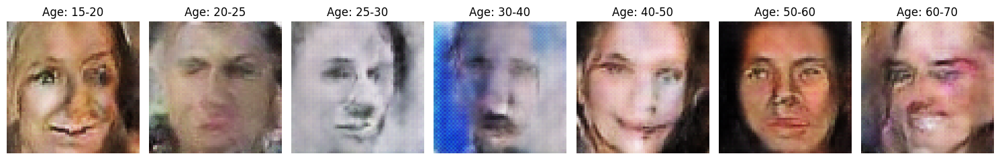

Saved checkpoint for epoch 11 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_11.pth
[Epoch 12/150] [Batch 1/79] [D loss: 0.08453314006328583] [G loss: 3.9656453132629395]
[Epoch 12/150] [Batch 2/79] [D loss: 0.10211970657110214] [G loss: 10.46950912475586]
[Epoch 12/150] [Batch 3/79] [D loss: 0.38817062973976135] [G loss: 6.770321846008301]
[Epoch 12/150] [Batch 4/79] [D loss: 0.017019502818584442] [G loss: 5.507025718688965]
[Epoch 12/150] [Batch 5/79] [D loss: 0.13575907051563263] [G loss: 10.447786331176758]
[Epoch 12/150] [Batch 6/79] [D loss: 0.07531136274337769] [G loss: 10.639093399047852]
[Epoch 12/150] [Batch 7/79] [D loss: 0.05124717205762863] [G loss: 9.344470977783203]
[Epoch 12/150] [Batch 8/79] [D loss: 0.013376983813941479] [G loss: 8.449962615966797]
[Epoch 12/150] [Batch 9/79] [D loss: 0.004895477555692196] [G loss: 7.99798059463501]
[Epoch 12/150] [Batch 10/79] [D loss: 0.020083216950297356] [G loss: 7.844443321228027]
[Epoch 12/150] [B

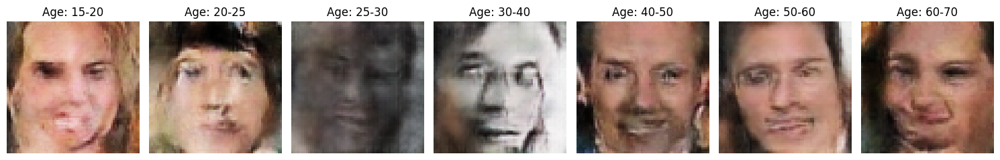

Saved checkpoint for epoch 12 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_12.pth
[Epoch 13/150] [Batch 1/79] [D loss: 0.07510358840227127] [G loss: 8.424362182617188]
[Epoch 13/150] [Batch 2/79] [D loss: 0.031636521220207214] [G loss: 8.521156311035156]
[Epoch 13/150] [Batch 3/79] [D loss: 0.027122877538204193] [G loss: 7.127647876739502]
[Epoch 13/150] [Batch 4/79] [D loss: 0.036252472549676895] [G loss: 7.368457317352295]
[Epoch 13/150] [Batch 5/79] [D loss: 0.006083238869905472] [G loss: 7.816932678222656]
[Epoch 13/150] [Batch 6/79] [D loss: 0.03763141483068466] [G loss: 6.544456481933594]
[Epoch 13/150] [Batch 7/79] [D loss: 0.02753486856818199] [G loss: 6.270610809326172]
[Epoch 13/150] [Batch 8/79] [D loss: 0.03699726238846779] [G loss: 7.1881279945373535]
[Epoch 13/150] [Batch 9/79] [D loss: 0.038756273686885834] [G loss: 6.421897888183594]
[Epoch 13/150] [Batch 10/79] [D loss: 0.01957877166569233] [G loss: 5.755766868591309]
[Epoch 13/150] [B

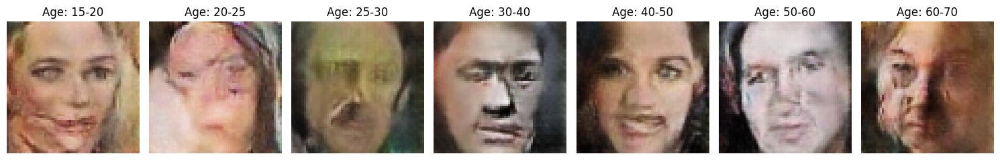

Saved checkpoint for epoch 13 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_13.pth
[Epoch 14/150] [Batch 1/79] [D loss: 0.012573374435305595] [G loss: 6.287034511566162]
[Epoch 14/150] [Batch 2/79] [D loss: 0.033722613006830215] [G loss: 5.742287635803223]
[Epoch 14/150] [Batch 3/79] [D loss: 0.02931615710258484] [G loss: 6.6419806480407715]
[Epoch 14/150] [Batch 4/79] [D loss: 0.025556420907378197] [G loss: 5.8942484855651855]
[Epoch 14/150] [Batch 5/79] [D loss: 0.09274011850357056] [G loss: 10.142284393310547]
[Epoch 14/150] [Batch 6/79] [D loss: 0.42955562472343445] [G loss: 4.678401947021484]
[Epoch 14/150] [Batch 7/79] [D loss: 0.511620819568634] [G loss: 15.192197799682617]
[Epoch 14/150] [Batch 8/79] [D loss: 1.5266225337982178] [G loss: 11.904423713684082]
[Epoch 14/150] [Batch 9/79] [D loss: 0.04587874189019203] [G loss: 10.995965957641602]
[Epoch 14/150] [Batch 10/79] [D loss: 0.1682068258523941] [G loss: 13.121898651123047]
[Epoch 14/150] [B

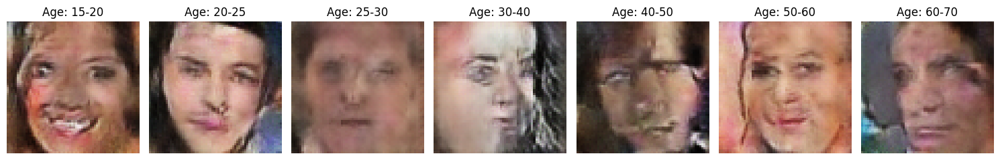

Saved checkpoint for epoch 14 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_14.pth
[Epoch 15/150] [Batch 1/79] [D loss: 0.011753665283322334] [G loss: 6.919242858886719]
[Epoch 15/150] [Batch 2/79] [D loss: 0.009922847151756287] [G loss: 6.44635009765625]
[Epoch 15/150] [Batch 3/79] [D loss: 0.012071071192622185] [G loss: 5.867610931396484]
[Epoch 15/150] [Batch 4/79] [D loss: 0.017850156873464584] [G loss: 6.0183305740356445]
[Epoch 15/150] [Batch 5/79] [D loss: 0.03338323161005974] [G loss: 4.840288162231445]
[Epoch 15/150] [Batch 6/79] [D loss: 0.03447870537638664] [G loss: 5.066876411437988]
[Epoch 15/150] [Batch 7/79] [D loss: 0.04804408922791481] [G loss: 9.517477035522461]
[Epoch 15/150] [Batch 8/79] [D loss: 0.05988125503063202] [G loss: 6.4719953536987305]
[Epoch 15/150] [Batch 9/79] [D loss: 0.012546835467219353] [G loss: 5.8474650382995605]
[Epoch 15/150] [Batch 10/79] [D loss: 0.01869487762451172] [G loss: 5.563259601593018]
[Epoch 15/150] [

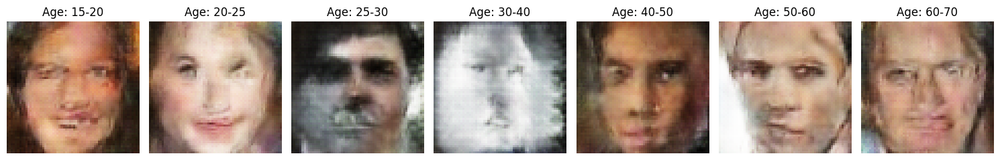

Saved checkpoint for epoch 15 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_15.pth
[Epoch 16/150] [Batch 1/79] [D loss: 0.027167633175849915] [G loss: 5.207220554351807]
[Epoch 16/150] [Batch 2/79] [D loss: 0.064372718334198] [G loss: 8.971712112426758]
[Epoch 16/150] [Batch 3/79] [D loss: 0.019630253314971924] [G loss: 8.902812957763672]
[Epoch 16/150] [Batch 4/79] [D loss: 0.021661683917045593] [G loss: 8.216288566589355]
[Epoch 16/150] [Batch 5/79] [D loss: 0.04022962599992752] [G loss: 7.108724594116211]
[Epoch 16/150] [Batch 6/79] [D loss: 0.03707577660679817] [G loss: 7.671727180480957]
[Epoch 16/150] [Batch 7/79] [D loss: 0.006999752949923277] [G loss: 7.726664066314697]
[Epoch 16/150] [Batch 8/79] [D loss: 0.009599750861525536] [G loss: 6.921102523803711]
[Epoch 16/150] [Batch 9/79] [D loss: 0.01721816509962082] [G loss: 6.313327789306641]
[Epoch 16/150] [Batch 10/79] [D loss: 0.014748714864253998] [G loss: 5.748680114746094]
[Epoch 16/150] [Bat

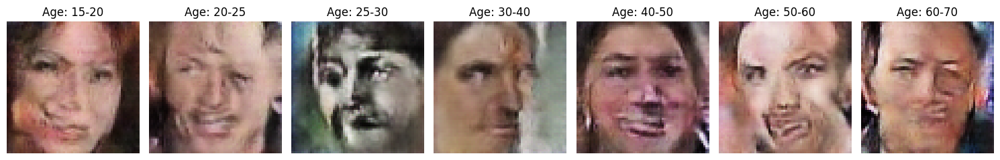

Saved checkpoint for epoch 16 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_16.pth
[Epoch 17/150] [Batch 1/79] [D loss: 0.02627798169851303] [G loss: 5.369356155395508]
[Epoch 17/150] [Batch 2/79] [D loss: 0.032188307493925095] [G loss: 7.590998649597168]
[Epoch 17/150] [Batch 3/79] [D loss: 0.014781068079173565] [G loss: 6.87247371673584]
[Epoch 17/150] [Batch 4/79] [D loss: 0.011064284481108189] [G loss: 6.330633163452148]
[Epoch 17/150] [Batch 5/79] [D loss: 0.018312130123376846] [G loss: 6.002939224243164]
[Epoch 17/150] [Batch 6/79] [D loss: 0.045868054032325745] [G loss: 6.488089561462402]
[Epoch 17/150] [Batch 7/79] [D loss: 0.03505885601043701] [G loss: 5.335091590881348]
[Epoch 17/150] [Batch 8/79] [D loss: 0.020915506407618523] [G loss: 4.858356475830078]
[Epoch 17/150] [Batch 9/79] [D loss: 0.025768078863620758] [G loss: 6.550489902496338]
[Epoch 17/150] [Batch 10/79] [D loss: 0.022108178585767746] [G loss: 6.000853538513184]
[Epoch 17/150] [

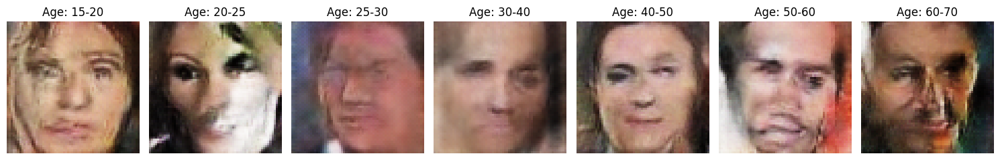

Saved checkpoint for epoch 17 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_17.pth
[Epoch 18/150] [Batch 1/79] [D loss: 0.020413512364029884] [G loss: 8.2877779006958]
[Epoch 18/150] [Batch 2/79] [D loss: 0.00420795613899827] [G loss: 8.639604568481445]
[Epoch 18/150] [Batch 3/79] [D loss: 0.007387955207377672] [G loss: 7.378129959106445]
[Epoch 18/150] [Batch 4/79] [D loss: 0.010146834887564182] [G loss: 6.765242576599121]
[Epoch 18/150] [Batch 5/79] [D loss: 0.01379389874637127] [G loss: 5.829452037811279]
[Epoch 18/150] [Batch 6/79] [D loss: 0.018741151317954063] [G loss: 5.651902198791504]
[Epoch 18/150] [Batch 7/79] [D loss: 0.043986931443214417] [G loss: 9.02772331237793]
[Epoch 18/150] [Batch 8/79] [D loss: 0.15911586582660675] [G loss: 3.980836868286133]
[Epoch 18/150] [Batch 9/79] [D loss: 0.2538566291332245] [G loss: 14.012500762939453]
[Epoch 18/150] [Batch 10/79] [D loss: 2.019782304763794] [G loss: 9.635555267333984]
[Epoch 18/150] [Batch 1

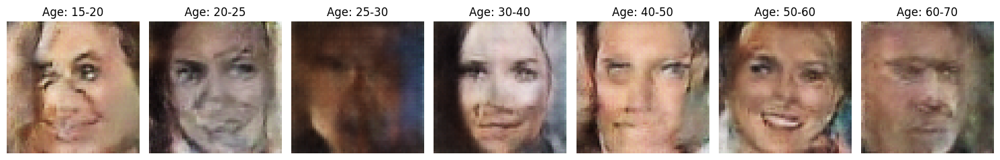

Saved checkpoint for epoch 18 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_18.pth
[Epoch 19/150] [Batch 1/79] [D loss: 0.009654957801103592] [G loss: 5.980960845947266]
[Epoch 19/150] [Batch 2/79] [D loss: 0.06447836756706238] [G loss: 8.815495491027832]
[Epoch 19/150] [Batch 3/79] [D loss: 0.08197379857301712] [G loss: 6.897679328918457]
[Epoch 19/150] [Batch 4/79] [D loss: 0.01632883958518505] [G loss: 4.925388813018799]
[Epoch 19/150] [Batch 5/79] [D loss: 0.07428647577762604] [G loss: 9.519237518310547]
[Epoch 19/150] [Batch 6/79] [D loss: 0.11854104697704315] [G loss: 7.241911888122559]
[Epoch 19/150] [Batch 7/79] [D loss: 0.014266056939959526] [G loss: 6.47111701965332]
[Epoch 19/150] [Batch 8/79] [D loss: 0.038952313363552094] [G loss: 8.978187561035156]
[Epoch 19/150] [Batch 9/79] [D loss: 0.006266424898058176] [G loss: 9.09537410736084]
[Epoch 19/150] [Batch 10/79] [D loss: 0.01937873847782612] [G loss: 7.579655647277832]
[Epoch 19/150] [Batch

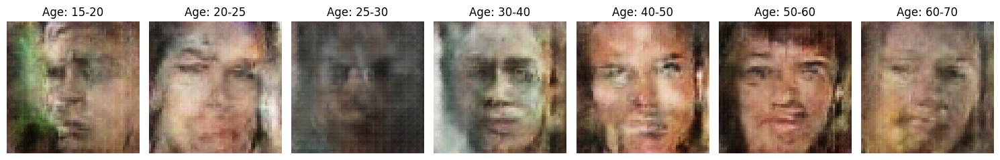

Saved checkpoint for epoch 19 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_19.pth
[Epoch 20/150] [Batch 1/79] [D loss: 0.05260852351784706] [G loss: 6.277032852172852]
[Epoch 20/150] [Batch 2/79] [D loss: 0.05968455970287323] [G loss: 5.685199737548828]
[Epoch 20/150] [Batch 3/79] [D loss: 0.0212496779859066] [G loss: 5.1882195472717285]
[Epoch 20/150] [Batch 4/79] [D loss: 0.013042081147432327] [G loss: 5.4088215827941895]
[Epoch 20/150] [Batch 5/79] [D loss: 0.05413447320461273] [G loss: 7.25912618637085]
[Epoch 20/150] [Batch 6/79] [D loss: 0.04751332104206085] [G loss: 7.042492866516113]
[Epoch 20/150] [Batch 7/79] [D loss: 0.01971886307001114] [G loss: 5.818454265594482]
[Epoch 20/150] [Batch 8/79] [D loss: 0.012238150462508202] [G loss: 4.8752923011779785]
[Epoch 20/150] [Batch 9/79] [D loss: 0.04350064694881439] [G loss: 5.692872524261475]
[Epoch 20/150] [Batch 10/79] [D loss: 0.015038248151540756] [G loss: 5.725142002105713]
[Epoch 20/150] [Bat

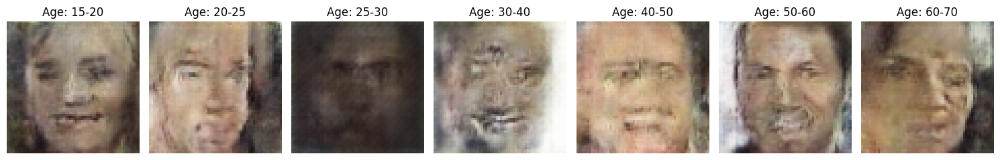

Saved checkpoint for epoch 20 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_20.pth
[Epoch 21/150] [Batch 1/79] [D loss: 0.05803490802645683] [G loss: 5.727081298828125]
[Epoch 21/150] [Batch 2/79] [D loss: 0.017834171652793884] [G loss: 5.870611667633057]
[Epoch 21/150] [Batch 3/79] [D loss: 0.0472165085375309] [G loss: 4.823512077331543]
[Epoch 21/150] [Batch 4/79] [D loss: 0.028331583365797997] [G loss: 5.3075103759765625]
[Epoch 21/150] [Batch 5/79] [D loss: 0.018046032637357712] [G loss: 5.418962478637695]
[Epoch 21/150] [Batch 6/79] [D loss: 0.026315651834011078] [G loss: 4.792913436889648]
[Epoch 21/150] [Batch 7/79] [D loss: 0.0258663110435009] [G loss: 4.8625168800354]
[Epoch 21/150] [Batch 8/79] [D loss: 0.045806679874658585] [G loss: 4.971457004547119]
[Epoch 21/150] [Batch 9/79] [D loss: 0.05351582542061806] [G loss: 4.038137435913086]
[Epoch 21/150] [Batch 10/79] [D loss: 0.08628187328577042] [G loss: 7.014126777648926]
[Epoch 21/150] [Batch

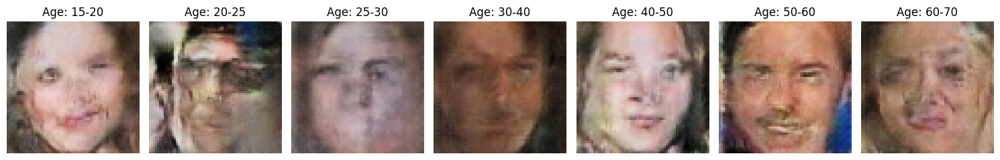

Saved checkpoint for epoch 21 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_21.pth
[Epoch 22/150] [Batch 1/79] [D loss: 0.23461295664310455] [G loss: 4.621880054473877]
[Epoch 22/150] [Batch 2/79] [D loss: 0.146577849984169] [G loss: 4.729925632476807]
[Epoch 22/150] [Batch 3/79] [D loss: 0.2089470624923706] [G loss: 4.347708702087402]
[Epoch 22/150] [Batch 4/79] [D loss: 0.080388642847538] [G loss: 3.539073944091797]
[Epoch 22/150] [Batch 5/79] [D loss: 0.0850108191370964] [G loss: 3.432765007019043]
[Epoch 22/150] [Batch 6/79] [D loss: 0.10938484966754913] [G loss: 4.04304313659668]
[Epoch 22/150] [Batch 7/79] [D loss: 0.10152789205312729] [G loss: 4.351803779602051]
[Epoch 22/150] [Batch 8/79] [D loss: 0.06748177856206894] [G loss: 4.188208103179932]
[Epoch 22/150] [Batch 9/79] [D loss: 0.10401351004838943] [G loss: 3.487600564956665]
[Epoch 22/150] [Batch 10/79] [D loss: 0.11105182766914368] [G loss: 3.437706232070923]
[Epoch 22/150] [Batch 11/79] [

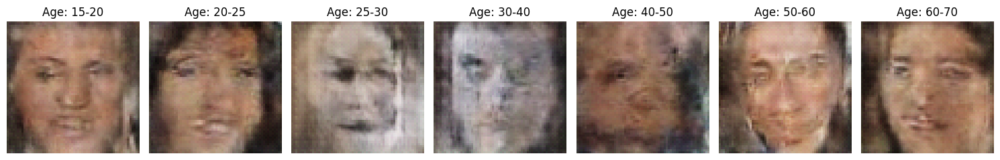

Saved checkpoint for epoch 22 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_22.pth
[Epoch 23/150] [Batch 1/79] [D loss: 0.04675919935107231] [G loss: 5.2240705490112305]
[Epoch 23/150] [Batch 2/79] [D loss: 0.06192823871970177] [G loss: 4.547515869140625]
[Epoch 23/150] [Batch 3/79] [D loss: 0.057944271713495255] [G loss: 6.17960262298584]
[Epoch 23/150] [Batch 4/79] [D loss: 0.01698242500424385] [G loss: 6.443917274475098]
[Epoch 23/150] [Batch 5/79] [D loss: 0.020579444244503975] [G loss: 5.62241792678833]
[Epoch 23/150] [Batch 6/79] [D loss: 0.023366667330265045] [G loss: 5.367913722991943]
[Epoch 23/150] [Batch 7/79] [D loss: 0.052677977830171585] [G loss: 4.117659568786621]
[Epoch 23/150] [Batch 8/79] [D loss: 0.07814893871545792] [G loss: 6.2017107009887695]
[Epoch 23/150] [Batch 9/79] [D loss: 0.06777805089950562] [G loss: 5.54238224029541]
[Epoch 23/150] [Batch 10/79] [D loss: 0.015187917277216911] [G loss: 4.918654918670654]
[Epoch 23/150] [Bat

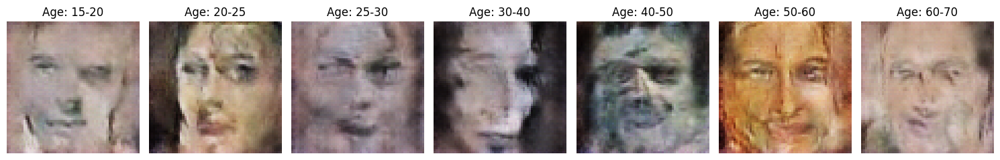

Saved checkpoint for epoch 23 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_23.pth
[Epoch 24/150] [Batch 1/79] [D loss: 0.026488373056054115] [G loss: 4.596538066864014]
[Epoch 24/150] [Batch 2/79] [D loss: 0.034571386873722076] [G loss: 4.511409759521484]
[Epoch 24/150] [Batch 3/79] [D loss: 0.029864786192774773] [G loss: 4.616464614868164]
[Epoch 24/150] [Batch 4/79] [D loss: 0.04029025137424469] [G loss: 4.176460266113281]
[Epoch 24/150] [Batch 5/79] [D loss: 0.05836588516831398] [G loss: 6.073187828063965]
[Epoch 24/150] [Batch 6/79] [D loss: 0.025163479149341583] [G loss: 5.790284156799316]
[Epoch 24/150] [Batch 7/79] [D loss: 0.018818005919456482] [G loss: 5.402798652648926]
[Epoch 24/150] [Batch 8/79] [D loss: 0.039383333176374435] [G loss: 4.520071983337402]
[Epoch 24/150] [Batch 9/79] [D loss: 0.035860490053892136] [G loss: 5.274829864501953]
[Epoch 24/150] [Batch 10/79] [D loss: 0.030793700367212296] [G loss: 6.303763389587402]
[Epoch 24/150] 

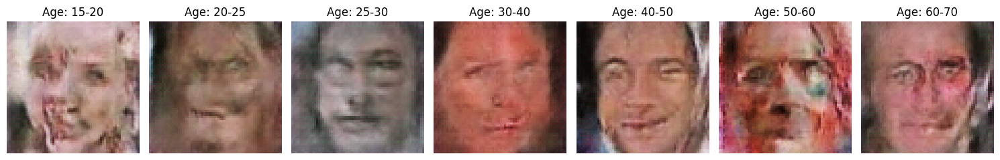

Saved checkpoint for epoch 24 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_24.pth
[Epoch 25/150] [Batch 1/79] [D loss: 0.011288052424788475] [G loss: 7.508465766906738]
[Epoch 25/150] [Batch 2/79] [D loss: 0.01985539309680462] [G loss: 7.133824825286865]
[Epoch 25/150] [Batch 3/79] [D loss: 0.019944459199905396] [G loss: 6.860279083251953]
[Epoch 25/150] [Batch 4/79] [D loss: 0.029329296201467514] [G loss: 6.152785301208496]
[Epoch 25/150] [Batch 5/79] [D loss: 0.03671649843454361] [G loss: 6.059330463409424]
[Epoch 25/150] [Batch 6/79] [D loss: 0.004885923117399216] [G loss: 6.535637855529785]
[Epoch 25/150] [Batch 7/79] [D loss: 0.014066009782254696] [G loss: 5.412903308868408]
[Epoch 25/150] [Batch 8/79] [D loss: 0.024020638316869736] [G loss: 5.543271064758301]
[Epoch 25/150] [Batch 9/79] [D loss: 0.026847658678889275] [G loss: 5.336416721343994]
[Epoch 25/150] [Batch 10/79] [D loss: 0.011786370538175106] [G loss: 5.546726703643799]
[Epoch 25/150] 

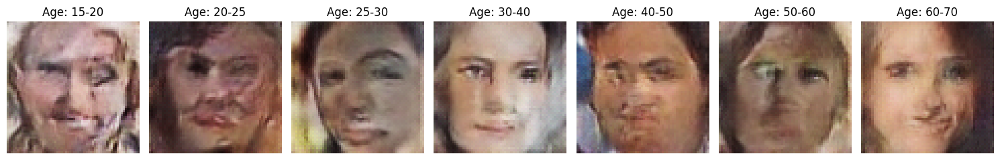

Saved checkpoint for epoch 25 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_25.pth
[Epoch 26/150] [Batch 1/79] [D loss: 0.02159147709608078] [G loss: 5.9202165603637695]
[Epoch 26/150] [Batch 2/79] [D loss: 0.030282413586974144] [G loss: 5.377572059631348]
[Epoch 26/150] [Batch 3/79] [D loss: 0.01191723719239235] [G loss: 5.345396995544434]
[Epoch 26/150] [Batch 4/79] [D loss: 0.04463787376880646] [G loss: 5.362645149230957]
[Epoch 26/150] [Batch 5/79] [D loss: 0.027784638106822968] [G loss: 5.655125141143799]
[Epoch 26/150] [Batch 6/79] [D loss: 0.017266832292079926] [G loss: 5.709670066833496]
[Epoch 26/150] [Batch 7/79] [D loss: 0.022573504596948624] [G loss: 5.722316741943359]
[Epoch 26/150] [Batch 8/79] [D loss: 0.06678265333175659] [G loss: 8.266490936279297]
[Epoch 26/150] [Batch 9/79] [D loss: 0.2245679348707199] [G loss: 3.96878719329834]
[Epoch 26/150] [Batch 10/79] [D loss: 0.006962536368519068] [G loss: 3.7519006729125977]
[Epoch 26/150] [Ba

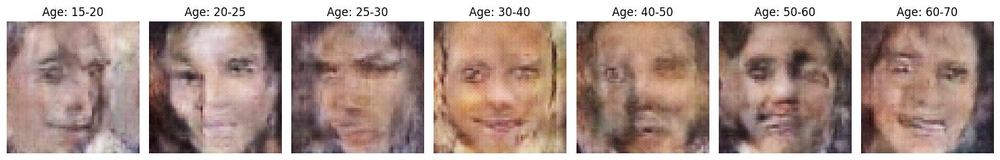

Saved checkpoint for epoch 26 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_26.pth
[Epoch 27/150] [Batch 1/79] [D loss: 0.015872692689299583] [G loss: 5.517667770385742]
[Epoch 27/150] [Batch 2/79] [D loss: 0.01651928760111332] [G loss: 5.3391923904418945]
[Epoch 27/150] [Batch 3/79] [D loss: 0.05098148435354233] [G loss: 4.244137763977051]
[Epoch 27/150] [Batch 4/79] [D loss: 0.04069614037871361] [G loss: 5.6458539962768555]
[Epoch 27/150] [Batch 5/79] [D loss: 0.03691419959068298] [G loss: 5.0347185134887695]
[Epoch 27/150] [Batch 6/79] [D loss: 0.019656112417578697] [G loss: 4.622722625732422]
[Epoch 27/150] [Batch 7/79] [D loss: 0.03610425442457199] [G loss: 5.470635414123535]
[Epoch 27/150] [Batch 8/79] [D loss: 0.033942632377147675] [G loss: 4.926420211791992]
[Epoch 27/150] [Batch 9/79] [D loss: 0.016045425087213516] [G loss: 5.041128635406494]
[Epoch 27/150] [Batch 10/79] [D loss: 0.031032610684633255] [G loss: 5.012253284454346]
[Epoch 27/150] 

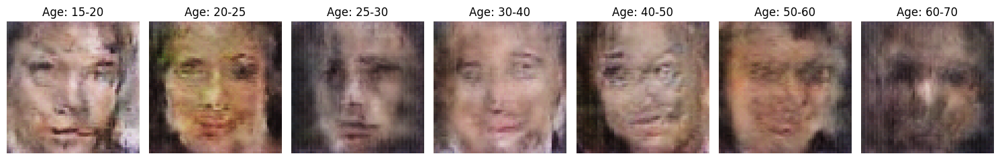

Saved checkpoint for epoch 27 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_27.pth
[Epoch 28/150] [Batch 1/79] [D loss: 0.10766617208719254] [G loss: 5.503629684448242]
[Epoch 28/150] [Batch 2/79] [D loss: 0.025421448051929474] [G loss: 4.477652549743652]
[Epoch 28/150] [Batch 3/79] [D loss: 0.03668761998414993] [G loss: 4.64415979385376]
[Epoch 28/150] [Batch 4/79] [D loss: 0.031565070152282715] [G loss: 4.713547229766846]
[Epoch 28/150] [Batch 5/79] [D loss: 0.03447859361767769] [G loss: 4.510335922241211]
[Epoch 28/150] [Batch 6/79] [D loss: 0.03815513849258423] [G loss: 4.404223918914795]
[Epoch 28/150] [Batch 7/79] [D loss: 0.036924075335264206] [G loss: 4.807924270629883]
[Epoch 28/150] [Batch 8/79] [D loss: 0.040279243141412735] [G loss: 4.620606422424316]
[Epoch 28/150] [Batch 9/79] [D loss: 0.03359076380729675] [G loss: 4.5283308029174805]
[Epoch 28/150] [Batch 10/79] [D loss: 0.05610032379627228] [G loss: 3.9525375366210938]
[Epoch 28/150] [Ba

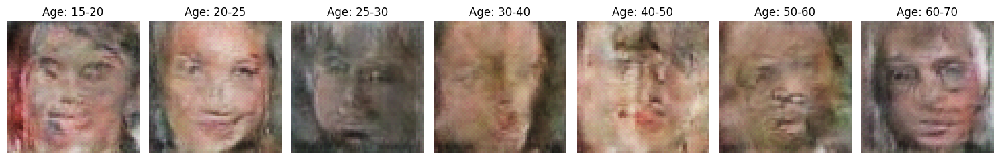

Saved checkpoint for epoch 28 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_28.pth
[Epoch 29/150] [Batch 1/79] [D loss: 0.02537832036614418] [G loss: 4.621285915374756]
[Epoch 29/150] [Batch 2/79] [D loss: 0.02447851002216339] [G loss: 4.458134651184082]
[Epoch 29/150] [Batch 3/79] [D loss: 0.020118605345487595] [G loss: 4.621842384338379]
[Epoch 29/150] [Batch 4/79] [D loss: 0.04005122929811478] [G loss: 5.26392126083374]
[Epoch 29/150] [Batch 5/79] [D loss: 0.02294607274234295] [G loss: 5.124302864074707]
[Epoch 29/150] [Batch 6/79] [D loss: 0.042787957936525345] [G loss: 3.686735153198242]
[Epoch 29/150] [Batch 7/79] [D loss: 0.0357055701315403] [G loss: 5.257902145385742]
[Epoch 29/150] [Batch 8/79] [D loss: 0.03737441450357437] [G loss: 5.9000244140625]
[Epoch 29/150] [Batch 9/79] [D loss: 0.04056953638792038] [G loss: 5.0171427726745605]
[Epoch 29/150] [Batch 10/79] [D loss: 0.02954789064824581] [G loss: 4.639644622802734]
[Epoch 29/150] [Batch 11

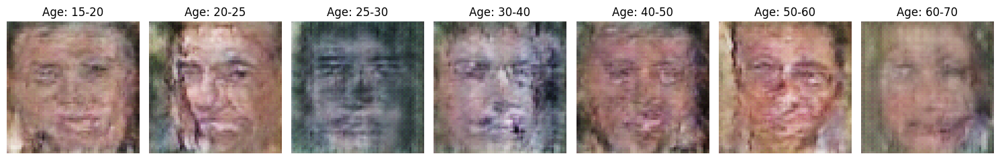

Saved checkpoint for epoch 29 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_29.pth
[Epoch 30/150] [Batch 1/79] [D loss: 0.11292365193367004] [G loss: 4.923181533813477]
[Epoch 30/150] [Batch 2/79] [D loss: 0.08162036538124084] [G loss: 3.8646326065063477]
[Epoch 30/150] [Batch 3/79] [D loss: 0.19810132682323456] [G loss: 6.481072425842285]
[Epoch 30/150] [Batch 4/79] [D loss: 0.26455938816070557] [G loss: 4.878138542175293]
[Epoch 30/150] [Batch 5/79] [D loss: 0.05510951578617096] [G loss: 4.444607734680176]
[Epoch 30/150] [Batch 6/79] [D loss: 0.10223936289548874] [G loss: 4.909658432006836]
[Epoch 30/150] [Batch 7/79] [D loss: 0.07114150375127792] [G loss: 4.527199745178223]
[Epoch 30/150] [Batch 8/79] [D loss: 0.047467879951000214] [G loss: 4.368182182312012]
[Epoch 30/150] [Batch 9/79] [D loss: 0.0690227597951889] [G loss: 5.424623489379883]
[Epoch 30/150] [Batch 10/79] [D loss: 0.08300779014825821] [G loss: 4.266106605529785]
[Epoch 30/150] [Batch 

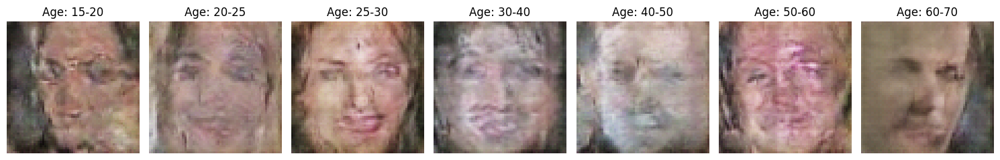

Saved checkpoint for epoch 30 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_30.pth
[Epoch 31/150] [Batch 1/79] [D loss: 0.03186415508389473] [G loss: 4.394486427307129]
[Epoch 31/150] [Batch 2/79] [D loss: 0.03664872422814369] [G loss: 4.1662797927856445]
[Epoch 31/150] [Batch 3/79] [D loss: 0.0388842448592186] [G loss: 4.425922393798828]
[Epoch 31/150] [Batch 4/79] [D loss: 0.08001016825437546] [G loss: 4.3297576904296875]
[Epoch 31/150] [Batch 5/79] [D loss: 0.055550314486026764] [G loss: 4.280308723449707]
[Epoch 31/150] [Batch 6/79] [D loss: 0.10190826654434204] [G loss: 5.954577445983887]
[Epoch 31/150] [Batch 7/79] [D loss: 0.18163125216960907] [G loss: 3.732558250427246]
[Epoch 31/150] [Batch 8/79] [D loss: 0.12943848967552185] [G loss: 6.692445755004883]
[Epoch 31/150] [Batch 9/79] [D loss: 0.011926883831620216] [G loss: 6.788651466369629]
[Epoch 31/150] [Batch 10/79] [D loss: 0.01564957946538925] [G loss: 6.457422733306885]
[Epoch 31/150] [Batc

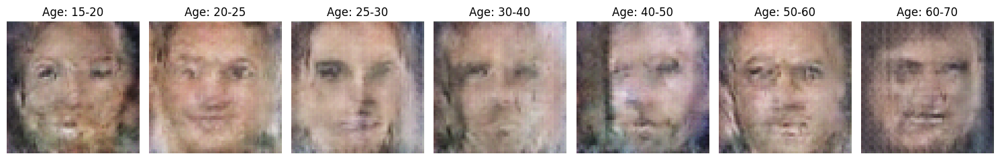

Saved checkpoint for epoch 31 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_31.pth
[Epoch 32/150] [Batch 1/79] [D loss: 0.08762232214212418] [G loss: 5.7932963371276855]
[Epoch 32/150] [Batch 2/79] [D loss: 0.0949973538517952] [G loss: 4.331429481506348]
[Epoch 32/150] [Batch 3/79] [D loss: 0.11244209110736847] [G loss: 5.097348213195801]
[Epoch 32/150] [Batch 4/79] [D loss: 0.10097306966781616] [G loss: 4.6551666259765625]
[Epoch 32/150] [Batch 5/79] [D loss: 0.05341756343841553] [G loss: 4.541304111480713]
[Epoch 32/150] [Batch 6/79] [D loss: 0.0622905008494854] [G loss: 5.421600341796875]
[Epoch 32/150] [Batch 7/79] [D loss: 0.1357879489660263] [G loss: 3.420081853866577]
[Epoch 32/150] [Batch 8/79] [D loss: 0.11001917719841003] [G loss: 6.028471946716309]
[Epoch 32/150] [Batch 9/79] [D loss: 0.06934188306331635] [G loss: 5.138507843017578]
[Epoch 32/150] [Batch 10/79] [D loss: 0.031147323548793793] [G loss: 4.63432502746582]
[Epoch 32/150] [Batch 11

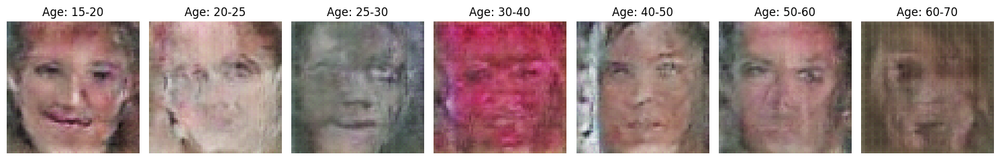

Saved checkpoint for epoch 32 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_32.pth
[Epoch 33/150] [Batch 1/79] [D loss: 0.02397623285651207] [G loss: 5.417254447937012]
[Epoch 33/150] [Batch 2/79] [D loss: 0.02684556134045124] [G loss: 5.768957138061523]
[Epoch 33/150] [Batch 3/79] [D loss: 0.023138433694839478] [G loss: 5.316432476043701]
[Epoch 33/150] [Batch 4/79] [D loss: 0.030798140913248062] [G loss: 4.830837249755859]
[Epoch 33/150] [Batch 5/79] [D loss: 0.07017272710800171] [G loss: 3.9229321479797363]
[Epoch 33/150] [Batch 6/79] [D loss: 0.07442571222782135] [G loss: 5.896921157836914]
[Epoch 33/150] [Batch 7/79] [D loss: 0.05217975005507469] [G loss: 5.5656938552856445]
[Epoch 33/150] [Batch 8/79] [D loss: 0.023445937782526016] [G loss: 4.656847953796387]
[Epoch 33/150] [Batch 9/79] [D loss: 0.04973781481385231] [G loss: 5.848406791687012]
[Epoch 33/150] [Batch 10/79] [D loss: 0.052990809082984924] [G loss: 4.889639854431152]
[Epoch 33/150] [B

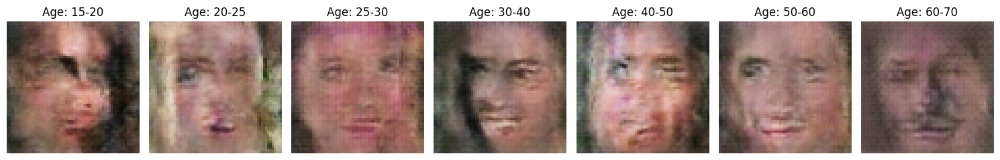

Saved checkpoint for epoch 33 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_33.pth
[Epoch 34/150] [Batch 1/79] [D loss: 0.060653574764728546] [G loss: 4.397403717041016]
[Epoch 34/150] [Batch 2/79] [D loss: 0.03456123173236847] [G loss: 4.5472259521484375]
[Epoch 34/150] [Batch 3/79] [D loss: 0.05472160130739212] [G loss: 4.866786003112793]
[Epoch 34/150] [Batch 4/79] [D loss: 0.02749691717326641] [G loss: 5.078097820281982]
[Epoch 34/150] [Batch 5/79] [D loss: 0.04556936025619507] [G loss: 4.179208755493164]
[Epoch 34/150] [Batch 6/79] [D loss: 0.06987497210502625] [G loss: 4.2178778648376465]
[Epoch 34/150] [Batch 7/79] [D loss: 0.07125633955001831] [G loss: 4.835765838623047]
[Epoch 34/150] [Batch 8/79] [D loss: 0.04399926960468292] [G loss: 4.441686630249023]
[Epoch 34/150] [Batch 9/79] [D loss: 0.07381200790405273] [G loss: 4.760861396789551]
[Epoch 34/150] [Batch 10/79] [D loss: 0.0635870099067688] [G loss: 4.182458877563477]
[Epoch 34/150] [Batch

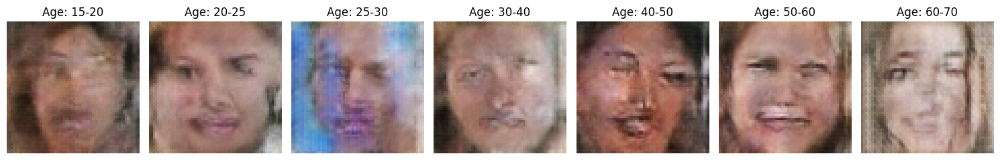

Saved checkpoint for epoch 34 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_34.pth
[Epoch 35/150] [Batch 1/79] [D loss: 0.017700793221592903] [G loss: 5.544738292694092]
[Epoch 35/150] [Batch 2/79] [D loss: 0.08228382468223572] [G loss: 3.5186502933502197]
[Epoch 35/150] [Batch 3/79] [D loss: 0.20971018075942993] [G loss: 9.010369300842285]
[Epoch 35/150] [Batch 4/79] [D loss: 1.180800437927246] [G loss: 7.403806209564209]
[Epoch 35/150] [Batch 5/79] [D loss: 0.12132725864648819] [G loss: 5.611800193786621]
[Epoch 35/150] [Batch 6/79] [D loss: 0.07867427915334702] [G loss: 4.834532737731934]
[Epoch 35/150] [Batch 7/79] [D loss: 0.04096928611397743] [G loss: 5.231703758239746]
[Epoch 35/150] [Batch 8/79] [D loss: 0.03314162790775299] [G loss: 5.160359859466553]
[Epoch 35/150] [Batch 9/79] [D loss: 0.010397554375231266] [G loss: 5.4738616943359375]
[Epoch 35/150] [Batch 10/79] [D loss: 0.011425773613154888] [G loss: 4.971220016479492]
[Epoch 35/150] [Batc

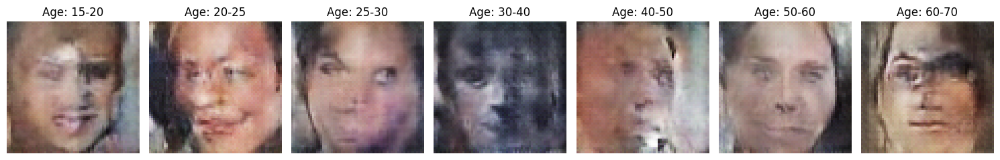

Saved checkpoint for epoch 35 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_35.pth
[Epoch 36/150] [Batch 1/79] [D loss: 0.2668161690235138] [G loss: 2.3821725845336914]
[Epoch 36/150] [Batch 2/79] [D loss: 0.20187121629714966] [G loss: 2.8785972595214844]
[Epoch 36/150] [Batch 3/79] [D loss: 0.14064882695674896] [G loss: 2.943263530731201]
[Epoch 36/150] [Batch 4/79] [D loss: 0.1265646368265152] [G loss: 2.858781576156616]
[Epoch 36/150] [Batch 5/79] [D loss: 0.10985095053911209] [G loss: 2.9601149559020996]
[Epoch 36/150] [Batch 6/79] [D loss: 0.1500307023525238] [G loss: 2.526352882385254]
[Epoch 36/150] [Batch 7/79] [D loss: 0.1410604864358902] [G loss: 3.077554225921631]
[Epoch 36/150] [Batch 8/79] [D loss: 0.1133405864238739] [G loss: 2.7726449966430664]
[Epoch 36/150] [Batch 9/79] [D loss: 0.12307940423488617] [G loss: 2.8999364376068115]
[Epoch 36/150] [Batch 10/79] [D loss: 0.11847949028015137] [G loss: 3.011502981185913]
[Epoch 36/150] [Batch 1

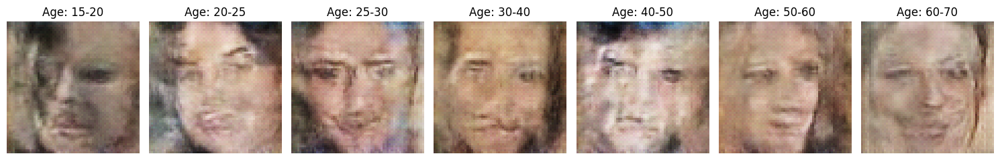

Saved checkpoint for epoch 36 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_36.pth
[Epoch 37/150] [Batch 1/79] [D loss: 0.04484732449054718] [G loss: 4.504793167114258]
[Epoch 37/150] [Batch 2/79] [D loss: 0.061030611395835876] [G loss: 5.2924699783325195]
[Epoch 37/150] [Batch 3/79] [D loss: 0.050563596189022064] [G loss: 4.884930610656738]
[Epoch 37/150] [Batch 4/79] [D loss: 0.05696495994925499] [G loss: 3.9937334060668945]
[Epoch 37/150] [Batch 5/79] [D loss: 0.11610421538352966] [G loss: 6.259378433227539]
[Epoch 37/150] [Batch 6/79] [D loss: 0.16434071958065033] [G loss: 4.269651412963867]
[Epoch 37/150] [Batch 7/79] [D loss: 0.15051203966140747] [G loss: 7.368470191955566]
[Epoch 37/150] [Batch 8/79] [D loss: 0.1786631941795349] [G loss: 6.48642635345459]
[Epoch 37/150] [Batch 9/79] [D loss: 0.01036940235644579] [G loss: 5.449702739715576]
[Epoch 37/150] [Batch 10/79] [D loss: 0.04268546774983406] [G loss: 5.400284767150879]
[Epoch 37/150] [Batch

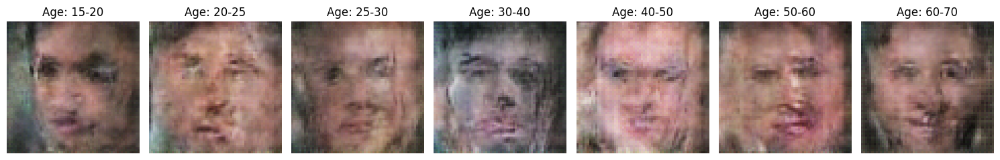

Saved checkpoint for epoch 37 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_37.pth
[Epoch 38/150] [Batch 1/79] [D loss: 0.057962991297245026] [G loss: 3.6329755783081055]
[Epoch 38/150] [Batch 2/79] [D loss: 0.05768454819917679] [G loss: 3.6481122970581055]
[Epoch 38/150] [Batch 3/79] [D loss: 0.08223073929548264] [G loss: 3.4711079597473145]
[Epoch 38/150] [Batch 4/79] [D loss: 0.11889117956161499] [G loss: 3.136115312576294]
[Epoch 38/150] [Batch 5/79] [D loss: 0.06803663820028305] [G loss: 3.5122106075286865]
[Epoch 38/150] [Batch 6/79] [D loss: 0.0915384516119957] [G loss: 3.556849718093872]
[Epoch 38/150] [Batch 7/79] [D loss: 0.07972218096256256] [G loss: 3.7644922733306885]
[Epoch 38/150] [Batch 8/79] [D loss: 0.03650611266493797] [G loss: 4.208670139312744]
[Epoch 38/150] [Batch 9/79] [D loss: 0.05463119596242905] [G loss: 3.8816189765930176]
[Epoch 38/150] [Batch 10/79] [D loss: 0.049710363149642944] [G loss: 3.884463310241699]
[Epoch 38/150] [

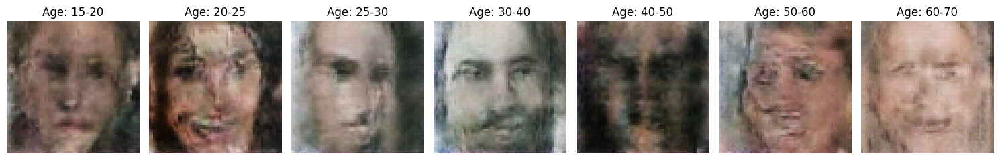

Saved checkpoint for epoch 38 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_38.pth
[Epoch 39/150] [Batch 1/79] [D loss: 0.2761809229850769] [G loss: 2.2905914783477783]
[Epoch 39/150] [Batch 2/79] [D loss: 0.23488882184028625] [G loss: 2.3737645149230957]
[Epoch 39/150] [Batch 3/79] [D loss: 0.21765629947185516] [G loss: 2.7742159366607666]
[Epoch 39/150] [Batch 4/79] [D loss: 0.22941789031028748] [G loss: 2.7664477825164795]
[Epoch 39/150] [Batch 5/79] [D loss: 0.24964144825935364] [G loss: 2.8807363510131836]
[Epoch 39/150] [Batch 6/79] [D loss: 0.3257949948310852] [G loss: 2.6684622764587402]
[Epoch 39/150] [Batch 7/79] [D loss: 0.26546138525009155] [G loss: 2.7725577354431152]
[Epoch 39/150] [Batch 8/79] [D loss: 0.3125389516353607] [G loss: 2.779506206512451]
[Epoch 39/150] [Batch 9/79] [D loss: 0.3055647611618042] [G loss: 3.1258933544158936]
[Epoch 39/150] [Batch 10/79] [D loss: 0.4326164722442627] [G loss: 3.619614601135254]
[Epoch 39/150] [Batc

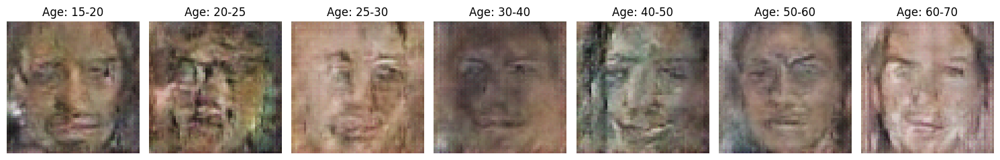

Saved checkpoint for epoch 39 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_39.pth
[Epoch 40/150] [Batch 1/79] [D loss: 0.0639776885509491] [G loss: 4.558496952056885]
[Epoch 40/150] [Batch 2/79] [D loss: 0.04789232835173607] [G loss: 4.7896013259887695]
[Epoch 40/150] [Batch 3/79] [D loss: 0.10466945916414261] [G loss: 4.291522979736328]
[Epoch 40/150] [Batch 4/79] [D loss: 0.1166212409734726] [G loss: 5.817538261413574]
[Epoch 40/150] [Batch 5/79] [D loss: 0.055319733917713165] [G loss: 5.373121738433838]
[Epoch 40/150] [Batch 6/79] [D loss: 0.07885004580020905] [G loss: 3.7599949836730957]
[Epoch 40/150] [Batch 7/79] [D loss: 0.14878442883491516] [G loss: 5.7745208740234375]
[Epoch 40/150] [Batch 8/79] [D loss: 0.0906999483704567] [G loss: 5.489288330078125]
[Epoch 40/150] [Batch 9/79] [D loss: 0.13062360882759094] [G loss: 4.755075454711914]
[Epoch 40/150] [Batch 10/79] [D loss: 0.15433529019355774] [G loss: 6.969017505645752]
[Epoch 40/150] [Batch 

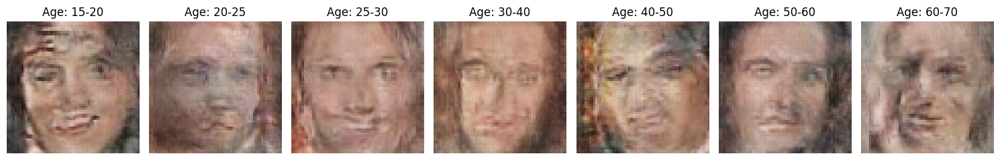

Saved checkpoint for epoch 40 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_40.pth
[Epoch 41/150] [Batch 1/79] [D loss: 0.06396660208702087] [G loss: 4.496265411376953]
[Epoch 41/150] [Batch 2/79] [D loss: 0.0720219537615776] [G loss: 5.240610122680664]
[Epoch 41/150] [Batch 3/79] [D loss: 0.058609433472156525] [G loss: 4.735433101654053]
[Epoch 41/150] [Batch 4/79] [D loss: 0.09006071090698242] [G loss: 3.7947499752044678]
[Epoch 41/150] [Batch 5/79] [D loss: 0.14354462921619415] [G loss: 6.999504566192627]
[Epoch 41/150] [Batch 6/79] [D loss: 0.3331984579563141] [G loss: 3.574963092803955]
[Epoch 41/150] [Batch 7/79] [D loss: 0.23675945401191711] [G loss: 7.47963285446167]
[Epoch 41/150] [Batch 8/79] [D loss: 0.09829413145780563] [G loss: 7.24571418762207]
[Epoch 41/150] [Batch 9/79] [D loss: 0.0331159308552742] [G loss: 6.480456352233887]
[Epoch 41/150] [Batch 10/79] [D loss: 0.03750135749578476] [G loss: 6.112710475921631]
[Epoch 41/150] [Batch 11/7

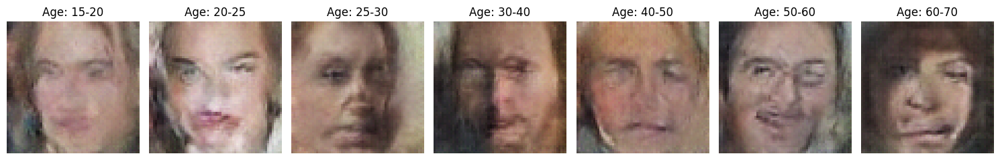

Saved checkpoint for epoch 41 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_41.pth
[Epoch 42/150] [Batch 1/79] [D loss: 1.0832619667053223] [G loss: 9.887870788574219]
[Epoch 42/150] [Batch 2/79] [D loss: 2.6190989017486572] [G loss: 7.742270469665527]
[Epoch 42/150] [Batch 3/79] [D loss: 1.780773401260376] [G loss: 5.5118408203125]
[Epoch 42/150] [Batch 4/79] [D loss: 0.7191916108131409] [G loss: 2.9614784717559814]
[Epoch 42/150] [Batch 5/79] [D loss: 0.3238699436187744] [G loss: 1.8757152557373047]
[Epoch 42/150] [Batch 6/79] [D loss: 0.28054672479629517] [G loss: 2.427297830581665]
[Epoch 42/150] [Batch 7/79] [D loss: 0.1429995596408844] [G loss: 3.130951404571533]
[Epoch 42/150] [Batch 8/79] [D loss: 0.17787253856658936] [G loss: 2.9530415534973145]
[Epoch 42/150] [Batch 9/79] [D loss: 0.12860359251499176] [G loss: 2.786530017852783]
[Epoch 42/150] [Batch 10/79] [D loss: 0.10381901264190674] [G loss: 2.9186768531799316]
[Epoch 42/150] [Batch 11/79]

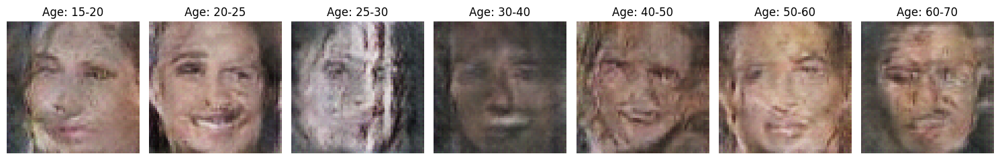

Saved checkpoint for epoch 42 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_42.pth
[Epoch 43/150] [Batch 1/79] [D loss: 0.034351080656051636] [G loss: 3.955470561981201]
[Epoch 43/150] [Batch 2/79] [D loss: 0.08318036794662476] [G loss: 5.06146764755249]
[Epoch 43/150] [Batch 3/79] [D loss: 0.04728921502828598] [G loss: 5.091062545776367]
[Epoch 43/150] [Batch 4/79] [D loss: 0.06425013393163681] [G loss: 4.2350077629089355]
[Epoch 43/150] [Batch 5/79] [D loss: 0.07232525199651718] [G loss: 4.503052234649658]
[Epoch 43/150] [Batch 6/79] [D loss: 0.06574925780296326] [G loss: 4.1388258934021]
[Epoch 43/150] [Batch 7/79] [D loss: 0.042398832738399506] [G loss: 4.370560646057129]
[Epoch 43/150] [Batch 8/79] [D loss: 0.049574144184589386] [G loss: 4.355429649353027]
[Epoch 43/150] [Batch 9/79] [D loss: 0.0975400060415268] [G loss: 4.036769390106201]
[Epoch 43/150] [Batch 10/79] [D loss: 0.07150176912546158] [G loss: 4.491991996765137]
[Epoch 43/150] [Batch 1

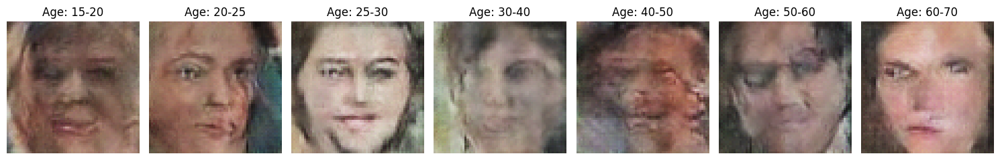

Saved checkpoint for epoch 43 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_43.pth
[Epoch 44/150] [Batch 1/79] [D loss: 1.6879866123199463] [G loss: 4.837352275848389]
[Epoch 44/150] [Batch 2/79] [D loss: 0.8999871611595154] [G loss: 3.4384396076202393]
[Epoch 44/150] [Batch 3/79] [D loss: 0.4926474392414093] [G loss: 2.877145767211914]
[Epoch 44/150] [Batch 4/79] [D loss: 0.22995245456695557] [G loss: 2.7822723388671875]
[Epoch 44/150] [Batch 5/79] [D loss: 0.23213019967079163] [G loss: 2.6400158405303955]
[Epoch 44/150] [Batch 6/79] [D loss: 0.18834006786346436] [G loss: 2.6910948753356934]
[Epoch 44/150] [Batch 7/79] [D loss: 0.13042037189006805] [G loss: 2.9626851081848145]
[Epoch 44/150] [Batch 8/79] [D loss: 0.10844610631465912] [G loss: 3.061417579650879]
[Epoch 44/150] [Batch 9/79] [D loss: 0.09661191701889038] [G loss: 2.9277470111846924]
[Epoch 44/150] [Batch 10/79] [D loss: 0.1122283861041069] [G loss: 3.02207612991333]
[Epoch 44/150] [Batch 

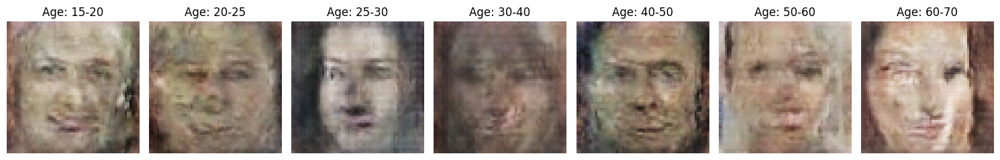

Saved checkpoint for epoch 44 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_44.pth
[Epoch 45/150] [Batch 1/79] [D loss: 0.09080866724252701] [G loss: 3.4572134017944336]
[Epoch 45/150] [Batch 2/79] [D loss: 0.11128368973731995] [G loss: 3.99592924118042]
[Epoch 45/150] [Batch 3/79] [D loss: 0.09847795963287354] [G loss: 3.6305980682373047]
[Epoch 45/150] [Batch 4/79] [D loss: 0.10493883490562439] [G loss: 4.01838493347168]
[Epoch 45/150] [Batch 5/79] [D loss: 0.0945599302649498] [G loss: 3.6987485885620117]
[Epoch 45/150] [Batch 6/79] [D loss: 0.11680467426776886] [G loss: 3.6686277389526367]
[Epoch 45/150] [Batch 7/79] [D loss: 0.10643202811479568] [G loss: 5.073479175567627]
[Epoch 45/150] [Batch 8/79] [D loss: 0.0986725240945816] [G loss: 4.536351203918457]
[Epoch 45/150] [Batch 9/79] [D loss: 0.1084546223282814] [G loss: 3.1429195404052734]
[Epoch 45/150] [Batch 10/79] [D loss: 0.09714889526367188] [G loss: 4.900233268737793]
[Epoch 45/150] [Batch 1

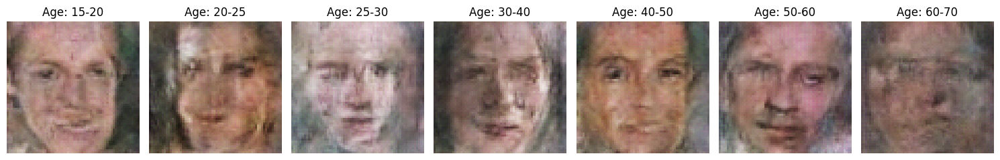

Saved checkpoint for epoch 45 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_45.pth
[Epoch 46/150] [Batch 1/79] [D loss: 0.11514444649219513] [G loss: 4.002373218536377]
[Epoch 46/150] [Batch 2/79] [D loss: 0.08100399374961853] [G loss: 3.971932888031006]
[Epoch 46/150] [Batch 3/79] [D loss: 0.1385059356689453] [G loss: 4.165143966674805]
[Epoch 46/150] [Batch 4/79] [D loss: 0.13245263695716858] [G loss: 3.5442161560058594]
[Epoch 46/150] [Batch 5/79] [D loss: 0.14170023798942566] [G loss: 3.7210099697113037]
[Epoch 46/150] [Batch 6/79] [D loss: 0.1554659754037857] [G loss: 5.3248772621154785]
[Epoch 46/150] [Batch 7/79] [D loss: 0.1969345659017563] [G loss: 4.144560813903809]
[Epoch 46/150] [Batch 8/79] [D loss: 0.14939188957214355] [G loss: 4.714184761047363]
[Epoch 46/150] [Batch 9/79] [D loss: 0.08731114119291306] [G loss: 4.62248420715332]
[Epoch 46/150] [Batch 10/79] [D loss: 0.07042421400547028] [G loss: 3.927123546600342]
[Epoch 46/150] [Batch 11

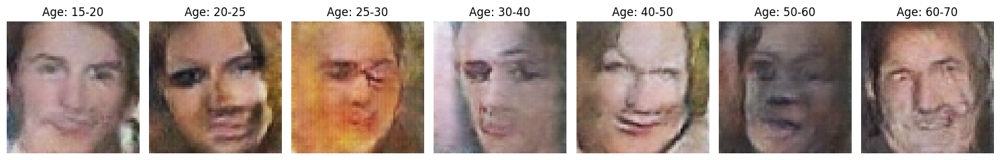

Saved checkpoint for epoch 46 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_46.pth
[Epoch 47/150] [Batch 1/79] [D loss: 0.19412700831890106] [G loss: 9.352561950683594]
[Epoch 47/150] [Batch 2/79] [D loss: 1.3224016427993774] [G loss: 7.069486618041992]
[Epoch 47/150] [Batch 3/79] [D loss: 0.470727801322937] [G loss: 0.06508902460336685]
[Epoch 47/150] [Batch 4/79] [D loss: 3.170584201812744] [G loss: 10.33180046081543]
[Epoch 47/150] [Batch 5/79] [D loss: 1.8888827562332153] [G loss: 9.782608985900879]
[Epoch 47/150] [Batch 6/79] [D loss: 1.3784438371658325] [G loss: 8.00349235534668]
[Epoch 47/150] [Batch 7/79] [D loss: 0.4292367398738861] [G loss: 5.762328624725342]
[Epoch 47/150] [Batch 8/79] [D loss: 0.08237883448600769] [G loss: 4.370882987976074]
[Epoch 47/150] [Batch 9/79] [D loss: 0.1090526431798935] [G loss: 3.54081392288208]
[Epoch 47/150] [Batch 10/79] [D loss: 0.16186214983463287] [G loss: 3.563410758972168]
[Epoch 47/150] [Batch 11/79] [D 

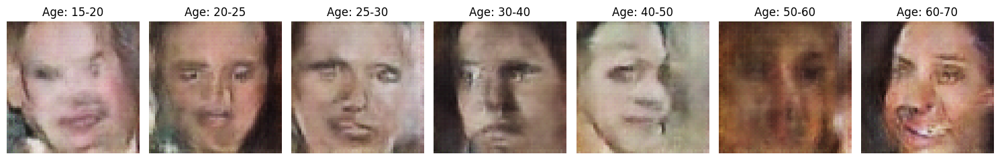

Saved checkpoint for epoch 47 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_47.pth
[Epoch 48/150] [Batch 1/79] [D loss: 0.0566069595515728] [G loss: 5.756848335266113]
[Epoch 48/150] [Batch 2/79] [D loss: 0.03829364478588104] [G loss: 6.144138336181641]
[Epoch 48/150] [Batch 3/79] [D loss: 0.05496775731444359] [G loss: 5.537477493286133]
[Epoch 48/150] [Batch 4/79] [D loss: 0.02905631810426712] [G loss: 5.213229179382324]
[Epoch 48/150] [Batch 5/79] [D loss: 0.03503159433603287] [G loss: 5.409121513366699]
[Epoch 48/150] [Batch 6/79] [D loss: 0.052821915596723557] [G loss: 5.107104301452637]
[Epoch 48/150] [Batch 7/79] [D loss: 0.026120997965335846] [G loss: 5.386009216308594]
[Epoch 48/150] [Batch 8/79] [D loss: 0.03668299317359924] [G loss: 4.541966438293457]
[Epoch 48/150] [Batch 9/79] [D loss: 0.05221973732113838] [G loss: 5.795450210571289]
[Epoch 48/150] [Batch 10/79] [D loss: 0.10598130524158478] [G loss: 3.656400680541992]
[Epoch 48/150] [Batch 

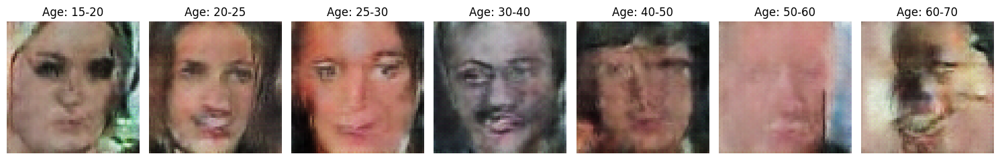

Saved checkpoint for epoch 48 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_48.pth
[Epoch 49/150] [Batch 1/79] [D loss: 0.31956803798675537] [G loss: 2.3990156650543213]
[Epoch 49/150] [Batch 2/79] [D loss: 0.2705118656158447] [G loss: 2.4109742641448975]
[Epoch 49/150] [Batch 3/79] [D loss: 0.18910187482833862] [G loss: 2.8095688819885254]
[Epoch 49/150] [Batch 4/79] [D loss: 0.12252997606992722] [G loss: 3.177496910095215]
[Epoch 49/150] [Batch 5/79] [D loss: 0.10609813034534454] [G loss: 3.019190549850464]
[Epoch 49/150] [Batch 6/79] [D loss: 0.12024976313114166] [G loss: 3.1289823055267334]
[Epoch 49/150] [Batch 7/79] [D loss: 0.09374317526817322] [G loss: 3.1325268745422363]
[Epoch 49/150] [Batch 8/79] [D loss: 0.08306179940700531] [G loss: 2.8721566200256348]
[Epoch 49/150] [Batch 9/79] [D loss: 0.10866427421569824] [G loss: 2.8574352264404297]
[Epoch 49/150] [Batch 10/79] [D loss: 0.06641654670238495] [G loss: 3.2059202194213867]
[Epoch 49/150] [

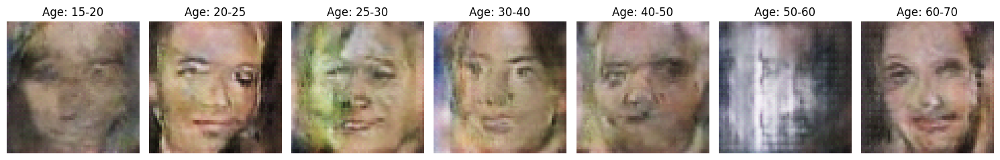

Saved checkpoint for epoch 49 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_49.pth
[Epoch 50/150] [Batch 1/79] [D loss: 0.0345328114926815] [G loss: 4.3493804931640625]
[Epoch 50/150] [Batch 2/79] [D loss: 0.05554164946079254] [G loss: 4.43936824798584]
[Epoch 50/150] [Batch 3/79] [D loss: 0.04663192108273506] [G loss: 4.186866283416748]
[Epoch 50/150] [Batch 4/79] [D loss: 0.02791992388665676] [G loss: 4.429205894470215]
[Epoch 50/150] [Batch 5/79] [D loss: 0.033593542873859406] [G loss: 4.218491077423096]
[Epoch 50/150] [Batch 6/79] [D loss: 0.05968063697218895] [G loss: 4.687132835388184]
[Epoch 50/150] [Batch 7/79] [D loss: 0.07399097830057144] [G loss: 3.7748656272888184]
[Epoch 50/150] [Batch 8/79] [D loss: 0.07190574705600739] [G loss: 4.965581893920898]
[Epoch 50/150] [Batch 9/79] [D loss: 0.028137236833572388] [G loss: 5.30258846282959]
[Epoch 50/150] [Batch 10/79] [D loss: 0.033840954303741455] [G loss: 4.287675857543945]
[Epoch 50/150] [Batch

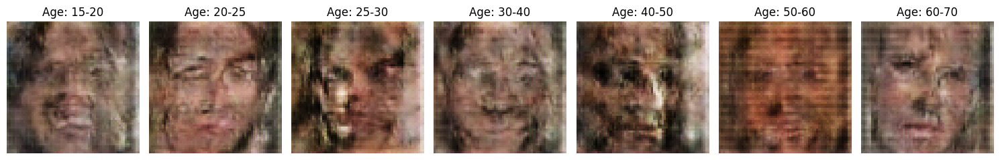

Saved checkpoint for epoch 50 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_50.pth
[Epoch 51/150] [Batch 1/79] [D loss: 0.09516848623752594] [G loss: 3.730405569076538]
[Epoch 51/150] [Batch 2/79] [D loss: 0.0798836499452591] [G loss: 3.7119498252868652]
[Epoch 51/150] [Batch 3/79] [D loss: 0.06477467715740204] [G loss: 3.776355743408203]
[Epoch 51/150] [Batch 4/79] [D loss: 0.1087602823972702] [G loss: 4.119664192199707]
[Epoch 51/150] [Batch 5/79] [D loss: 0.0758756622672081] [G loss: 4.10637092590332]
[Epoch 51/150] [Batch 6/79] [D loss: 0.10653450340032578] [G loss: 3.6351070404052734]
[Epoch 51/150] [Batch 7/79] [D loss: 0.10135190188884735] [G loss: 4.429314136505127]
[Epoch 51/150] [Batch 8/79] [D loss: 0.07547681033611298] [G loss: 4.202260494232178]
[Epoch 51/150] [Batch 9/79] [D loss: 0.08542417734861374] [G loss: 3.733661413192749]
[Epoch 51/150] [Batch 10/79] [D loss: 0.13241811096668243] [G loss: 4.134923934936523]
[Epoch 51/150] [Batch 11/

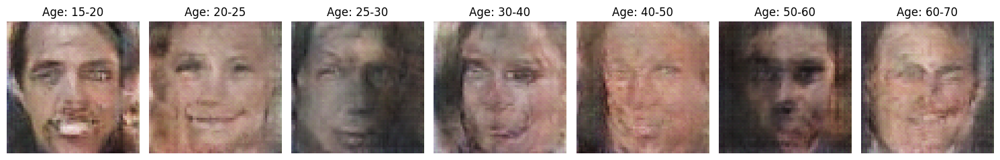

Saved checkpoint for epoch 51 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_51.pth
[Epoch 52/150] [Batch 1/79] [D loss: 0.10535236448049545] [G loss: 4.5548248291015625]
[Epoch 52/150] [Batch 2/79] [D loss: 0.13930213451385498] [G loss: 3.315392255783081]
[Epoch 52/150] [Batch 3/79] [D loss: 0.1262451410293579] [G loss: 5.644946575164795]
[Epoch 52/150] [Batch 4/79] [D loss: 0.0989597961306572] [G loss: 4.529151916503906]
[Epoch 52/150] [Batch 5/79] [D loss: 0.10710740089416504] [G loss: 2.82954740524292]
[Epoch 52/150] [Batch 6/79] [D loss: 0.22220323979854584] [G loss: 7.423059463500977]
[Epoch 52/150] [Batch 7/79] [D loss: 0.20829010009765625] [G loss: 5.888459205627441]
[Epoch 52/150] [Batch 8/79] [D loss: 0.0821107029914856] [G loss: 4.015959739685059]
[Epoch 52/150] [Batch 9/79] [D loss: 0.06114842742681503] [G loss: 4.761326789855957]
[Epoch 52/150] [Batch 10/79] [D loss: 0.061103884130716324] [G loss: 5.698671340942383]
[Epoch 52/150] [Batch 11/

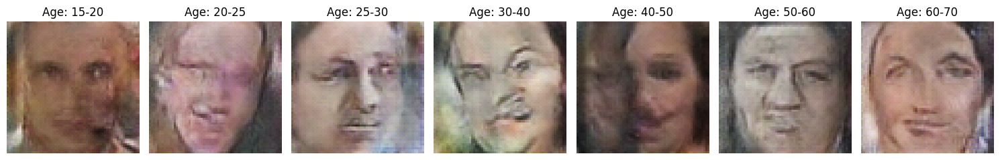

Saved checkpoint for epoch 52 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_52.pth
[Epoch 53/150] [Batch 1/79] [D loss: 0.04941368103027344] [G loss: 5.546419620513916]
[Epoch 53/150] [Batch 2/79] [D loss: 0.049056824296712875] [G loss: 4.615652084350586]
[Epoch 53/150] [Batch 3/79] [D loss: 0.04026005417108536] [G loss: 6.084711074829102]
[Epoch 53/150] [Batch 4/79] [D loss: 0.026394501328468323] [G loss: 6.06389045715332]
[Epoch 53/150] [Batch 5/79] [D loss: 0.042907483875751495] [G loss: 5.218804359436035]
[Epoch 53/150] [Batch 6/79] [D loss: 0.023608870804309845] [G loss: 5.053798198699951]
[Epoch 53/150] [Batch 7/79] [D loss: 0.049701787531375885] [G loss: 5.734460353851318]
[Epoch 53/150] [Batch 8/79] [D loss: 0.03884482383728027] [G loss: 6.236622333526611]
[Epoch 53/150] [Batch 9/79] [D loss: 0.11905589699745178] [G loss: 2.5281405448913574]
[Epoch 53/150] [Batch 10/79] [D loss: 0.025655396282672882] [G loss: 5.100667953491211]
[Epoch 53/150] [B

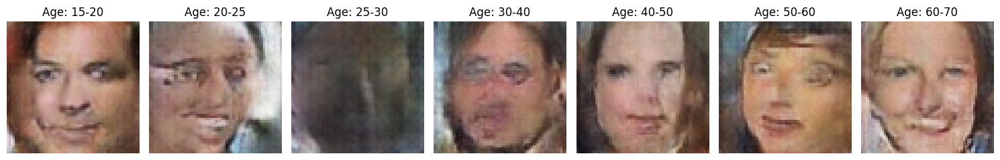

Saved checkpoint for epoch 53 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_53.pth
[Epoch 54/150] [Batch 1/79] [D loss: 2.2015321254730225] [G loss: 10.01628303527832]
[Epoch 54/150] [Batch 2/79] [D loss: 0.9319508075714111] [G loss: 7.3773088455200195]
[Epoch 54/150] [Batch 3/79] [D loss: 0.062266379594802856] [G loss: 3.493166923522949]
[Epoch 54/150] [Batch 4/79] [D loss: 0.279649943113327] [G loss: 7.135623931884766]
[Epoch 54/150] [Batch 5/79] [D loss: 0.06371836364269257] [G loss: 7.798818588256836]
[Epoch 54/150] [Batch 6/79] [D loss: 0.10984420776367188] [G loss: 6.966343879699707]
[Epoch 54/150] [Batch 7/79] [D loss: 0.09989017993211746] [G loss: 5.497178554534912]
[Epoch 54/150] [Batch 8/79] [D loss: 0.047286391258239746] [G loss: 5.961380958557129]
[Epoch 54/150] [Batch 9/79] [D loss: 0.043299611657857895] [G loss: 5.693319320678711]
[Epoch 54/150] [Batch 10/79] [D loss: 0.013606324791908264] [G loss: 5.6974945068359375]
[Epoch 54/150] [Batch

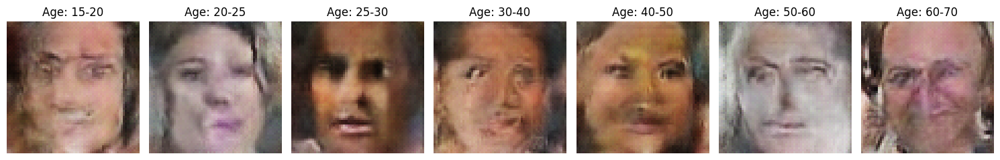

Saved checkpoint for epoch 54 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_54.pth
[Epoch 55/150] [Batch 1/79] [D loss: 0.05111134424805641] [G loss: 4.978207588195801]
[Epoch 55/150] [Batch 2/79] [D loss: 0.02967686951160431] [G loss: 4.429110527038574]
[Epoch 55/150] [Batch 3/79] [D loss: 0.031378090381622314] [G loss: 3.9375507831573486]
[Epoch 55/150] [Batch 4/79] [D loss: 0.05712774768471718] [G loss: 4.893250465393066]
[Epoch 55/150] [Batch 5/79] [D loss: 0.018913744017481804] [G loss: 5.378047943115234]
[Epoch 55/150] [Batch 6/79] [D loss: 0.025049399584531784] [G loss: 4.769373893737793]
[Epoch 55/150] [Batch 7/79] [D loss: 0.028351396322250366] [G loss: 4.314847469329834]
[Epoch 55/150] [Batch 8/79] [D loss: 0.046484533697366714] [G loss: 4.083246231079102]
[Epoch 55/150] [Batch 9/79] [D loss: 0.08533379435539246] [G loss: 4.688714981079102]
[Epoch 55/150] [Batch 10/79] [D loss: 0.07258340716362] [G loss: 4.079258918762207]
[Epoch 55/150] [Batc

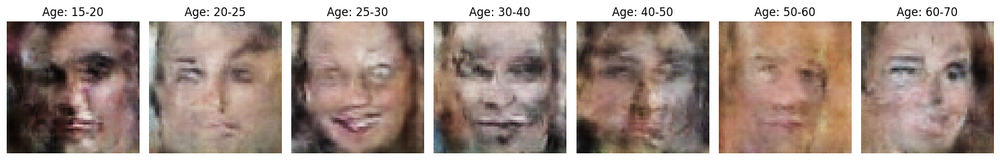

Saved checkpoint for epoch 55 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_55.pth
[Epoch 56/150] [Batch 1/79] [D loss: 0.07480061054229736] [G loss: 3.8126137256622314]
[Epoch 56/150] [Batch 2/79] [D loss: 0.12081295251846313] [G loss: 6.058537006378174]
[Epoch 56/150] [Batch 3/79] [D loss: 0.10396509617567062] [G loss: 4.990414142608643]
[Epoch 56/150] [Batch 4/79] [D loss: 0.09073008596897125] [G loss: 4.65146541595459]
[Epoch 56/150] [Batch 5/79] [D loss: 0.14874117076396942] [G loss: 6.533807754516602]
[Epoch 56/150] [Batch 6/79] [D loss: 0.033238887786865234] [G loss: 6.757439613342285]
[Epoch 56/150] [Batch 7/79] [D loss: 0.09750252962112427] [G loss: 5.231205940246582]
[Epoch 56/150] [Batch 8/79] [D loss: 0.03318355232477188] [G loss: 4.456445693969727]
[Epoch 56/150] [Batch 9/79] [D loss: 0.043985482305288315] [G loss: 5.005714416503906]
[Epoch 56/150] [Batch 10/79] [D loss: 0.019872140139341354] [G loss: 5.016881942749023]
[Epoch 56/150] [Batc

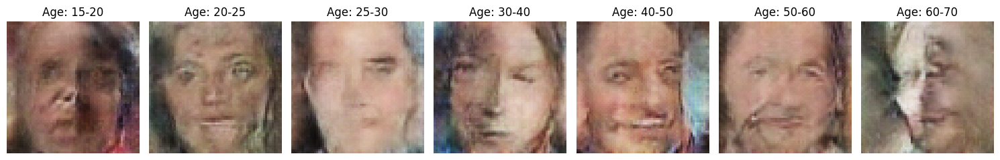

Saved checkpoint for epoch 56 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_56.pth
[Epoch 57/150] [Batch 1/79] [D loss: 0.5062450170516968] [G loss: 10.184035301208496]
[Epoch 57/150] [Batch 2/79] [D loss: 3.009310007095337] [G loss: 8.416851043701172]
[Epoch 57/150] [Batch 3/79] [D loss: 2.1685268878936768] [G loss: 5.646185398101807]
[Epoch 57/150] [Batch 4/79] [D loss: 1.1527599096298218] [G loss: 3.6908421516418457]
[Epoch 57/150] [Batch 5/79] [D loss: 0.45747649669647217] [G loss: 2.761744260787964]
[Epoch 57/150] [Batch 6/79] [D loss: 0.3506714701652527] [G loss: 2.8411943912506104]
[Epoch 57/150] [Batch 7/79] [D loss: 0.11898840218782425] [G loss: 3.225670576095581]
[Epoch 57/150] [Batch 8/79] [D loss: 0.06665647029876709] [G loss: 3.5358686447143555]
[Epoch 57/150] [Batch 9/79] [D loss: 0.045140206813812256] [G loss: 3.759840965270996]
[Epoch 57/150] [Batch 10/79] [D loss: 0.05815436318516731] [G loss: 3.4506916999816895]
[Epoch 57/150] [Batch 1

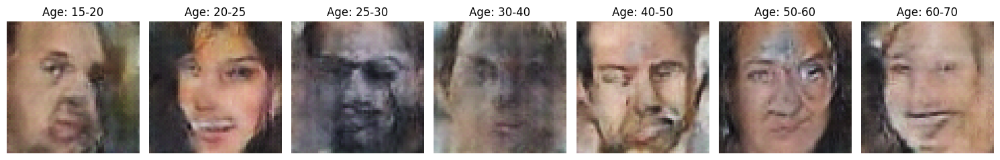

Saved checkpoint for epoch 57 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_57.pth
[Epoch 58/150] [Batch 1/79] [D loss: 0.06733261793851852] [G loss: 6.8691582679748535]
[Epoch 58/150] [Batch 2/79] [D loss: 0.0908566415309906] [G loss: 3.9884824752807617]
[Epoch 58/150] [Batch 3/79] [D loss: 0.01900753378868103] [G loss: 4.8089165687561035]
[Epoch 58/150] [Batch 4/79] [D loss: 0.687737226486206] [G loss: 10.823904037475586]
[Epoch 58/150] [Batch 5/79] [D loss: 3.59029221534729] [G loss: 9.173311233520508]
[Epoch 58/150] [Batch 6/79] [D loss: 2.6767239570617676] [G loss: 6.89973258972168]
[Epoch 58/150] [Batch 7/79] [D loss: 1.7542915344238281] [G loss: 4.546247959136963]
[Epoch 58/150] [Batch 8/79] [D loss: 0.9738580584526062] [G loss: 2.6875767707824707]
[Epoch 58/150] [Batch 9/79] [D loss: 0.5572330355644226] [G loss: 1.8969802856445312]
[Epoch 58/150] [Batch 10/79] [D loss: 0.36426353454589844] [G loss: 2.002845525741577]
[Epoch 58/150] [Batch 11/79]

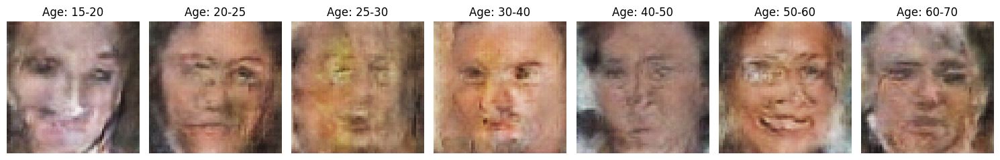

Saved checkpoint for epoch 58 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_58.pth
[Epoch 59/150] [Batch 1/79] [D loss: 0.044020503759384155] [G loss: 3.3471291065216064]
[Epoch 59/150] [Batch 2/79] [D loss: 0.053934838622808456] [G loss: 3.3908934593200684]
[Epoch 59/150] [Batch 3/79] [D loss: 0.04598095268011093] [G loss: 3.4266786575317383]
[Epoch 59/150] [Batch 4/79] [D loss: 0.03712129220366478] [G loss: 3.5969457626342773]
[Epoch 59/150] [Batch 5/79] [D loss: 0.029377950355410576] [G loss: 3.8288228511810303]
[Epoch 59/150] [Batch 6/79] [D loss: 0.05214455723762512] [G loss: 3.4150643348693848]
[Epoch 59/150] [Batch 7/79] [D loss: 0.05297909304499626] [G loss: 3.42946457862854]
[Epoch 59/150] [Batch 8/79] [D loss: 0.07045406103134155] [G loss: 3.5061354637145996]
[Epoch 59/150] [Batch 9/79] [D loss: 0.038082707673311234] [G loss: 3.886011838912964]
[Epoch 59/150] [Batch 10/79] [D loss: 0.028970928862690926] [G loss: 4.0487470626831055]
[Epoch 59/1

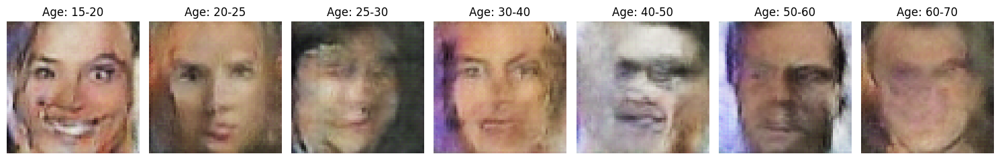

Saved checkpoint for epoch 59 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_59.pth
[Epoch 60/150] [Batch 1/79] [D loss: 0.07402006536722183] [G loss: 4.760754585266113]
[Epoch 60/150] [Batch 2/79] [D loss: 0.031658563762903214] [G loss: 5.215375900268555]
[Epoch 60/150] [Batch 3/79] [D loss: 0.04903385043144226] [G loss: 3.893239974975586]
[Epoch 60/150] [Batch 4/79] [D loss: 0.056030746549367905] [G loss: 4.48617696762085]
[Epoch 60/150] [Batch 5/79] [D loss: 0.02423105761408806] [G loss: 4.860586643218994]
[Epoch 60/150] [Batch 6/79] [D loss: 0.03589881211519241] [G loss: 4.780117988586426]
[Epoch 60/150] [Batch 7/79] [D loss: 0.03904740512371063] [G loss: 4.679385185241699]
[Epoch 60/150] [Batch 8/79] [D loss: 0.04067438840866089] [G loss: 4.726354598999023]
[Epoch 60/150] [Batch 9/79] [D loss: 0.029728569090366364] [G loss: 4.845440864562988]
[Epoch 60/150] [Batch 10/79] [D loss: 0.06556665897369385] [G loss: 5.677943706512451]
[Epoch 60/150] [Batch

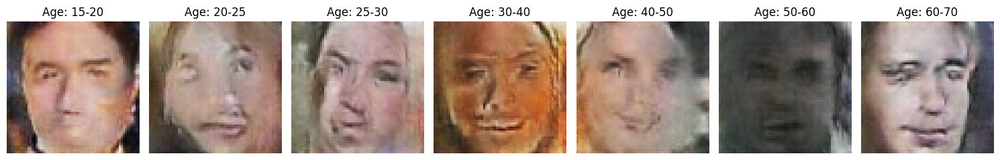

Saved checkpoint for epoch 60 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_60.pth
[Epoch 61/150] [Batch 1/79] [D loss: 0.029445504769682884] [G loss: 5.821937561035156]
[Epoch 61/150] [Batch 2/79] [D loss: 0.037408143281936646] [G loss: 6.210240364074707]
[Epoch 61/150] [Batch 3/79] [D loss: 0.05376097932457924] [G loss: 4.93034029006958]
[Epoch 61/150] [Batch 4/79] [D loss: 0.05120464786887169] [G loss: 3.0516414642333984]
[Epoch 61/150] [Batch 5/79] [D loss: 0.013288645073771477] [G loss: 3.971848964691162]
[Epoch 61/150] [Batch 6/79] [D loss: 0.0146664809435606] [G loss: 4.805318832397461]
[Epoch 61/150] [Batch 7/79] [D loss: 0.8840214610099792] [G loss: 11.390989303588867]
[Epoch 61/150] [Batch 8/79] [D loss: 2.939249277114868] [G loss: 10.039794921875]
[Epoch 61/150] [Batch 9/79] [D loss: 2.161679744720459] [G loss: 7.77530574798584]
[Epoch 61/150] [Batch 10/79] [D loss: 0.9330682754516602] [G loss: 5.269979476928711]
[Epoch 61/150] [Batch 11/79] 

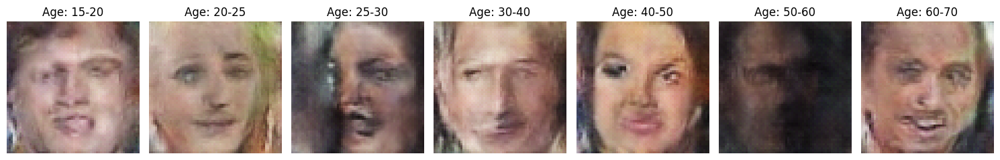

Saved checkpoint for epoch 61 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_61.pth
[Epoch 62/150] [Batch 1/79] [D loss: 0.1621454507112503] [G loss: 2.9942221641540527]
[Epoch 62/150] [Batch 2/79] [D loss: 0.1715412437915802] [G loss: 7.48836088180542]
[Epoch 62/150] [Batch 3/79] [D loss: 0.17785929143428802] [G loss: 6.84747838973999]
[Epoch 62/150] [Batch 4/79] [D loss: 0.019465437158942223] [G loss: 5.519001007080078]
[Epoch 62/150] [Batch 5/79] [D loss: 0.018057940527796745] [G loss: 5.217419624328613]
[Epoch 62/150] [Batch 6/79] [D loss: 0.036838725209236145] [G loss: 5.527312278747559]
[Epoch 62/150] [Batch 7/79] [D loss: 0.017542008310556412] [G loss: 5.573252201080322]
[Epoch 62/150] [Batch 8/79] [D loss: 0.02465200610458851] [G loss: 5.480217456817627]
[Epoch 62/150] [Batch 9/79] [D loss: 0.016727540642023087] [G loss: 4.897083759307861]
[Epoch 62/150] [Batch 10/79] [D loss: 0.030912311747670174] [G loss: 4.795802593231201]
[Epoch 62/150] [Batc

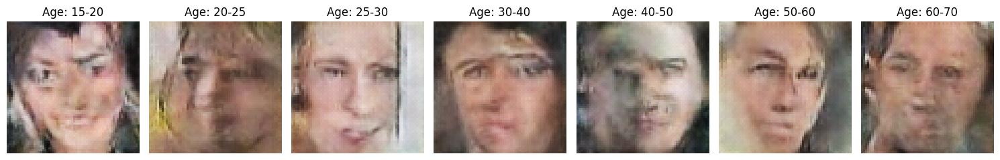

Saved checkpoint for epoch 62 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_62.pth
[Epoch 63/150] [Batch 1/79] [D loss: 0.018546219915151596] [G loss: 4.779242992401123]
[Epoch 63/150] [Batch 2/79] [D loss: 0.020890282467007637] [G loss: 4.25587272644043]
[Epoch 63/150] [Batch 3/79] [D loss: 0.03883608803153038] [G loss: 3.905080795288086]
[Epoch 63/150] [Batch 4/79] [D loss: 0.057021185755729675] [G loss: 3.4226791858673096]
[Epoch 63/150] [Batch 5/79] [D loss: 0.055798113346099854] [G loss: 3.6434884071350098]
[Epoch 63/150] [Batch 6/79] [D loss: 0.029385467991232872] [G loss: 4.1389055252075195]
[Epoch 63/150] [Batch 7/79] [D loss: 0.06080314517021179] [G loss: 3.5618479251861572]
[Epoch 63/150] [Batch 8/79] [D loss: 0.04863933473825455] [G loss: 3.6380279064178467]
[Epoch 63/150] [Batch 9/79] [D loss: 0.08404870331287384] [G loss: 3.6543331146240234]
[Epoch 63/150] [Batch 10/79] [D loss: 0.06643111258745193] [G loss: 3.7418856620788574]
[Epoch 63/15

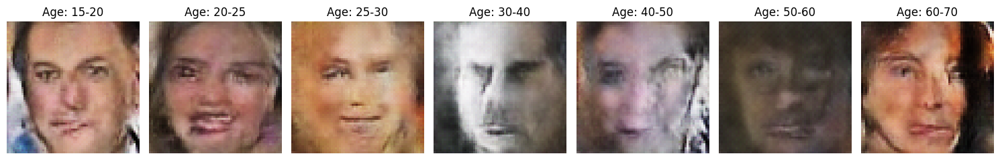

Saved checkpoint for epoch 63 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_63.pth
[Epoch 64/150] [Batch 1/79] [D loss: 0.04504452273249626] [G loss: 5.764289855957031]
[Epoch 64/150] [Batch 2/79] [D loss: 0.03334404155611992] [G loss: 5.277957916259766]
[Epoch 64/150] [Batch 3/79] [D loss: 0.05000312626361847] [G loss: 4.663698196411133]
[Epoch 64/150] [Batch 4/79] [D loss: 0.02246072329580784] [G loss: 4.465664863586426]
[Epoch 64/150] [Batch 5/79] [D loss: 0.06653840094804764] [G loss: 5.525790691375732]
[Epoch 64/150] [Batch 6/79] [D loss: 0.047055434435606] [G loss: 5.189953327178955]
[Epoch 64/150] [Batch 7/79] [D loss: 0.04403459280729294] [G loss: 4.347930908203125]
[Epoch 64/150] [Batch 8/79] [D loss: 0.034833524376153946] [G loss: 5.544466972351074]
[Epoch 64/150] [Batch 9/79] [D loss: 0.022201141342520714] [G loss: 5.487179756164551]
[Epoch 64/150] [Batch 10/79] [D loss: 0.03054085746407509] [G loss: 4.8900465965271]
[Epoch 64/150] [Batch 11/

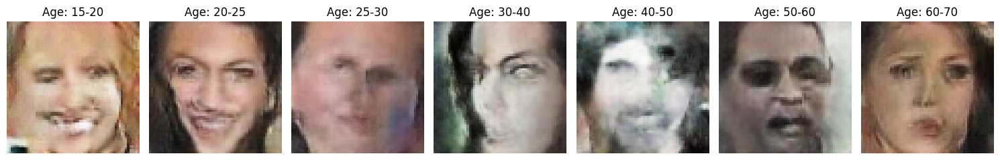

Saved checkpoint for epoch 64 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_64.pth
[Epoch 65/150] [Batch 1/79] [D loss: 0.023591332137584686] [G loss: 5.528358459472656]
[Epoch 65/150] [Batch 2/79] [D loss: 0.05185941979289055] [G loss: 5.454568862915039]
[Epoch 65/150] [Batch 3/79] [D loss: 0.0352511890232563] [G loss: 4.877958297729492]
[Epoch 65/150] [Batch 4/79] [D loss: 0.06492523849010468] [G loss: 5.145357131958008]
[Epoch 65/150] [Batch 5/79] [D loss: 0.04609951376914978] [G loss: 6.158791542053223]
[Epoch 65/150] [Batch 6/79] [D loss: 0.053124263882637024] [G loss: 4.9912567138671875]
[Epoch 65/150] [Batch 7/79] [D loss: 0.1109035462141037] [G loss: 7.142283916473389]
[Epoch 65/150] [Batch 8/79] [D loss: 0.13323548436164856] [G loss: 4.857171058654785]
[Epoch 65/150] [Batch 9/79] [D loss: 0.05185622721910477] [G loss: 5.0129075050354]
[Epoch 65/150] [Batch 10/79] [D loss: 0.05564321577548981] [G loss: 7.081632614135742]
[Epoch 65/150] [Batch 11

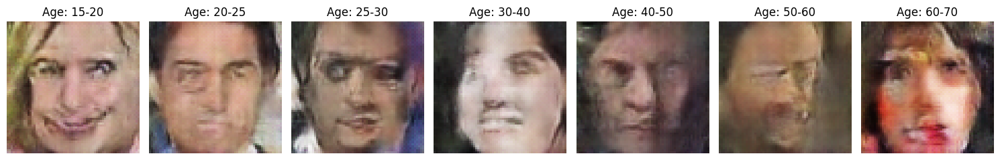

Saved checkpoint for epoch 65 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_65.pth
[Epoch 66/150] [Batch 1/79] [D loss: 0.8444621562957764] [G loss: 4.018990516662598]
[Epoch 66/150] [Batch 2/79] [D loss: 0.5572906136512756] [G loss: 2.89251708984375]
[Epoch 66/150] [Batch 3/79] [D loss: 0.395221084356308] [G loss: 2.3991990089416504]
[Epoch 66/150] [Batch 4/79] [D loss: 0.20642179250717163] [G loss: 2.1313071250915527]
[Epoch 66/150] [Batch 5/79] [D loss: 0.2027987837791443] [G loss: 2.210036039352417]
[Epoch 66/150] [Batch 6/79] [D loss: 0.1703629195690155] [G loss: 2.607591152191162]
[Epoch 66/150] [Batch 7/79] [D loss: 0.18572445213794708] [G loss: 2.487122058868408]
[Epoch 66/150] [Batch 8/79] [D loss: 0.09770777821540833] [G loss: 2.922085762023926]
[Epoch 66/150] [Batch 9/79] [D loss: 0.15372085571289062] [G loss: 2.8116111755371094]
[Epoch 66/150] [Batch 10/79] [D loss: 0.15961825847625732] [G loss: 2.564408540725708]
[Epoch 66/150] [Batch 11/79

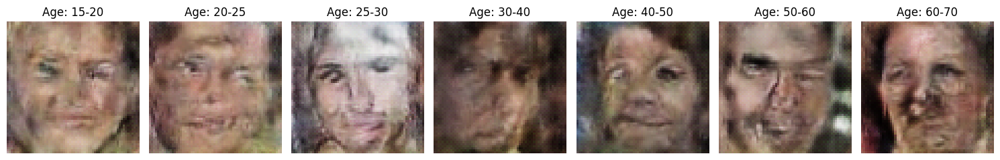

Saved checkpoint for epoch 66 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_66.pth
[Epoch 67/150] [Batch 1/79] [D loss: 0.03105172887444496] [G loss: 4.599644660949707]
[Epoch 67/150] [Batch 2/79] [D loss: 0.06830938160419464] [G loss: 4.307126045227051]
[Epoch 67/150] [Batch 3/79] [D loss: 0.05890056490898132] [G loss: 4.290642738342285]
[Epoch 67/150] [Batch 4/79] [D loss: 0.05076487734913826] [G loss: 4.190397262573242]
[Epoch 67/150] [Batch 5/79] [D loss: 0.06544351577758789] [G loss: 4.13237190246582]
[Epoch 67/150] [Batch 6/79] [D loss: 0.05870220810174942] [G loss: 4.368546485900879]
[Epoch 67/150] [Batch 7/79] [D loss: 0.05689908191561699] [G loss: 4.610087871551514]
[Epoch 67/150] [Batch 8/79] [D loss: 0.030582092702388763] [G loss: 4.628570556640625]
[Epoch 67/150] [Batch 9/79] [D loss: 0.0633988231420517] [G loss: 3.7153592109680176]
[Epoch 67/150] [Batch 10/79] [D loss: 0.11073499917984009] [G loss: 6.638265609741211]
[Epoch 67/150] [Batch 1

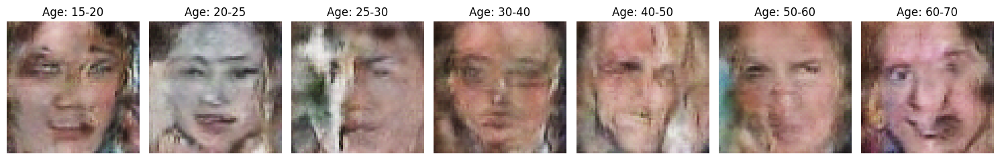

Saved checkpoint for epoch 67 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_67.pth
[Epoch 68/150] [Batch 1/79] [D loss: 0.028020348399877548] [G loss: 4.396411895751953]
[Epoch 68/150] [Batch 2/79] [D loss: 0.031136419624090195] [G loss: 4.564113616943359]
[Epoch 68/150] [Batch 3/79] [D loss: 0.061193328350782394] [G loss: 3.409282922744751]
[Epoch 68/150] [Batch 4/79] [D loss: 0.09393572062253952] [G loss: 6.525701999664307]
[Epoch 68/150] [Batch 5/79] [D loss: 0.12310601025819778] [G loss: 5.069610118865967]
[Epoch 68/150] [Batch 6/79] [D loss: 0.026083409786224365] [G loss: 5.1755523681640625]
[Epoch 68/150] [Batch 7/79] [D loss: 0.03762291744351387] [G loss: 6.5556182861328125]
[Epoch 68/150] [Batch 8/79] [D loss: 0.007518008351325989] [G loss: 6.778188705444336]
[Epoch 68/150] [Batch 9/79] [D loss: 0.006027513183653355] [G loss: 6.252498149871826]
[Epoch 68/150] [Batch 10/79] [D loss: 0.023906107991933823] [G loss: 5.391401767730713]
[Epoch 68/150]

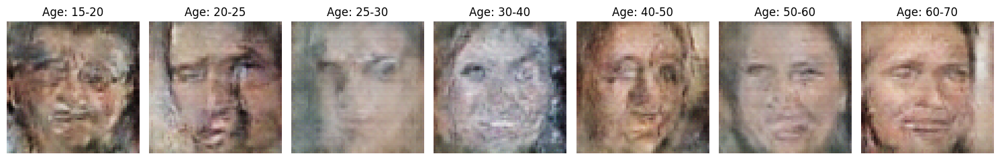

Saved checkpoint for epoch 68 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_68.pth
[Epoch 69/150] [Batch 1/79] [D loss: 0.062025777995586395] [G loss: 5.761056900024414]
[Epoch 69/150] [Batch 2/79] [D loss: 0.05222127214074135] [G loss: 4.963052749633789]
[Epoch 69/150] [Batch 3/79] [D loss: 0.06929491460323334] [G loss: 4.334158420562744]
[Epoch 69/150] [Batch 4/79] [D loss: 0.13159909844398499] [G loss: 5.187431335449219]
[Epoch 69/150] [Batch 5/79] [D loss: 0.12272234261035919] [G loss: 4.481240272521973]
[Epoch 69/150] [Batch 6/79] [D loss: 0.05586998909711838] [G loss: 4.371548652648926]
[Epoch 69/150] [Batch 7/79] [D loss: 0.09383893758058548] [G loss: 5.1526665687561035]
[Epoch 69/150] [Batch 8/79] [D loss: 0.08215278387069702] [G loss: 4.566295623779297]
[Epoch 69/150] [Batch 9/79] [D loss: 0.04382603242993355] [G loss: 4.1962199211120605]
[Epoch 69/150] [Batch 10/79] [D loss: 0.06792844086885452] [G loss: 4.251614570617676]
[Epoch 69/150] [Batc

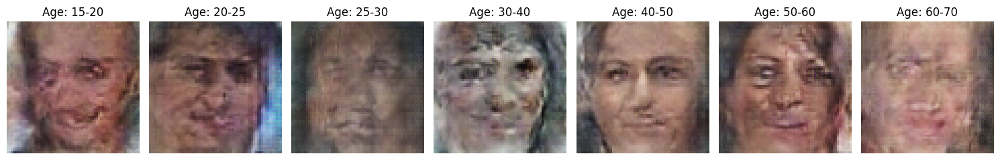

Saved checkpoint for epoch 69 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_69.pth
[Epoch 70/150] [Batch 1/79] [D loss: 0.10913973301649094] [G loss: 5.93973970413208]
[Epoch 70/150] [Batch 2/79] [D loss: 0.00861282367259264] [G loss: 6.5496110916137695]
[Epoch 70/150] [Batch 3/79] [D loss: 0.01371680200099945] [G loss: 6.0968217849731445]
[Epoch 70/150] [Batch 4/79] [D loss: 0.0386333204805851] [G loss: 5.116679668426514]
[Epoch 70/150] [Batch 5/79] [D loss: 0.08702406287193298] [G loss: 4.337555885314941]
[Epoch 70/150] [Batch 6/79] [D loss: 0.06108132377266884] [G loss: 5.582690238952637]
[Epoch 70/150] [Batch 7/79] [D loss: 0.027035139501094818] [G loss: 5.686527252197266]
[Epoch 70/150] [Batch 8/79] [D loss: 0.02036631852388382] [G loss: 5.256983757019043]
[Epoch 70/150] [Batch 9/79] [D loss: 0.03990769013762474] [G loss: 4.69305944442749]
[Epoch 70/150] [Batch 10/79] [D loss: 0.045908477157354355] [G loss: 6.019681930541992]
[Epoch 70/150] [Batch 

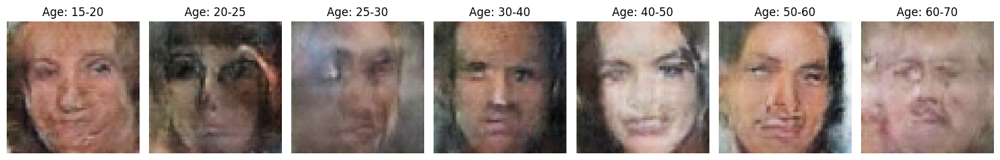

Saved checkpoint for epoch 70 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_70.pth
[Epoch 71/150] [Batch 1/79] [D loss: 0.8717987537384033] [G loss: 10.781604766845703]
[Epoch 71/150] [Batch 2/79] [D loss: 2.8829009532928467] [G loss: 9.287666320800781]
[Epoch 71/150] [Batch 3/79] [D loss: 2.086822032928467] [G loss: 5.37450647354126]
[Epoch 71/150] [Batch 4/79] [D loss: 0.6278489232063293] [G loss: 2.2036633491516113]
[Epoch 71/150] [Batch 5/79] [D loss: 0.34140118956565857] [G loss: 4.025092124938965]
[Epoch 71/150] [Batch 6/79] [D loss: 0.13077250123023987] [G loss: 4.410318374633789]
[Epoch 71/150] [Batch 7/79] [D loss: 0.06635144352912903] [G loss: 4.483277797698975]
[Epoch 71/150] [Batch 8/79] [D loss: 0.08234798908233643] [G loss: 3.49874210357666]
[Epoch 71/150] [Batch 9/79] [D loss: 0.20087018609046936] [G loss: 5.22213888168335]
[Epoch 71/150] [Batch 10/79] [D loss: 0.2078363001346588] [G loss: 5.236579895019531]
[Epoch 71/150] [Batch 11/79] [

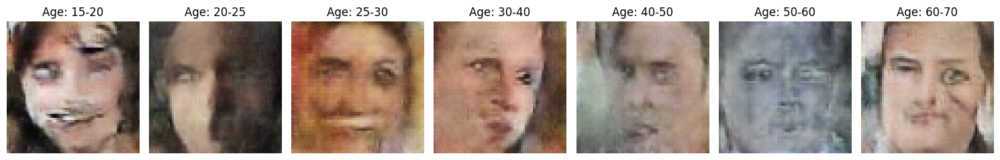

Saved checkpoint for epoch 71 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_71.pth
[Epoch 72/150] [Batch 1/79] [D loss: 0.013077604584395885] [G loss: 4.247463226318359]
[Epoch 72/150] [Batch 2/79] [D loss: 0.10100404918193817] [G loss: 8.649459838867188]
[Epoch 72/150] [Batch 3/79] [D loss: 0.0825289860367775] [G loss: 8.23782730102539]
[Epoch 72/150] [Batch 4/79] [D loss: 0.04528056085109711] [G loss: 6.201724052429199]
[Epoch 72/150] [Batch 5/79] [D loss: 0.06578231602907181] [G loss: 7.076408386230469]
[Epoch 72/150] [Batch 6/79] [D loss: 0.007600908167660236] [G loss: 7.744235992431641]
[Epoch 72/150] [Batch 7/79] [D loss: 0.014045033603906631] [G loss: 7.093006134033203]
[Epoch 72/150] [Batch 8/79] [D loss: 0.017027754336595535] [G loss: 5.849428176879883]
[Epoch 72/150] [Batch 9/79] [D loss: 0.026567712426185608] [G loss: 5.590201377868652]
[Epoch 72/150] [Batch 10/79] [D loss: 0.04546186327934265] [G loss: 6.511335372924805]
[Epoch 72/150] [Batc

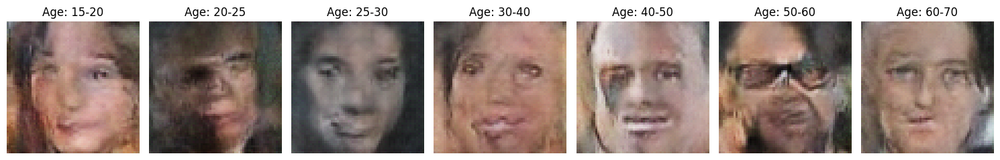

Saved checkpoint for epoch 72 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_72.pth
[Epoch 73/150] [Batch 1/79] [D loss: 0.32864853739738464] [G loss: 8.567644119262695]
[Epoch 73/150] [Batch 2/79] [D loss: 0.8679277896881104] [G loss: 7.652792930603027]
[Epoch 73/150] [Batch 3/79] [D loss: 0.14783278107643127] [G loss: 6.1489129066467285]
[Epoch 73/150] [Batch 4/79] [D loss: 0.015256298705935478] [G loss: 5.53428840637207]
[Epoch 73/150] [Batch 5/79] [D loss: 0.04046443849802017] [G loss: 5.172091007232666]
[Epoch 73/150] [Batch 6/79] [D loss: 0.03640332818031311] [G loss: 5.55827522277832]
[Epoch 73/150] [Batch 7/79] [D loss: 0.014774700626730919] [G loss: 5.90298318862915]
[Epoch 73/150] [Batch 8/79] [D loss: 0.009209265932440758] [G loss: 5.668182373046875]
[Epoch 73/150] [Batch 9/79] [D loss: 0.012080986984074116] [G loss: 5.197535991668701]
[Epoch 73/150] [Batch 10/79] [D loss: 0.012976880185306072] [G loss: 5.051313400268555]
[Epoch 73/150] [Batch

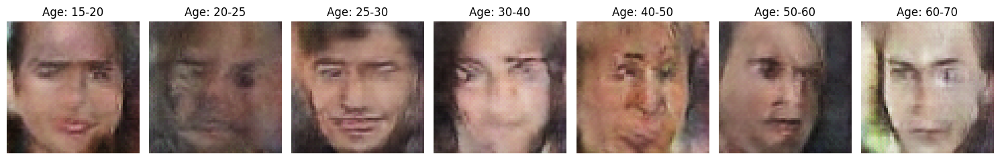

Saved checkpoint for epoch 73 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_73.pth
[Epoch 74/150] [Batch 1/79] [D loss: 0.08030033856630325] [G loss: 6.4389801025390625]
[Epoch 74/150] [Batch 2/79] [D loss: 0.030721087008714676] [G loss: 6.4495744705200195]
[Epoch 74/150] [Batch 3/79] [D loss: 0.05299254134297371] [G loss: 5.678157806396484]
[Epoch 74/150] [Batch 4/79] [D loss: 0.053020842373371124] [G loss: 4.267942905426025]
[Epoch 74/150] [Batch 5/79] [D loss: 0.11315979808568954] [G loss: 8.168859481811523]
[Epoch 74/150] [Batch 6/79] [D loss: 0.23072625696659088] [G loss: 6.879237174987793]
[Epoch 74/150] [Batch 7/79] [D loss: 0.03578291833400726] [G loss: 6.653136253356934]
[Epoch 74/150] [Batch 8/79] [D loss: 0.0632338747382164] [G loss: 4.399662494659424]
[Epoch 74/150] [Batch 9/79] [D loss: 0.13622479140758514] [G loss: 8.09712028503418]
[Epoch 74/150] [Batch 10/79] [D loss: 0.03168486803770065] [G loss: 8.62178897857666]
[Epoch 74/150] [Batch 

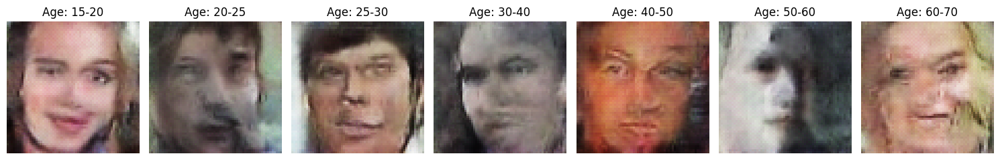

Saved checkpoint for epoch 74 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_74.pth
[Epoch 75/150] [Batch 1/79] [D loss: 0.03911713883280754] [G loss: 7.082546234130859]
[Epoch 75/150] [Batch 2/79] [D loss: 0.0646718442440033] [G loss: 5.964400291442871]
[Epoch 75/150] [Batch 3/79] [D loss: 0.01820894330739975] [G loss: 4.1900224685668945]
[Epoch 75/150] [Batch 4/79] [D loss: 0.053275033831596375] [G loss: 5.311559200286865]
[Epoch 75/150] [Batch 5/79] [D loss: 0.015153690241277218] [G loss: 5.679880142211914]
[Epoch 75/150] [Batch 6/79] [D loss: 0.023308124393224716] [G loss: 5.896058559417725]
[Epoch 75/150] [Batch 7/79] [D loss: 0.03643670678138733] [G loss: 5.36991548538208]
[Epoch 75/150] [Batch 8/79] [D loss: 0.06833138316869736] [G loss: 3.9827017784118652]
[Epoch 75/150] [Batch 9/79] [D loss: 0.2387521117925644] [G loss: 9.366155624389648]
[Epoch 75/150] [Batch 10/79] [D loss: 0.4426361322402954] [G loss: 8.84493637084961]
[Epoch 75/150] [Batch 1

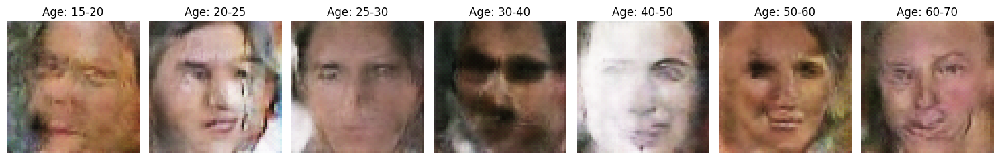

Saved checkpoint for epoch 75 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_75.pth
[Epoch 76/150] [Batch 1/79] [D loss: 0.03581530228257179] [G loss: 4.978699684143066]
[Epoch 76/150] [Batch 2/79] [D loss: 0.030380496755242348] [G loss: 4.993735313415527]
[Epoch 76/150] [Batch 3/79] [D loss: 0.018227552995085716] [G loss: 4.99405574798584]
[Epoch 76/150] [Batch 4/79] [D loss: 0.02868770994246006] [G loss: 4.722522735595703]
[Epoch 76/150] [Batch 5/79] [D loss: 0.03851292282342911] [G loss: 4.641096115112305]
[Epoch 76/150] [Batch 6/79] [D loss: 0.05116300657391548] [G loss: 4.346192359924316]
[Epoch 76/150] [Batch 7/79] [D loss: 0.03725533187389374] [G loss: 4.187114715576172]
[Epoch 76/150] [Batch 8/79] [D loss: 0.04022876173257828] [G loss: 4.63599157333374]
[Epoch 76/150] [Batch 9/79] [D loss: 0.03069438971579075] [G loss: 5.071417331695557]
[Epoch 76/150] [Batch 10/79] [D loss: 0.022328980267047882] [G loss: 5.219537734985352]
[Epoch 76/150] [Batch 

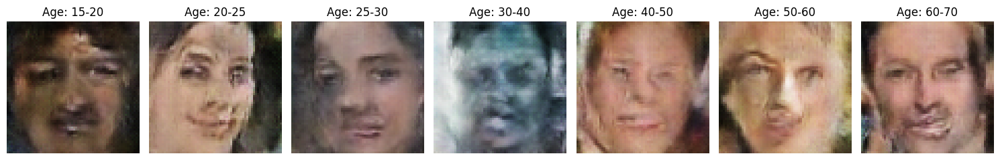

Saved checkpoint for epoch 76 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_76.pth
[Epoch 77/150] [Batch 1/79] [D loss: 0.033313997089862823] [G loss: 5.045284271240234]
[Epoch 77/150] [Batch 2/79] [D loss: 0.046287983655929565] [G loss: 4.889873504638672]
[Epoch 77/150] [Batch 3/79] [D loss: 0.04385935515165329] [G loss: 5.43084192276001]
[Epoch 77/150] [Batch 4/79] [D loss: 0.11903563886880875] [G loss: 3.4208903312683105]
[Epoch 77/150] [Batch 5/79] [D loss: 0.06719708442687988] [G loss: 5.973245143890381]
[Epoch 77/150] [Batch 6/79] [D loss: 0.06435863673686981] [G loss: 5.619361877441406]
[Epoch 77/150] [Batch 7/79] [D loss: 0.04031587019562721] [G loss: 5.362944602966309]
[Epoch 77/150] [Batch 8/79] [D loss: 0.01764126494526863] [G loss: 5.585948467254639]
[Epoch 77/150] [Batch 9/79] [D loss: 0.019791793078184128] [G loss: 5.067045211791992]
[Epoch 77/150] [Batch 10/79] [D loss: 0.02729833498597145] [G loss: 5.504637718200684]
[Epoch 77/150] [Batc

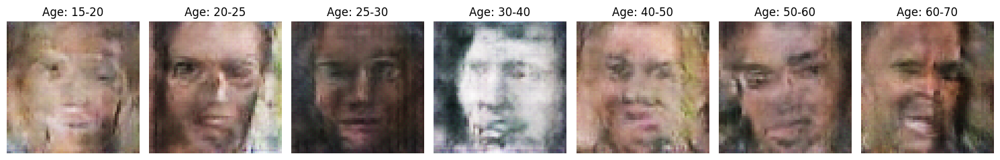

Saved checkpoint for epoch 77 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_77.pth
[Epoch 78/150] [Batch 1/79] [D loss: 0.029729094356298447] [G loss: 4.441817283630371]
[Epoch 78/150] [Batch 2/79] [D loss: 0.0467446893453598] [G loss: 4.236493110656738]
[Epoch 78/150] [Batch 3/79] [D loss: 0.021396324038505554] [G loss: 4.586736679077148]
[Epoch 78/150] [Batch 4/79] [D loss: 0.03244350478053093] [G loss: 4.3104939460754395]
[Epoch 78/150] [Batch 5/79] [D loss: 0.0345005989074707] [G loss: 4.376137733459473]
[Epoch 78/150] [Batch 6/79] [D loss: 0.04470454156398773] [G loss: 4.1407365798950195]
[Epoch 78/150] [Batch 7/79] [D loss: 0.04908392205834389] [G loss: 3.8189563751220703]
[Epoch 78/150] [Batch 8/79] [D loss: 0.06599888950586319] [G loss: 4.258944988250732]
[Epoch 78/150] [Batch 9/79] [D loss: 0.05835678428411484] [G loss: 4.10731315612793]
[Epoch 78/150] [Batch 10/79] [D loss: 0.03937174007296562] [G loss: 4.1493144035339355]
[Epoch 78/150] [Batc

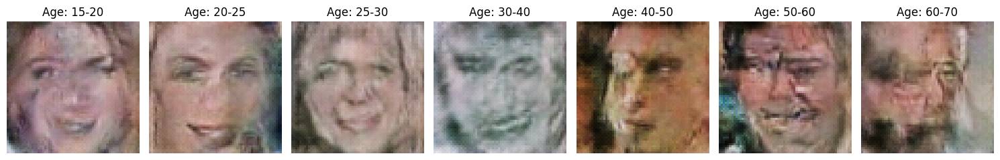

Saved checkpoint for epoch 78 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_78.pth
[Epoch 79/150] [Batch 1/79] [D loss: 0.0509147047996521] [G loss: 3.8631880283355713]
[Epoch 79/150] [Batch 2/79] [D loss: 0.07619109004735947] [G loss: 5.058856964111328]
[Epoch 79/150] [Batch 3/79] [D loss: 0.02616865187883377] [G loss: 5.403846740722656]
[Epoch 79/150] [Batch 4/79] [D loss: 0.015195687301456928] [G loss: 4.735536098480225]
[Epoch 79/150] [Batch 5/79] [D loss: 0.025086482986807823] [G loss: 4.768721103668213]
[Epoch 79/150] [Batch 6/79] [D loss: 0.02219095453619957] [G loss: 4.428664207458496]
[Epoch 79/150] [Batch 7/79] [D loss: 0.018686097115278244] [G loss: 4.505059242248535]
[Epoch 79/150] [Batch 8/79] [D loss: 0.02794835716485977] [G loss: 4.286080837249756]
[Epoch 79/150] [Batch 9/79] [D loss: 0.04230945557355881] [G loss: 4.325239181518555]
[Epoch 79/150] [Batch 10/79] [D loss: 0.07003901153802872] [G loss: 3.568809986114502]
[Epoch 79/150] [Batc

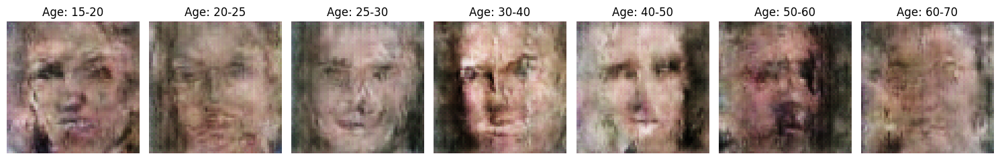

Saved checkpoint for epoch 79 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_79.pth
[Epoch 80/150] [Batch 1/79] [D loss: 0.09227894246578217] [G loss: 3.575669765472412]
[Epoch 80/150] [Batch 2/79] [D loss: 0.10945777595043182] [G loss: 3.518404483795166]
[Epoch 80/150] [Batch 3/79] [D loss: 0.09179139137268066] [G loss: 3.3942153453826904]
[Epoch 80/150] [Batch 4/79] [D loss: 0.10484617203474045] [G loss: 3.464719533920288]
[Epoch 80/150] [Batch 5/79] [D loss: 0.13644808530807495] [G loss: 3.5705459117889404]
[Epoch 80/150] [Batch 6/79] [D loss: 0.10311086475849152] [G loss: 4.145493507385254]
[Epoch 80/150] [Batch 7/79] [D loss: 0.0983513742685318] [G loss: 3.9755489826202393]
[Epoch 80/150] [Batch 8/79] [D loss: 0.09384142607450485] [G loss: 3.7072091102600098]
[Epoch 80/150] [Batch 9/79] [D loss: 0.0780642181634903] [G loss: 3.7154335975646973]
[Epoch 80/150] [Batch 10/79] [D loss: 0.11823723465204239] [G loss: 3.562695264816284]
[Epoch 80/150] [Batc

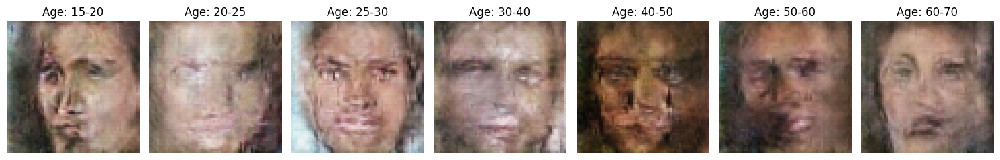

Saved checkpoint for epoch 80 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_80.pth
[Epoch 81/150] [Batch 1/79] [D loss: 0.1381126344203949] [G loss: 3.66184663772583]
[Epoch 81/150] [Batch 2/79] [D loss: 0.11970928311347961] [G loss: 4.645938873291016]
[Epoch 81/150] [Batch 3/79] [D loss: 0.10876679420471191] [G loss: 3.9177184104919434]
[Epoch 81/150] [Batch 4/79] [D loss: 0.11453911662101746] [G loss: 3.571678400039673]
[Epoch 81/150] [Batch 5/79] [D loss: 0.07783126831054688] [G loss: 4.562505722045898]
[Epoch 81/150] [Batch 6/79] [D loss: 0.10199473798274994] [G loss: 5.473698616027832]
[Epoch 81/150] [Batch 7/79] [D loss: 0.10651879012584686] [G loss: 4.694642066955566]
[Epoch 81/150] [Batch 8/79] [D loss: 0.08509551733732224] [G loss: 3.6194448471069336]
[Epoch 81/150] [Batch 9/79] [D loss: 0.11604991555213928] [G loss: 5.0138092041015625]
[Epoch 81/150] [Batch 10/79] [D loss: 0.08625951409339905] [G loss: 4.793658256530762]
[Epoch 81/150] [Batch 

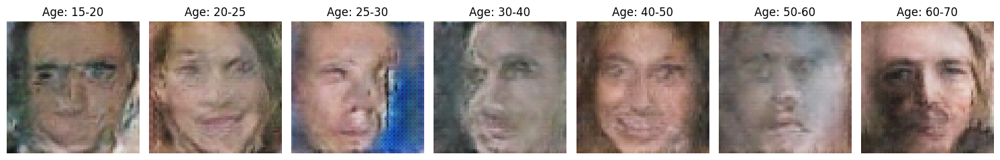

Saved checkpoint for epoch 81 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_81.pth
[Epoch 82/150] [Batch 1/79] [D loss: 0.048732370138168335] [G loss: 4.788500785827637]
[Epoch 82/150] [Batch 2/79] [D loss: 0.03244934603571892] [G loss: 4.6660237312316895]
[Epoch 82/150] [Batch 3/79] [D loss: 0.03450511395931244] [G loss: 4.40538215637207]
[Epoch 82/150] [Batch 4/79] [D loss: 0.08870791643857956] [G loss: 5.137193202972412]
[Epoch 82/150] [Batch 5/79] [D loss: 0.06949130445718765] [G loss: 4.336362838745117]
[Epoch 82/150] [Batch 6/79] [D loss: 0.06227115914225578] [G loss: 4.361577987670898]
[Epoch 82/150] [Batch 7/79] [D loss: 0.06159359961748123] [G loss: 5.455279350280762]
[Epoch 82/150] [Batch 8/79] [D loss: 0.04568028450012207] [G loss: 4.407057762145996]
[Epoch 82/150] [Batch 9/79] [D loss: 0.04906328395009041] [G loss: 5.37816047668457]
[Epoch 82/150] [Batch 10/79] [D loss: 0.04172808676958084] [G loss: 4.773947238922119]
[Epoch 82/150] [Batch 1

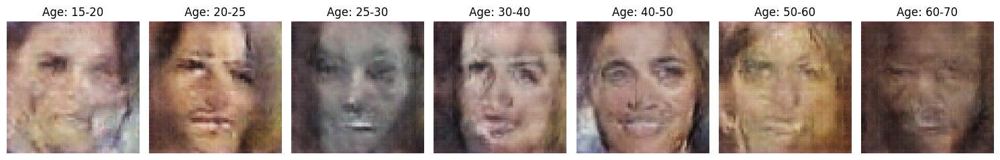

Saved checkpoint for epoch 82 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_82.pth
[Epoch 83/150] [Batch 1/79] [D loss: 0.15029600262641907] [G loss: 6.09541130065918]
[Epoch 83/150] [Batch 2/79] [D loss: 0.20289179682731628] [G loss: 5.277519226074219]
[Epoch 83/150] [Batch 3/79] [D loss: 0.10001742839813232] [G loss: 4.366430759429932]
[Epoch 83/150] [Batch 4/79] [D loss: 0.05891234800219536] [G loss: 4.0221452713012695]
[Epoch 83/150] [Batch 5/79] [D loss: 0.062751404941082] [G loss: 4.494384765625]
[Epoch 83/150] [Batch 6/79] [D loss: 0.06835626810789108] [G loss: 4.4910078048706055]
[Epoch 83/150] [Batch 7/79] [D loss: 0.09891226142644882] [G loss: 4.151758670806885]
[Epoch 83/150] [Batch 8/79] [D loss: 0.13054576516151428] [G loss: 4.182446479797363]
[Epoch 83/150] [Batch 9/79] [D loss: 0.0966482162475586] [G loss: 4.258869171142578]
[Epoch 83/150] [Batch 10/79] [D loss: 0.1126125156879425] [G loss: 3.9735236167907715]
[Epoch 83/150] [Batch 11/79]

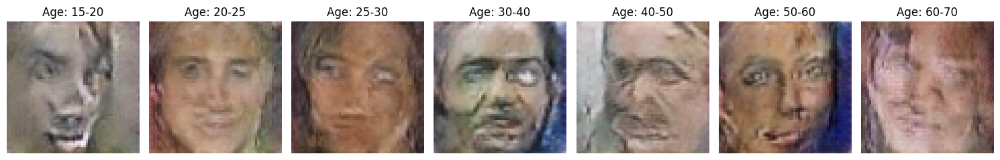

Saved checkpoint for epoch 83 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_83.pth
[Epoch 84/150] [Batch 1/79] [D loss: 0.048837464302778244] [G loss: 5.4564642906188965]
[Epoch 84/150] [Batch 2/79] [D loss: 0.01467874739319086] [G loss: 5.839576721191406]
[Epoch 84/150] [Batch 3/79] [D loss: 0.027914738282561302] [G loss: 4.765793800354004]
[Epoch 84/150] [Batch 4/79] [D loss: 0.015173673629760742] [G loss: 4.513060569763184]
[Epoch 84/150] [Batch 5/79] [D loss: 0.03704173117876053] [G loss: 5.182952880859375]
[Epoch 84/150] [Batch 6/79] [D loss: 0.01685420610010624] [G loss: 5.493289947509766]
[Epoch 84/150] [Batch 7/79] [D loss: 0.04740443080663681] [G loss: 3.733826160430908]
[Epoch 84/150] [Batch 8/79] [D loss: 0.009951437823474407] [G loss: 4.556307792663574]
[Epoch 84/150] [Batch 9/79] [D loss: 0.26503533124923706] [G loss: 10.273510932922363]
[Epoch 84/150] [Batch 10/79] [D loss: 2.171830177307129] [G loss: 8.754974365234375]
[Epoch 84/150] [Bat

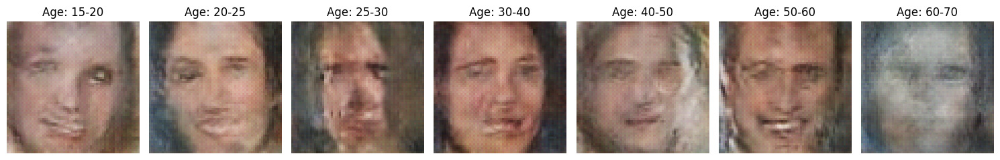

Saved checkpoint for epoch 84 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_84.pth
[Epoch 85/150] [Batch 1/79] [D loss: 0.2855848968029022] [G loss: 8.428750991821289]
[Epoch 85/150] [Batch 2/79] [D loss: 1.0314689874649048] [G loss: 6.50442361831665]
[Epoch 85/150] [Batch 3/79] [D loss: 0.1586001068353653] [G loss: 4.776279449462891]
[Epoch 85/150] [Batch 4/79] [D loss: 0.08429918438196182] [G loss: 4.151413917541504]
[Epoch 85/150] [Batch 5/79] [D loss: 0.06532544642686844] [G loss: 4.34240198135376]
[Epoch 85/150] [Batch 6/79] [D loss: 0.03548572584986687] [G loss: 4.405682563781738]
[Epoch 85/150] [Batch 7/79] [D loss: 0.05591137334704399] [G loss: 4.025485038757324]
[Epoch 85/150] [Batch 8/79] [D loss: 0.03915857523679733] [G loss: 4.3750200271606445]
[Epoch 85/150] [Batch 9/79] [D loss: 0.0461122989654541] [G loss: 4.164092063903809]
[Epoch 85/150] [Batch 10/79] [D loss: 0.06907214969396591] [G loss: 3.7919716835021973]
[Epoch 85/150] [Batch 11/79

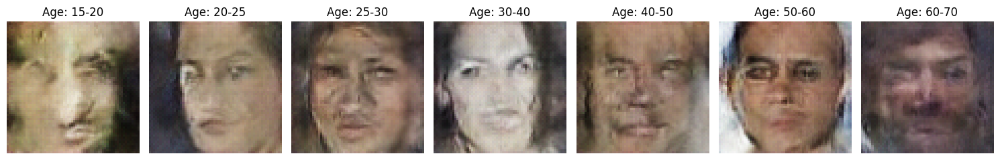

Saved checkpoint for epoch 85 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_85.pth
[Epoch 86/150] [Batch 1/79] [D loss: 0.04388834536075592] [G loss: 3.980041027069092]
[Epoch 86/150] [Batch 2/79] [D loss: 0.051471810787916183] [G loss: 4.2533745765686035]
[Epoch 86/150] [Batch 3/79] [D loss: 0.029026413336396217] [G loss: 4.37380313873291]
[Epoch 86/150] [Batch 4/79] [D loss: 0.07329660654067993] [G loss: 4.351449489593506]
[Epoch 86/150] [Batch 5/79] [D loss: 0.023069772869348526] [G loss: 4.367432117462158]
[Epoch 86/150] [Batch 6/79] [D loss: 0.029370293021202087] [G loss: 3.8796181678771973]
[Epoch 86/150] [Batch 7/79] [D loss: 0.044205453246831894] [G loss: 3.9561142921447754]
[Epoch 86/150] [Batch 8/79] [D loss: 0.028590140864253044] [G loss: 4.2397260665893555]
[Epoch 86/150] [Batch 9/79] [D loss: 0.04643009975552559] [G loss: 4.071592330932617]
[Epoch 86/150] [Batch 10/79] [D loss: 0.0221254862844944] [G loss: 4.124306678771973]
[Epoch 86/150] 

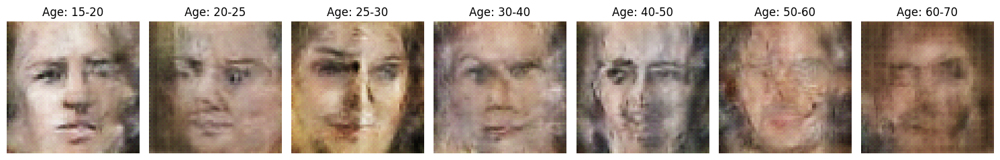

Saved checkpoint for epoch 86 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_86.pth
[Epoch 87/150] [Batch 1/79] [D loss: 0.04102489724755287] [G loss: 3.915968418121338]
[Epoch 87/150] [Batch 2/79] [D loss: 0.032736096531152725] [G loss: 4.153301239013672]
[Epoch 87/150] [Batch 3/79] [D loss: 0.032844457775354385] [G loss: 4.476445198059082]
[Epoch 87/150] [Batch 4/79] [D loss: 0.03205623850226402] [G loss: 4.776375770568848]
[Epoch 87/150] [Batch 5/79] [D loss: 0.057063989341259] [G loss: 3.8146116733551025]
[Epoch 87/150] [Batch 6/79] [D loss: 0.07763119041919708] [G loss: 4.859946250915527]
[Epoch 87/150] [Batch 7/79] [D loss: 0.05092298239469528] [G loss: 4.55003547668457]
[Epoch 87/150] [Batch 8/79] [D loss: 0.023114144802093506] [G loss: 4.3401007652282715]
[Epoch 87/150] [Batch 9/79] [D loss: 0.062492795288562775] [G loss: 4.743311405181885]
[Epoch 87/150] [Batch 10/79] [D loss: 0.05407285317778587] [G loss: 4.13051700592041]
[Epoch 87/150] [Batch

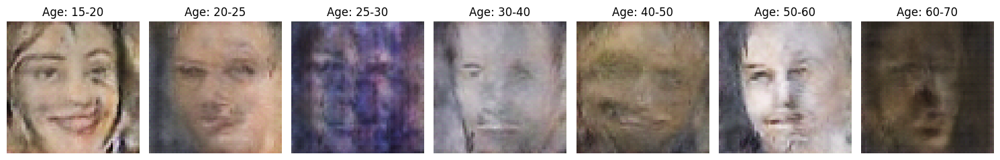

Saved checkpoint for epoch 87 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_87.pth
[Epoch 88/150] [Batch 1/79] [D loss: 0.09842652827501297] [G loss: 6.654898166656494]
[Epoch 88/150] [Batch 2/79] [D loss: 0.22602854669094086] [G loss: 5.200215816497803]
[Epoch 88/150] [Batch 3/79] [D loss: 0.012870713137090206] [G loss: 4.027379035949707]
[Epoch 88/150] [Batch 4/79] [D loss: 0.03990353271365166] [G loss: 4.8484787940979]
[Epoch 88/150] [Batch 5/79] [D loss: 0.015191388316452503] [G loss: 5.234604358673096]
[Epoch 88/150] [Batch 6/79] [D loss: 0.015687882900238037] [G loss: 5.195038795471191]
[Epoch 88/150] [Batch 7/79] [D loss: 0.018258070573210716] [G loss: 4.826048851013184]
[Epoch 88/150] [Batch 8/79] [D loss: 0.02854873426258564] [G loss: 4.791384220123291]
[Epoch 88/150] [Batch 9/79] [D loss: 0.04330841824412346] [G loss: 4.2387776374816895]
[Epoch 88/150] [Batch 10/79] [D loss: 0.03940054029226303] [G loss: 4.720424175262451]
[Epoch 88/150] [Batc

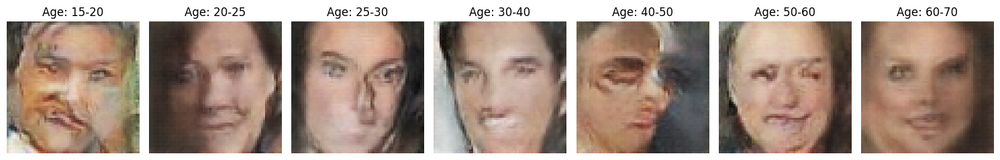

Saved checkpoint for epoch 88 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_88.pth
[Epoch 89/150] [Batch 1/79] [D loss: 0.018717600032687187] [G loss: 3.8017375469207764]
[Epoch 89/150] [Batch 2/79] [D loss: 0.05691784247756004] [G loss: 6.027956962585449]
[Epoch 89/150] [Batch 3/79] [D loss: 0.017133774235844612] [G loss: 5.929318428039551]
[Epoch 89/150] [Batch 4/79] [D loss: 0.0807759016752243] [G loss: 4.33785343170166]
[Epoch 89/150] [Batch 5/79] [D loss: 0.03785762935876846] [G loss: 4.885660171508789]
[Epoch 89/150] [Batch 6/79] [D loss: 0.01787545159459114] [G loss: 5.3516435623168945]
[Epoch 89/150] [Batch 7/79] [D loss: 0.01726866327226162] [G loss: 5.364495277404785]
[Epoch 89/150] [Batch 8/79] [D loss: 0.039339132606983185] [G loss: 5.190110206604004]
[Epoch 89/150] [Batch 9/79] [D loss: 0.04559538885951042] [G loss: 4.916288375854492]
[Epoch 89/150] [Batch 10/79] [D loss: 0.01360644306987524] [G loss: 4.779618263244629]
[Epoch 89/150] [Batc

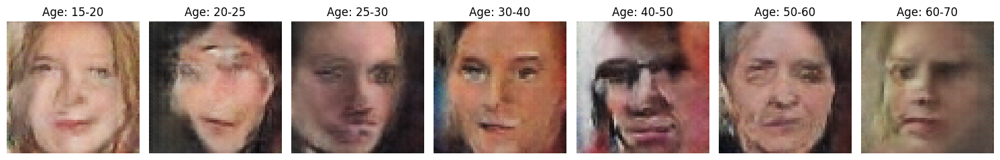

Saved checkpoint for epoch 89 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_89.pth
[Epoch 90/150] [Batch 1/79] [D loss: 0.11143624037504196] [G loss: 5.1464996337890625]
[Epoch 90/150] [Batch 2/79] [D loss: 0.10809645056724548] [G loss: 7.169560432434082]
[Epoch 90/150] [Batch 3/79] [D loss: 0.013347571715712547] [G loss: 7.1003313064575195]
[Epoch 90/150] [Batch 4/79] [D loss: 0.021348925307393074] [G loss: 6.095737934112549]
[Epoch 90/150] [Batch 5/79] [D loss: 0.06363709270954132] [G loss: 5.405102729797363]
[Epoch 90/150] [Batch 6/79] [D loss: 0.1090874895453453] [G loss: 6.539125919342041]
[Epoch 90/150] [Batch 7/79] [D loss: 0.05609612166881561] [G loss: 6.034233570098877]
[Epoch 90/150] [Batch 8/79] [D loss: 0.06040434539318085] [G loss: 4.72269344329834]
[Epoch 90/150] [Batch 9/79] [D loss: 0.05436293035745621] [G loss: 6.275357723236084]
[Epoch 90/150] [Batch 10/79] [D loss: 0.06709606945514679] [G loss: 5.44797420501709]
[Epoch 90/150] [Batch 

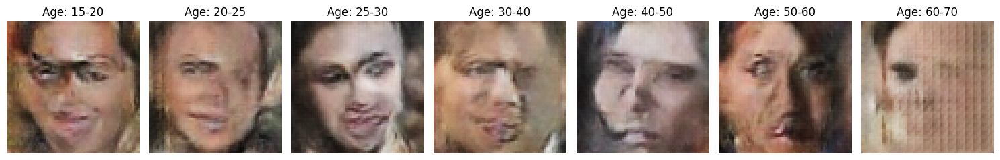

Saved checkpoint for epoch 90 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_90.pth
[Epoch 91/150] [Batch 1/79] [D loss: 0.043823614716529846] [G loss: 4.21928596496582]
[Epoch 91/150] [Batch 2/79] [D loss: 0.014506887644529343] [G loss: 4.606499195098877]
[Epoch 91/150] [Batch 3/79] [D loss: 0.041425369679927826] [G loss: 4.6846747398376465]
[Epoch 91/150] [Batch 4/79] [D loss: 0.032761137932538986] [G loss: 5.157046318054199]
[Epoch 91/150] [Batch 5/79] [D loss: 0.02264833264052868] [G loss: 5.608523368835449]
[Epoch 91/150] [Batch 6/79] [D loss: 0.034542858600616455] [G loss: 4.296047210693359]
[Epoch 91/150] [Batch 7/79] [D loss: 0.027233026921749115] [G loss: 4.327926158905029]
[Epoch 91/150] [Batch 8/79] [D loss: 0.038223929703235626] [G loss: 5.014308929443359]
[Epoch 91/150] [Batch 9/79] [D loss: 0.017003348097205162] [G loss: 5.356964111328125]
[Epoch 91/150] [Batch 10/79] [D loss: 0.06369471549987793] [G loss: 4.282498359680176]
[Epoch 91/150] 

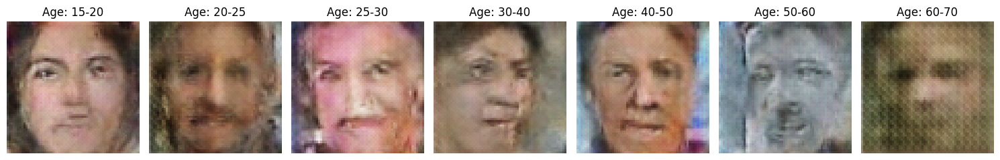

Saved checkpoint for epoch 91 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_91.pth
[Epoch 92/150] [Batch 1/79] [D loss: 0.02661919966340065] [G loss: 5.3892927169799805]
[Epoch 92/150] [Batch 2/79] [D loss: 0.02852017432451248] [G loss: 4.964027404785156]
[Epoch 92/150] [Batch 3/79] [D loss: 0.030155261978507042] [G loss: 5.035846710205078]
[Epoch 92/150] [Batch 4/79] [D loss: 0.027042513713240623] [G loss: 4.913280487060547]
[Epoch 92/150] [Batch 5/79] [D loss: 0.030139517039060593] [G loss: 5.099251747131348]
[Epoch 92/150] [Batch 6/79] [D loss: 0.035908278077840805] [G loss: 4.682470321655273]
[Epoch 92/150] [Batch 7/79] [D loss: 0.07966775447130203] [G loss: 5.410686016082764]
[Epoch 92/150] [Batch 8/79] [D loss: 0.0741502121090889] [G loss: 5.127734661102295]
[Epoch 92/150] [Batch 9/79] [D loss: 0.033127084374427795] [G loss: 4.216294288635254]
[Epoch 92/150] [Batch 10/79] [D loss: 0.035783641040325165] [G loss: 5.145196437835693]
[Epoch 92/150] [B

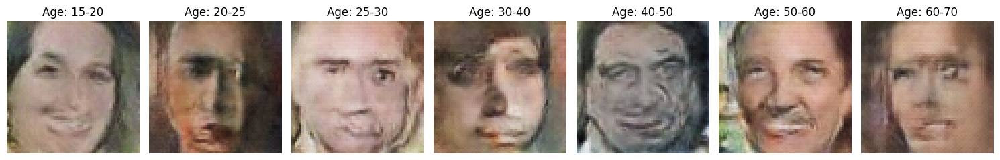

Saved checkpoint for epoch 92 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_92.pth
[Epoch 93/150] [Batch 1/79] [D loss: 0.3614617884159088] [G loss: 9.734058380126953]
[Epoch 93/150] [Batch 2/79] [D loss: 2.3948681354522705] [G loss: 8.797481536865234]
[Epoch 93/150] [Batch 3/79] [D loss: 0.8934254050254822] [G loss: 6.3720703125]
[Epoch 93/150] [Batch 4/79] [D loss: 0.00965788122266531] [G loss: 4.44009256362915]
[Epoch 93/150] [Batch 5/79] [D loss: 0.1157277375459671] [G loss: 6.247861862182617]
[Epoch 93/150] [Batch 6/79] [D loss: 0.032937608659267426] [G loss: 5.624329090118408]
[Epoch 93/150] [Batch 7/79] [D loss: 0.06069100275635719] [G loss: 5.149099349975586]
[Epoch 93/150] [Batch 8/79] [D loss: 0.080751933157444] [G loss: 4.095152854919434]
[Epoch 93/150] [Batch 9/79] [D loss: 0.09227544814348221] [G loss: 5.310548305511475]
[Epoch 93/150] [Batch 10/79] [D loss: 0.011984264478087425] [G loss: 5.8492279052734375]
[Epoch 93/150] [Batch 11/79] [D 

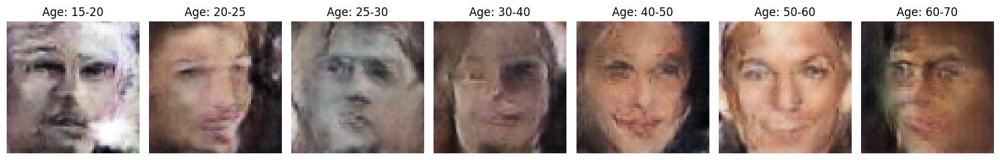

Saved checkpoint for epoch 93 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_93.pth
[Epoch 94/150] [Batch 1/79] [D loss: 0.6230422258377075] [G loss: 8.762702941894531]
[Epoch 94/150] [Batch 2/79] [D loss: 0.20536501705646515] [G loss: 8.615921020507812]
[Epoch 94/150] [Batch 3/79] [D loss: 0.04832366853952408] [G loss: 7.587811470031738]
[Epoch 94/150] [Batch 4/79] [D loss: 0.027307746931910515] [G loss: 7.089115619659424]
[Epoch 94/150] [Batch 5/79] [D loss: 0.05338100343942642] [G loss: 7.0517683029174805]
[Epoch 94/150] [Batch 6/79] [D loss: 0.04144613817334175] [G loss: 5.867946147918701]
[Epoch 94/150] [Batch 7/79] [D loss: 0.010432926937937737] [G loss: 6.581483364105225]
[Epoch 94/150] [Batch 8/79] [D loss: 0.018651504069566727] [G loss: 5.709324836730957]
[Epoch 94/150] [Batch 9/79] [D loss: 0.04561026766896248] [G loss: 5.458950996398926]
[Epoch 94/150] [Batch 10/79] [D loss: 0.03195035457611084] [G loss: 5.081122875213623]
[Epoch 94/150] [Batc

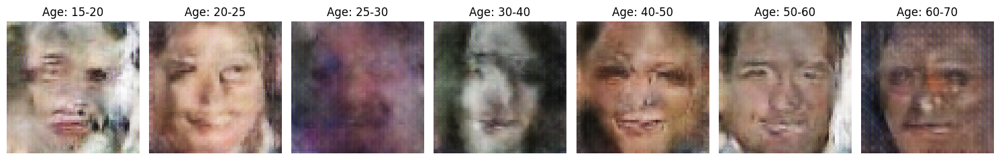

Saved checkpoint for epoch 94 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_94.pth
[Epoch 95/150] [Batch 1/79] [D loss: 0.035307422280311584] [G loss: 3.841993570327759]
[Epoch 95/150] [Batch 2/79] [D loss: 0.044064927846193314] [G loss: 4.75874137878418]
[Epoch 95/150] [Batch 3/79] [D loss: 0.024058872833848] [G loss: 5.174277305603027]
[Epoch 95/150] [Batch 4/79] [D loss: 0.04293908178806305] [G loss: 4.2352471351623535]
[Epoch 95/150] [Batch 5/79] [D loss: 0.03721088916063309] [G loss: 4.595684051513672]
[Epoch 95/150] [Batch 6/79] [D loss: 0.021654075011610985] [G loss: 4.589523792266846]
[Epoch 95/150] [Batch 7/79] [D loss: 0.026725057512521744] [G loss: 4.466480731964111]
[Epoch 95/150] [Batch 8/79] [D loss: 0.12063010782003403] [G loss: 5.307455062866211]
[Epoch 95/150] [Batch 9/79] [D loss: 0.13567030429840088] [G loss: 4.651217937469482]
[Epoch 95/150] [Batch 10/79] [D loss: 0.055014751851558685] [G loss: 3.9223852157592773]
[Epoch 95/150] [Bat

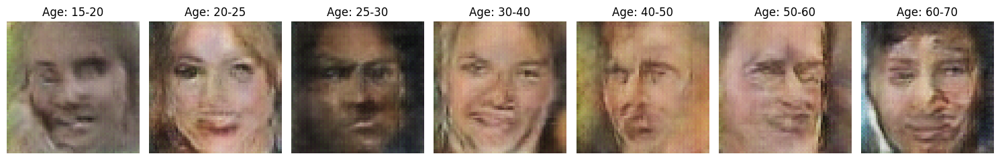

Saved checkpoint for epoch 95 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_95.pth
[Epoch 96/150] [Batch 1/79] [D loss: 0.05648013576865196] [G loss: 4.984137535095215]
[Epoch 96/150] [Batch 2/79] [D loss: 0.07558587193489075] [G loss: 5.106869697570801]
[Epoch 96/150] [Batch 3/79] [D loss: 0.04844933748245239] [G loss: 5.305461406707764]
[Epoch 96/150] [Batch 4/79] [D loss: 0.015504339709877968] [G loss: 4.523233413696289]
[Epoch 96/150] [Batch 5/79] [D loss: 0.046010322868824005] [G loss: 4.131346225738525]
[Epoch 96/150] [Batch 6/79] [D loss: 0.06512629240751266] [G loss: 4.653520584106445]
[Epoch 96/150] [Batch 7/79] [D loss: 0.055448729544878006] [G loss: 4.333998203277588]
[Epoch 96/150] [Batch 8/79] [D loss: 0.052633676677942276] [G loss: 4.128093719482422]
[Epoch 96/150] [Batch 9/79] [D loss: 0.05824653431773186] [G loss: 4.0583391189575195]
[Epoch 96/150] [Batch 10/79] [D loss: 0.09329885244369507] [G loss: 5.300443649291992]
[Epoch 96/150] [Ba

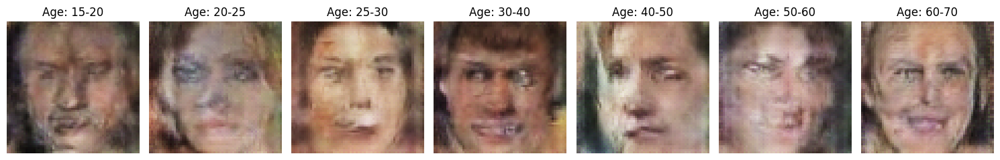

Saved checkpoint for epoch 96 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_96.pth
[Epoch 97/150] [Batch 1/79] [D loss: 0.041440460830926895] [G loss: 3.8037192821502686]
[Epoch 97/150] [Batch 2/79] [D loss: 0.05764412879943848] [G loss: 3.640796661376953]
[Epoch 97/150] [Batch 3/79] [D loss: 0.029284359887242317] [G loss: 4.003471374511719]
[Epoch 97/150] [Batch 4/79] [D loss: 0.01854575239121914] [G loss: 4.379301071166992]
[Epoch 97/150] [Batch 5/79] [D loss: 0.036066677421331406] [G loss: 3.7121293544769287]
[Epoch 97/150] [Batch 6/79] [D loss: 0.029906120151281357] [G loss: 4.00688362121582]
[Epoch 97/150] [Batch 7/79] [D loss: 0.03787499666213989] [G loss: 3.572695255279541]
[Epoch 97/150] [Batch 8/79] [D loss: 0.08552540093660355] [G loss: 3.586897134780884]
[Epoch 97/150] [Batch 9/79] [D loss: 0.08788447827100754] [G loss: 3.5657033920288086]
[Epoch 97/150] [Batch 10/79] [D loss: 0.08641865104436874] [G loss: 3.3243701457977295]
[Epoch 97/150] [

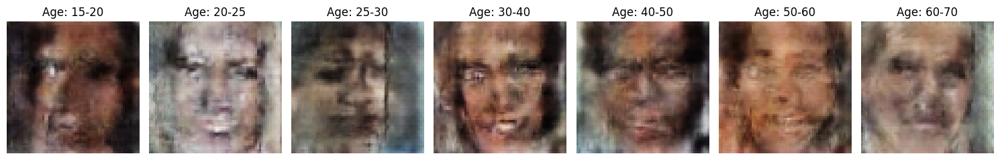

Saved checkpoint for epoch 97 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_97.pth
[Epoch 98/150] [Batch 1/79] [D loss: 0.11940810829401016] [G loss: 3.1304266452789307]
[Epoch 98/150] [Batch 2/79] [D loss: 0.12913252413272858] [G loss: 3.268277168273926]
[Epoch 98/150] [Batch 3/79] [D loss: 0.09442802518606186] [G loss: 3.3324179649353027]
[Epoch 98/150] [Batch 4/79] [D loss: 0.08481921255588531] [G loss: 3.3129210472106934]
[Epoch 98/150] [Batch 5/79] [D loss: 0.0781702771782875] [G loss: 3.345949172973633]
[Epoch 98/150] [Batch 6/79] [D loss: 0.13264445960521698] [G loss: 3.3095650672912598]
[Epoch 98/150] [Batch 7/79] [D loss: 0.09174594283103943] [G loss: 3.47859263420105]
[Epoch 98/150] [Batch 8/79] [D loss: 0.07985100895166397] [G loss: 3.4504830837249756]
[Epoch 98/150] [Batch 9/79] [D loss: 0.06496113538742065] [G loss: 3.5336713790893555]
[Epoch 98/150] [Batch 10/79] [D loss: 0.11494392156600952] [G loss: 3.285313844680786]
[Epoch 98/150] [Bat

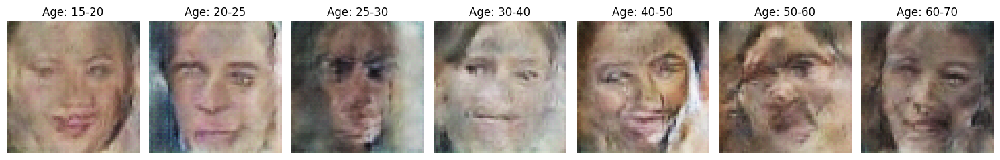

Saved checkpoint for epoch 98 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_98.pth
[Epoch 99/150] [Batch 1/79] [D loss: 0.2098294347524643] [G loss: 7.836803436279297]
[Epoch 99/150] [Batch 2/79] [D loss: 0.4854884147644043] [G loss: 6.71861457824707]
[Epoch 99/150] [Batch 3/79] [D loss: 0.016533352434635162] [G loss: 5.297920227050781]
[Epoch 99/150] [Batch 4/79] [D loss: 0.03291326388716698] [G loss: 4.908262729644775]
[Epoch 99/150] [Batch 5/79] [D loss: 0.0414990670979023] [G loss: 4.614463806152344]
[Epoch 99/150] [Batch 6/79] [D loss: 0.028889823704957962] [G loss: 4.4271979331970215]
[Epoch 99/150] [Batch 7/79] [D loss: 0.07529748976230621] [G loss: 5.141199588775635]
[Epoch 99/150] [Batch 8/79] [D loss: 0.031966857612133026] [G loss: 5.569234848022461]
[Epoch 99/150] [Batch 9/79] [D loss: 0.06990861892700195] [G loss: 4.655749797821045]
[Epoch 99/150] [Batch 10/79] [D loss: 0.11695358902215958] [G loss: 5.506718158721924]
[Epoch 99/150] [Batch 1

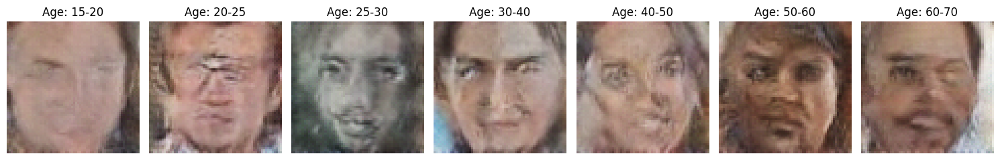

Saved checkpoint for epoch 99 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_99.pth
[Epoch 100/150] [Batch 1/79] [D loss: 0.08072751015424728] [G loss: 5.958489894866943]
[Epoch 100/150] [Batch 2/79] [D loss: 0.018567156046628952] [G loss: 5.613300323486328]
[Epoch 100/150] [Batch 3/79] [D loss: 0.07658691704273224] [G loss: 5.064024925231934]
[Epoch 100/150] [Batch 4/79] [D loss: 0.04933369159698486] [G loss: 4.178773403167725]
[Epoch 100/150] [Batch 5/79] [D loss: 0.024942433461546898] [G loss: 4.797900676727295]
[Epoch 100/150] [Batch 6/79] [D loss: 0.030438926070928574] [G loss: 4.75510311126709]
[Epoch 100/150] [Batch 7/79] [D loss: 0.015830153599381447] [G loss: 5.155941963195801]
[Epoch 100/150] [Batch 8/79] [D loss: 0.0459228940308094] [G loss: 4.021441459655762]
[Epoch 100/150] [Batch 9/79] [D loss: 0.04740513488650322] [G loss: 3.8361876010894775]
[Epoch 100/150] [Batch 10/79] [D loss: 0.04589635878801346] [G loss: 4.994470596313477]
[Epoch 100

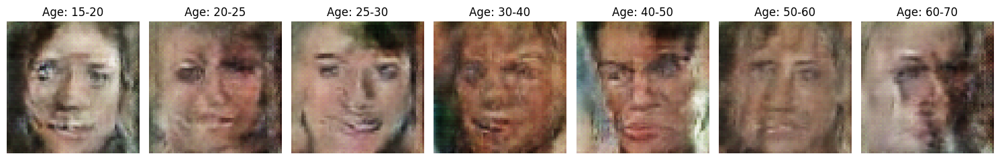

Saved checkpoint for epoch 100 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_100.pth
[Epoch 101/150] [Batch 1/79] [D loss: 0.03836677223443985] [G loss: 4.765633583068848]
[Epoch 101/150] [Batch 2/79] [D loss: 0.03399523347616196] [G loss: 4.494523525238037]
[Epoch 101/150] [Batch 3/79] [D loss: 0.08239991962909698] [G loss: 3.8943684101104736]
[Epoch 101/150] [Batch 4/79] [D loss: 0.20682117342948914] [G loss: 7.563122749328613]
[Epoch 101/150] [Batch 5/79] [D loss: 0.6126818656921387] [G loss: 5.391908168792725]
[Epoch 101/150] [Batch 6/79] [D loss: 0.03631196916103363] [G loss: 4.50555944442749]
[Epoch 101/150] [Batch 7/79] [D loss: 0.040952280163764954] [G loss: 5.100459575653076]
[Epoch 101/150] [Batch 8/79] [D loss: 0.06427685916423798] [G loss: 6.190767288208008]
[Epoch 101/150] [Batch 9/79] [D loss: 0.030347391963005066] [G loss: 6.1038665771484375]
[Epoch 101/150] [Batch 10/79] [D loss: 0.01592402718961239] [G loss: 5.518032073974609]
[Epoch 10

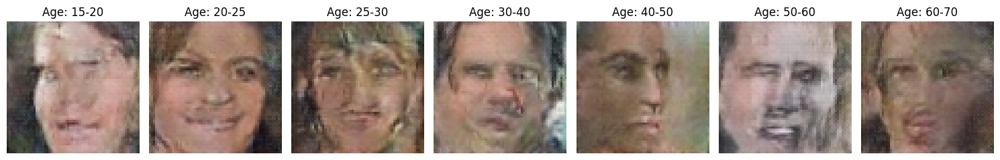

Saved checkpoint for epoch 101 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_101.pth
[Epoch 102/150] [Batch 1/79] [D loss: 0.04177863523364067] [G loss: 4.695039749145508]
[Epoch 102/150] [Batch 2/79] [D loss: 0.0411871075630188] [G loss: 5.063277244567871]
[Epoch 102/150] [Batch 3/79] [D loss: 0.045841120183467865] [G loss: 4.883391380310059]
[Epoch 102/150] [Batch 4/79] [D loss: 0.032660745084285736] [G loss: 4.9721221923828125]
[Epoch 102/150] [Batch 5/79] [D loss: 0.027878887951374054] [G loss: 4.718043804168701]
[Epoch 102/150] [Batch 6/79] [D loss: 0.03211132436990738] [G loss: 4.684994697570801]
[Epoch 102/150] [Batch 7/79] [D loss: 0.044842541217803955] [G loss: 5.797885417938232]
[Epoch 102/150] [Batch 8/79] [D loss: 0.0485968291759491] [G loss: 4.69268274307251]
[Epoch 102/150] [Batch 9/79] [D loss: 0.014249617233872414] [G loss: 4.986579895019531]
[Epoch 102/150] [Batch 10/79] [D loss: 0.045085687190294266] [G loss: 6.392850875854492]
[Epoch 

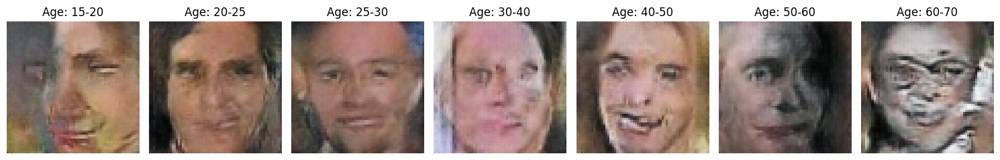

Saved checkpoint for epoch 102 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_102.pth
[Epoch 103/150] [Batch 1/79] [D loss: 0.06159842759370804] [G loss: 5.907539367675781]
[Epoch 103/150] [Batch 2/79] [D loss: 0.026691704988479614] [G loss: 5.757601737976074]
[Epoch 103/150] [Batch 3/79] [D loss: 0.14504742622375488] [G loss: 1.982338547706604]
[Epoch 103/150] [Batch 4/79] [D loss: 0.6130210161209106] [G loss: 11.34847640991211]
[Epoch 103/150] [Batch 5/79] [D loss: 2.4668991565704346] [G loss: 10.291263580322266]
[Epoch 103/150] [Batch 6/79] [D loss: 1.5852913856506348] [G loss: 8.283876419067383]
[Epoch 103/150] [Batch 7/79] [D loss: 0.42686644196510315] [G loss: 5.692173004150391]
[Epoch 103/150] [Batch 8/79] [D loss: 0.049954503774642944] [G loss: 3.8675761222839355]
[Epoch 103/150] [Batch 9/79] [D loss: 0.23062095046043396] [G loss: 6.005527496337891]
[Epoch 103/150] [Batch 10/79] [D loss: 0.020452136173844337] [G loss: 6.187594413757324]
[Epoch 10

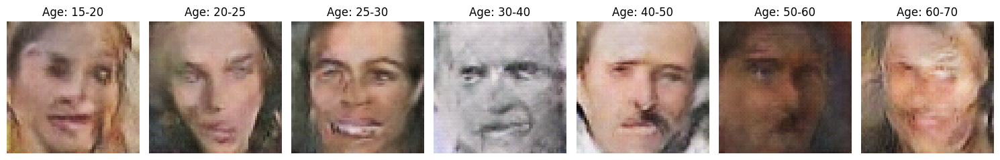

Saved checkpoint for epoch 103 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_103.pth
[Epoch 104/150] [Batch 1/79] [D loss: 0.037260256707668304] [G loss: 6.4198408126831055]
[Epoch 104/150] [Batch 2/79] [D loss: 0.018234647810459137] [G loss: 5.719429016113281]
[Epoch 104/150] [Batch 3/79] [D loss: 0.05211719125509262] [G loss: 4.6400041580200195]
[Epoch 104/150] [Batch 4/79] [D loss: 0.050427328795194626] [G loss: 5.992311477661133]
[Epoch 104/150] [Batch 5/79] [D loss: 0.02410396747291088] [G loss: 5.722522735595703]
[Epoch 104/150] [Batch 6/79] [D loss: 0.07156308740377426] [G loss: 4.8645734786987305]
[Epoch 104/150] [Batch 7/79] [D loss: 0.0802987664937973] [G loss: 6.34745454788208]
[Epoch 104/150] [Batch 8/79] [D loss: 0.030066844075918198] [G loss: 6.324522972106934]
[Epoch 104/150] [Batch 9/79] [D loss: 0.08270856738090515] [G loss: 3.6889705657958984]
[Epoch 104/150] [Batch 10/79] [D loss: 0.04889678955078125] [G loss: 5.240288257598877]
[Epoc

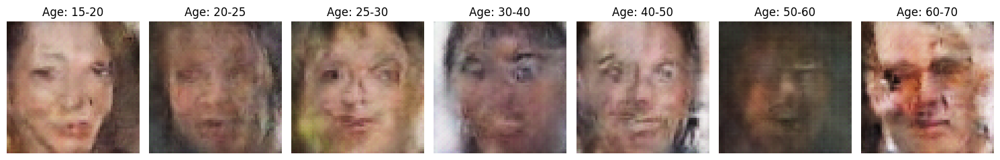

Saved checkpoint for epoch 104 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_104.pth
[Epoch 105/150] [Batch 1/79] [D loss: 0.12023355066776276] [G loss: 8.114352226257324]
[Epoch 105/150] [Batch 2/79] [D loss: 0.3674410879611969] [G loss: 4.473006248474121]
[Epoch 105/150] [Batch 3/79] [D loss: 0.07120683044195175] [G loss: 6.069923400878906]
[Epoch 105/150] [Batch 4/79] [D loss: 0.04964279383420944] [G loss: 5.534950256347656]
[Epoch 105/150] [Batch 5/79] [D loss: 0.11863203346729279] [G loss: 6.858348846435547]
[Epoch 105/150] [Batch 6/79] [D loss: 0.15884213149547577] [G loss: 4.922478199005127]
[Epoch 105/150] [Batch 7/79] [D loss: 0.06898560374975204] [G loss: 6.0583600997924805]
[Epoch 105/150] [Batch 8/79] [D loss: 0.011150915175676346] [G loss: 6.045823097229004]
[Epoch 105/150] [Batch 9/79] [D loss: 0.015895472839474678] [G loss: 5.448007106781006]
[Epoch 105/150] [Batch 10/79] [D loss: 0.030287714675068855] [G loss: 4.979499816894531]
[Epoch 1

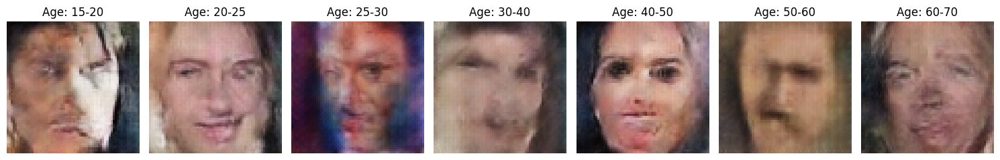

Saved checkpoint for epoch 105 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_105.pth
[Epoch 106/150] [Batch 1/79] [D loss: 0.21352195739746094] [G loss: 4.130980014801025]
[Epoch 106/150] [Batch 2/79] [D loss: 0.02877160720527172] [G loss: 4.721874237060547]
[Epoch 106/150] [Batch 3/79] [D loss: 0.007334338966757059] [G loss: 5.721136093139648]
[Epoch 106/150] [Batch 4/79] [D loss: 0.00774633651599288] [G loss: 5.021900177001953]
[Epoch 106/150] [Batch 5/79] [D loss: 0.034804876893758774] [G loss: 3.837892532348633]
[Epoch 106/150] [Batch 6/79] [D loss: 0.03393971174955368] [G loss: 3.9522550106048584]
[Epoch 106/150] [Batch 7/79] [D loss: 0.03664061427116394] [G loss: 3.930957078933716]
[Epoch 106/150] [Batch 8/79] [D loss: 0.05438268929719925] [G loss: 4.158031463623047]
[Epoch 106/150] [Batch 9/79] [D loss: 0.01737694814801216] [G loss: 4.7772417068481445]
[Epoch 106/150] [Batch 10/79] [D loss: 0.03501736745238304] [G loss: 4.089418888092041]
[Epoch 

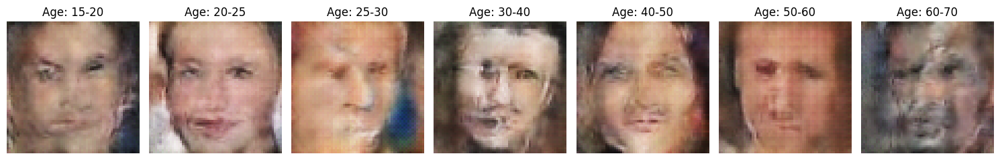

Saved checkpoint for epoch 106 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_106.pth
[Epoch 107/150] [Batch 1/79] [D loss: 0.1456165313720703] [G loss: 2.5878043174743652]
[Epoch 107/150] [Batch 2/79] [D loss: 0.1332564353942871] [G loss: 2.5957531929016113]
[Epoch 107/150] [Batch 3/79] [D loss: 0.11049646884202957] [G loss: 2.6777892112731934]
[Epoch 107/150] [Batch 4/79] [D loss: 0.1206938773393631] [G loss: 2.8071165084838867]
[Epoch 107/150] [Batch 5/79] [D loss: 0.0996970683336258] [G loss: 2.9979963302612305]
[Epoch 107/150] [Batch 6/79] [D loss: 0.12301557511091232] [G loss: 2.8384382724761963]
[Epoch 107/150] [Batch 7/79] [D loss: 0.1427132785320282] [G loss: 2.683234691619873]
[Epoch 107/150] [Batch 8/79] [D loss: 0.14210593700408936] [G loss: 2.687157154083252]
[Epoch 107/150] [Batch 9/79] [D loss: 0.12896201014518738] [G loss: 2.7973337173461914]
[Epoch 107/150] [Batch 10/79] [D loss: 0.10182041674852371] [G loss: 2.953404188156128]
[Epoch 10

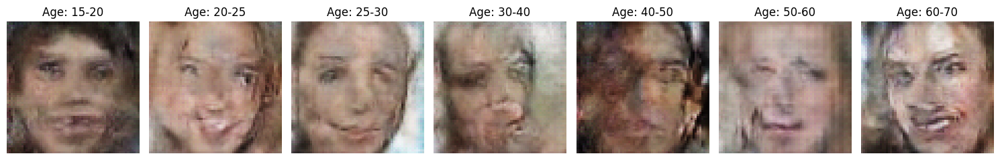

Saved checkpoint for epoch 107 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_107.pth
[Epoch 108/150] [Batch 1/79] [D loss: 0.040498483926057816] [G loss: 5.1290364265441895]
[Epoch 108/150] [Batch 2/79] [D loss: 0.038884468376636505] [G loss: 5.795808792114258]
[Epoch 108/150] [Batch 3/79] [D loss: 0.0694289430975914] [G loss: 4.904275417327881]
[Epoch 108/150] [Batch 4/79] [D loss: 0.04449017345905304] [G loss: 5.118968486785889]
[Epoch 108/150] [Batch 5/79] [D loss: 0.05835503339767456] [G loss: 5.3241071701049805]
[Epoch 108/150] [Batch 6/79] [D loss: 0.0584963858127594] [G loss: 4.227311134338379]
[Epoch 108/150] [Batch 7/79] [D loss: 0.03536705672740936] [G loss: 4.043275356292725]
[Epoch 108/150] [Batch 8/79] [D loss: 0.04704882577061653] [G loss: 4.431005477905273]
[Epoch 108/150] [Batch 9/79] [D loss: 0.12290304899215698] [G loss: 4.093639850616455]
[Epoch 108/150] [Batch 10/79] [D loss: 0.03379638493061066] [G loss: 4.440968990325928]
[Epoch 10

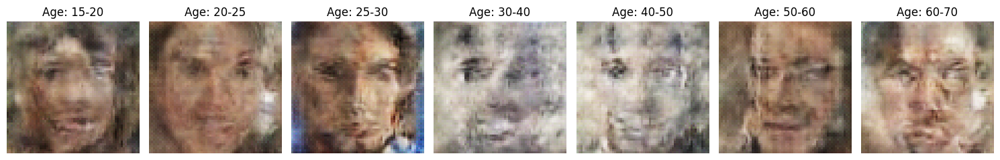

Saved checkpoint for epoch 108 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_108.pth
[Epoch 109/150] [Batch 1/79] [D loss: 0.08565826714038849] [G loss: 3.121626377105713]
[Epoch 109/150] [Batch 2/79] [D loss: 0.08477886021137238] [G loss: 3.127833366394043]
[Epoch 109/150] [Batch 3/79] [D loss: 0.08044025301933289] [G loss: 3.220470666885376]
[Epoch 109/150] [Batch 4/79] [D loss: 0.07429329305887222] [G loss: 3.3996806144714355]
[Epoch 109/150] [Batch 5/79] [D loss: 0.07831625640392303] [G loss: 3.36952543258667]
[Epoch 109/150] [Batch 6/79] [D loss: 0.0640115737915039] [G loss: 3.3390254974365234]
[Epoch 109/150] [Batch 7/79] [D loss: 0.08509466052055359] [G loss: 3.2798984050750732]
[Epoch 109/150] [Batch 8/79] [D loss: 0.08180776983499527] [G loss: 3.1289725303649902]
[Epoch 109/150] [Batch 9/79] [D loss: 0.0748586356639862] [G loss: 3.3286304473876953]
[Epoch 109/150] [Batch 10/79] [D loss: 0.07491540908813477] [G loss: 3.387399435043335]
[Epoch 10

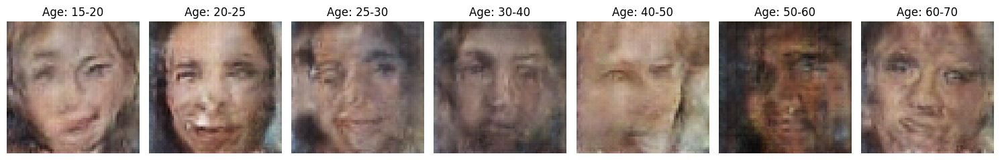

Saved checkpoint for epoch 109 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_109.pth
[Epoch 110/150] [Batch 1/79] [D loss: 0.05124073475599289] [G loss: 3.7777793407440186]
[Epoch 110/150] [Batch 2/79] [D loss: 0.14581294357776642] [G loss: 3.799154758453369]
[Epoch 110/150] [Batch 3/79] [D loss: 0.05889621004462242] [G loss: 4.258847713470459]
[Epoch 110/150] [Batch 4/79] [D loss: 0.0648278146982193] [G loss: 4.244325637817383]
[Epoch 110/150] [Batch 5/79] [D loss: 0.04871712997555733] [G loss: 4.042699813842773]
[Epoch 110/150] [Batch 6/79] [D loss: 0.10260287672281265] [G loss: 2.971316337585449]
[Epoch 110/150] [Batch 7/79] [D loss: 0.12443073093891144] [G loss: 4.870821475982666]
[Epoch 110/150] [Batch 8/79] [D loss: 0.1057637557387352] [G loss: 4.423934459686279]
[Epoch 110/150] [Batch 9/79] [D loss: 0.03899441659450531] [G loss: 3.8465943336486816]
[Epoch 110/150] [Batch 10/79] [D loss: 0.16068331897258759] [G loss: 5.575690746307373]
[Epoch 110/

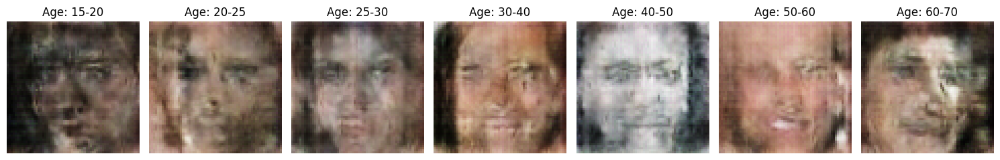

Saved checkpoint for epoch 110 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_110.pth
[Epoch 111/150] [Batch 1/79] [D loss: 0.20690320432186127] [G loss: 5.051348686218262]
[Epoch 111/150] [Batch 2/79] [D loss: 0.1731753945350647] [G loss: 4.777770042419434]
[Epoch 111/150] [Batch 3/79] [D loss: 0.1411924660205841] [G loss: 3.371046304702759]
[Epoch 111/150] [Batch 4/79] [D loss: 0.127704918384552] [G loss: 3.5813608169555664]
[Epoch 111/150] [Batch 5/79] [D loss: 0.06421328336000443] [G loss: 4.297101974487305]
[Epoch 111/150] [Batch 6/79] [D loss: 0.06717084348201752] [G loss: 3.9022574424743652]
[Epoch 111/150] [Batch 7/79] [D loss: 0.0768827572464943] [G loss: 3.54099702835083]
[Epoch 111/150] [Batch 8/79] [D loss: 0.10912826657295227] [G loss: 3.899354934692383]
[Epoch 111/150] [Batch 9/79] [D loss: 0.06979937851428986] [G loss: 4.003683567047119]
[Epoch 111/150] [Batch 10/79] [D loss: 0.07626426219940186] [G loss: 3.8782541751861572]
[Epoch 111/150

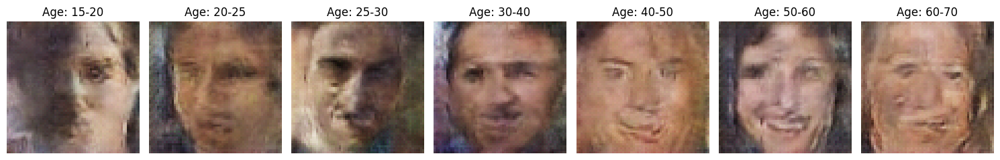

Saved checkpoint for epoch 111 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_111.pth
[Epoch 112/150] [Batch 1/79] [D loss: 0.10277577489614487] [G loss: 6.513959884643555]
[Epoch 112/150] [Batch 2/79] [D loss: 0.09615851938724518] [G loss: 5.982365131378174]
[Epoch 112/150] [Batch 3/79] [D loss: 0.04860936105251312] [G loss: 4.6900529861450195]
[Epoch 112/150] [Batch 4/79] [D loss: 0.04177462309598923] [G loss: 4.4534173011779785]
[Epoch 112/150] [Batch 5/79] [D loss: 0.034246861934661865] [G loss: 4.991535186767578]
[Epoch 112/150] [Batch 6/79] [D loss: 0.03328881412744522] [G loss: 5.144996643066406]
[Epoch 112/150] [Batch 7/79] [D loss: 0.06535361707210541] [G loss: 4.488447666168213]
[Epoch 112/150] [Batch 8/79] [D loss: 0.08551308512687683] [G loss: 6.620473861694336]
[Epoch 112/150] [Batch 9/79] [D loss: 0.18776525557041168] [G loss: 4.793487548828125]
[Epoch 112/150] [Batch 10/79] [D loss: 0.10165286064147949] [G loss: 6.270570278167725]
[Epoch 1

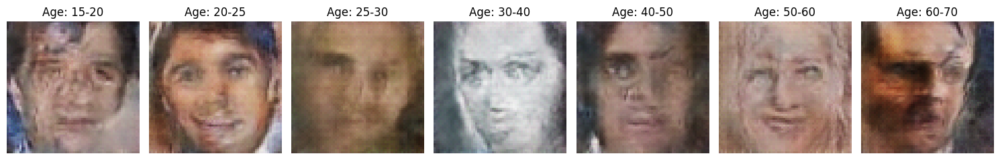

Saved checkpoint for epoch 112 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_112.pth
[Epoch 113/150] [Batch 1/79] [D loss: 0.17704737186431885] [G loss: 4.4766621589660645]
[Epoch 113/150] [Batch 2/79] [D loss: 0.058927372097969055] [G loss: 4.471227645874023]
[Epoch 113/150] [Batch 3/79] [D loss: 0.026636458933353424] [G loss: 4.487418174743652]
[Epoch 113/150] [Batch 4/79] [D loss: 0.08500570058822632] [G loss: 4.2027130126953125]
[Epoch 113/150] [Batch 5/79] [D loss: 0.04903428629040718] [G loss: 4.445291519165039]
[Epoch 113/150] [Batch 6/79] [D loss: 0.08406555652618408] [G loss: 4.32247257232666]
[Epoch 113/150] [Batch 7/79] [D loss: 0.06371530890464783] [G loss: 4.440871238708496]
[Epoch 113/150] [Batch 8/79] [D loss: 0.07136306911706924] [G loss: 4.151552677154541]
[Epoch 113/150] [Batch 9/79] [D loss: 0.06029742583632469] [G loss: 4.381505966186523]
[Epoch 113/150] [Batch 10/79] [D loss: 0.03750433772802353] [G loss: 4.47393274307251]
[Epoch 11

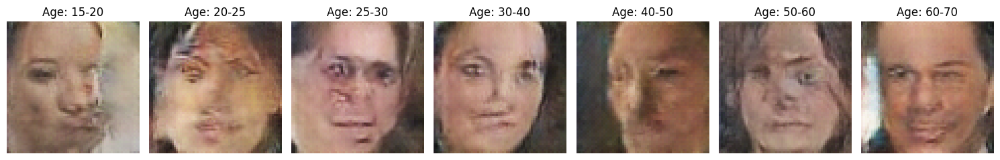

Saved checkpoint for epoch 113 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_113.pth
[Epoch 114/150] [Batch 1/79] [D loss: 0.007611590437591076] [G loss: 7.238864898681641]
[Epoch 114/150] [Batch 2/79] [D loss: 0.015987956896424294] [G loss: 5.637754440307617]
[Epoch 114/150] [Batch 3/79] [D loss: 0.015790114179253578] [G loss: 5.195825576782227]
[Epoch 114/150] [Batch 4/79] [D loss: 0.02633647248148918] [G loss: 4.936254501342773]
[Epoch 114/150] [Batch 5/79] [D loss: 0.03972289711236954] [G loss: 4.59388542175293]
[Epoch 114/150] [Batch 6/79] [D loss: 0.026009973138570786] [G loss: 5.190215110778809]
[Epoch 114/150] [Batch 7/79] [D loss: 0.03742450103163719] [G loss: 5.297985076904297]
[Epoch 114/150] [Batch 8/79] [D loss: 0.10685835778713226] [G loss: 2.7926878929138184]
[Epoch 114/150] [Batch 9/79] [D loss: 0.11508146673440933] [G loss: 7.50752067565918]
[Epoch 114/150] [Batch 10/79] [D loss: 0.2774274945259094] [G loss: 4.702491760253906]
[Epoch 11

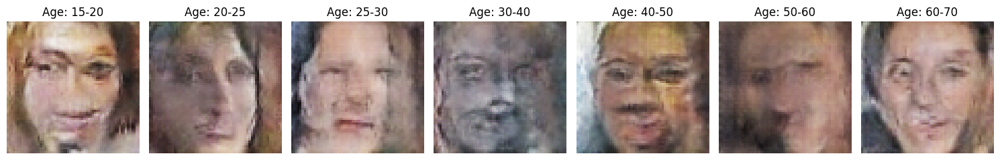

Saved checkpoint for epoch 114 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_114.pth
[Epoch 115/150] [Batch 1/79] [D loss: 0.038200944662094116] [G loss: 4.635010719299316]
[Epoch 115/150] [Batch 2/79] [D loss: 0.03632289543747902] [G loss: 4.96964168548584]
[Epoch 115/150] [Batch 3/79] [D loss: 0.02847709320485592] [G loss: 4.96568489074707]
[Epoch 115/150] [Batch 4/79] [D loss: 0.01934709958732128] [G loss: 4.9159979820251465]
[Epoch 115/150] [Batch 5/79] [D loss: 0.08389108628034592] [G loss: 5.0410871505737305]
[Epoch 115/150] [Batch 6/79] [D loss: 0.10375409573316574] [G loss: 4.728931427001953]
[Epoch 115/150] [Batch 7/79] [D loss: 0.048316363245248795] [G loss: 4.4473772048950195]
[Epoch 115/150] [Batch 8/79] [D loss: 0.027099817991256714] [G loss: 4.863498210906982]
[Epoch 115/150] [Batch 9/79] [D loss: 0.06545814871788025] [G loss: 5.1115827560424805]
[Epoch 115/150] [Batch 10/79] [D loss: 0.057072319090366364] [G loss: 4.928564071655273]
[Epoc

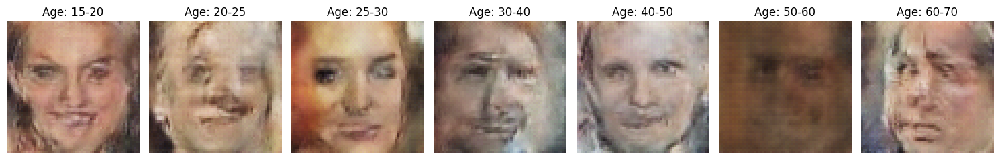

Saved checkpoint for epoch 115 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_115.pth
[Epoch 116/150] [Batch 1/79] [D loss: 0.10712526738643646] [G loss: 6.807226657867432]
[Epoch 116/150] [Batch 2/79] [D loss: 0.07150238752365112] [G loss: 5.994393348693848]
[Epoch 116/150] [Batch 3/79] [D loss: 0.060029543936252594] [G loss: 5.0033488273620605]
[Epoch 116/150] [Batch 4/79] [D loss: 0.03692029044032097] [G loss: 4.562008857727051]
[Epoch 116/150] [Batch 5/79] [D loss: 0.029976988211274147] [G loss: 5.037402629852295]
[Epoch 116/150] [Batch 6/79] [D loss: 0.03380182385444641] [G loss: 5.576586723327637]
[Epoch 116/150] [Batch 7/79] [D loss: 0.04391542449593544] [G loss: 5.243192672729492]
[Epoch 116/150] [Batch 8/79] [D loss: 0.10799332708120346] [G loss: 3.1345229148864746]
[Epoch 116/150] [Batch 9/79] [D loss: 0.4054774045944214] [G loss: 10.40467357635498]
[Epoch 116/150] [Batch 10/79] [D loss: 1.7752039432525635] [G loss: 7.730733394622803]
[Epoch 11

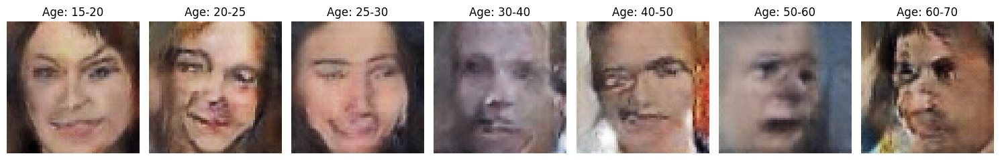

Saved checkpoint for epoch 116 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_116.pth
[Epoch 117/150] [Batch 1/79] [D loss: 0.02303544618189335] [G loss: 4.81253719329834]
[Epoch 117/150] [Batch 2/79] [D loss: 0.037134453654289246] [G loss: 5.934340953826904]
[Epoch 117/150] [Batch 3/79] [D loss: 0.02898278646171093] [G loss: 5.513142108917236]
[Epoch 117/150] [Batch 4/79] [D loss: 0.05668260157108307] [G loss: 3.919553756713867]
[Epoch 117/150] [Batch 5/79] [D loss: 0.053574807941913605] [G loss: 3.8833091259002686]
[Epoch 117/150] [Batch 6/79] [D loss: 0.03302784264087677] [G loss: 6.0042524337768555]
[Epoch 117/150] [Batch 7/79] [D loss: 0.02800392545759678] [G loss: 5.584659576416016]
[Epoch 117/150] [Batch 8/79] [D loss: 0.03361491486430168] [G loss: 4.93155574798584]
[Epoch 117/150] [Batch 9/79] [D loss: 0.034747764468193054] [G loss: 5.7444167137146]
[Epoch 117/150] [Batch 10/79] [D loss: 0.017285745590925217] [G loss: 5.589387893676758]
[Epoch 11

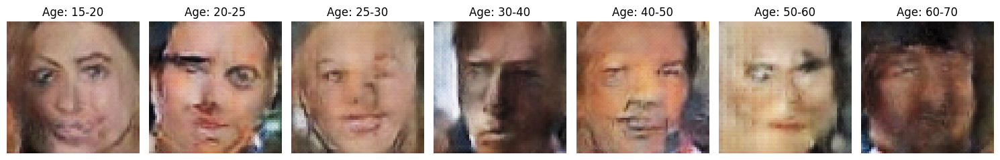

Saved checkpoint for epoch 117 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_117.pth
[Epoch 118/150] [Batch 1/79] [D loss: 0.035933755338191986] [G loss: 6.500980377197266]
[Epoch 118/150] [Batch 2/79] [D loss: 0.021064672619104385] [G loss: 6.329735279083252]
[Epoch 118/150] [Batch 3/79] [D loss: 0.037365466356277466] [G loss: 5.985302925109863]
[Epoch 118/150] [Batch 4/79] [D loss: 0.020825909450650215] [G loss: 5.802098751068115]
[Epoch 118/150] [Batch 5/79] [D loss: 0.014857928268611431] [G loss: 5.635985374450684]
[Epoch 118/150] [Batch 6/79] [D loss: 0.1118876188993454] [G loss: 3.5730440616607666]
[Epoch 118/150] [Batch 7/79] [D loss: 0.06108149513602257] [G loss: 7.019577980041504]
[Epoch 118/150] [Batch 8/79] [D loss: 0.01666516624391079] [G loss: 7.128812789916992]
[Epoch 118/150] [Batch 9/79] [D loss: 0.02161175198853016] [G loss: 5.7095627784729]
[Epoch 118/150] [Batch 10/79] [D loss: 0.0392017662525177] [G loss: 4.915777206420898]
[Epoch 11

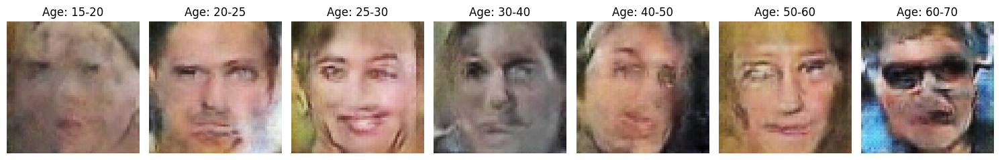

Saved checkpoint for epoch 118 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_118.pth
[Epoch 119/150] [Batch 1/79] [D loss: 0.15228459239006042] [G loss: 8.257140159606934]
[Epoch 119/150] [Batch 2/79] [D loss: 0.07917530089616776] [G loss: 8.903038024902344]
[Epoch 119/150] [Batch 3/79] [D loss: 0.02307504042983055] [G loss: 8.55357551574707]
[Epoch 119/150] [Batch 4/79] [D loss: 0.03246043249964714] [G loss: 7.356365203857422]
[Epoch 119/150] [Batch 5/79] [D loss: 0.025054100900888443] [G loss: 5.925244331359863]
[Epoch 119/150] [Batch 6/79] [D loss: 0.024425068870186806] [G loss: 5.212571144104004]
[Epoch 119/150] [Batch 7/79] [D loss: 0.027530744671821594] [G loss: 5.106003284454346]
[Epoch 119/150] [Batch 8/79] [D loss: 0.01628919318318367] [G loss: 5.290049076080322]
[Epoch 119/150] [Batch 9/79] [D loss: 0.02134072780609131] [G loss: 4.909178256988525]
[Epoch 119/150] [Batch 10/79] [D loss: 0.031718362122774124] [G loss: 4.649127006530762]
[Epoch 1

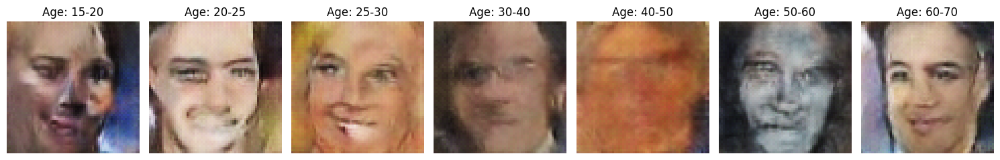

Saved checkpoint for epoch 119 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_119.pth
[Epoch 120/150] [Batch 1/79] [D loss: 0.041607171297073364] [G loss: 6.472232341766357]
[Epoch 120/150] [Batch 2/79] [D loss: 0.0661059319972992] [G loss: 4.950095176696777]
[Epoch 120/150] [Batch 3/79] [D loss: 0.015388410538434982] [G loss: 4.983035087585449]
[Epoch 120/150] [Batch 4/79] [D loss: 0.1127590760588646] [G loss: 8.680082321166992]
[Epoch 120/150] [Batch 5/79] [D loss: 0.2570283114910126] [G loss: 7.042214393615723]
[Epoch 120/150] [Batch 6/79] [D loss: 0.01227077841758728] [G loss: 4.828034400939941]
[Epoch 120/150] [Batch 7/79] [D loss: 0.09825024008750916] [G loss: 8.179862976074219]
[Epoch 120/150] [Batch 8/79] [D loss: 0.154215469956398] [G loss: 7.610258102416992]
[Epoch 120/150] [Batch 9/79] [D loss: 0.007092127576470375] [G loss: 6.479022979736328]
[Epoch 120/150] [Batch 10/79] [D loss: 0.03881441056728363] [G loss: 6.412019729614258]
[Epoch 120/15

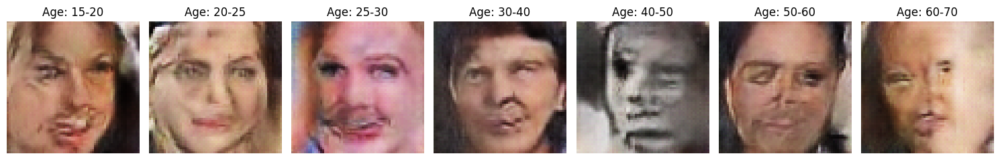

Saved checkpoint for epoch 120 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_120.pth
[Epoch 121/150] [Batch 1/79] [D loss: 0.0280066579580307] [G loss: 5.614282608032227]
[Epoch 121/150] [Batch 2/79] [D loss: 0.019934404641389847] [G loss: 6.105266571044922]
[Epoch 121/150] [Batch 3/79] [D loss: 0.0487317256629467] [G loss: 5.471772193908691]
[Epoch 121/150] [Batch 4/79] [D loss: 0.015015563927590847] [G loss: 5.767361640930176]
[Epoch 121/150] [Batch 5/79] [D loss: 0.017915241420269012] [G loss: 4.795419216156006]
[Epoch 121/150] [Batch 6/79] [D loss: 0.05954892188310623] [G loss: 5.394401550292969]
[Epoch 121/150] [Batch 7/79] [D loss: 0.05628466606140137] [G loss: 4.89682674407959]
[Epoch 121/150] [Batch 8/79] [D loss: 0.0585140660405159] [G loss: 4.958848476409912]
[Epoch 121/150] [Batch 9/79] [D loss: 0.01645534858107567] [G loss: 5.580026149749756]
[Epoch 121/150] [Batch 10/79] [D loss: 0.04198040813207626] [G loss: 4.5068511962890625]
[Epoch 121/

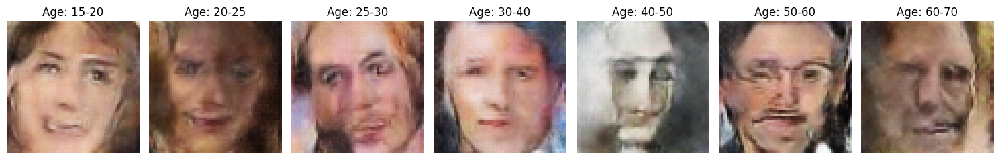

Saved checkpoint for epoch 121 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_121.pth
[Epoch 122/150] [Batch 1/79] [D loss: 0.008656477555632591] [G loss: 6.391582489013672]
[Epoch 122/150] [Batch 2/79] [D loss: 0.01316038053482771] [G loss: 5.502900123596191]
[Epoch 122/150] [Batch 3/79] [D loss: 0.013537825085222721] [G loss: 5.138949871063232]
[Epoch 122/150] [Batch 4/79] [D loss: 0.037649091333150864] [G loss: 4.8680100440979]
[Epoch 122/150] [Batch 5/79] [D loss: 0.0193340927362442] [G loss: 5.12264347076416]
[Epoch 122/150] [Batch 6/79] [D loss: 0.03938809037208557] [G loss: 4.646517276763916]
[Epoch 122/150] [Batch 7/79] [D loss: 0.10233378410339355] [G loss: 4.253054618835449]
[Epoch 122/150] [Batch 8/79] [D loss: 0.04219701141119003] [G loss: 4.563289642333984]
[Epoch 122/150] [Batch 9/79] [D loss: 0.06119410693645477] [G loss: 4.309795379638672]
[Epoch 122/150] [Batch 10/79] [D loss: 0.032053206115961075] [G loss: 4.488293647766113]
[Epoch 122/

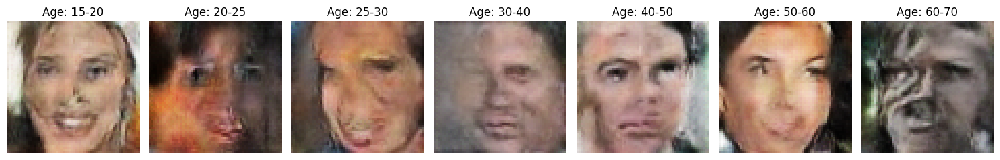

Saved checkpoint for epoch 122 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_122.pth
[Epoch 123/150] [Batch 1/79] [D loss: 0.02208264172077179] [G loss: 6.575510025024414]
[Epoch 123/150] [Batch 2/79] [D loss: 0.023076104000210762] [G loss: 5.544968128204346]
[Epoch 123/150] [Batch 3/79] [D loss: 0.01580764539539814] [G loss: 5.471898078918457]
[Epoch 123/150] [Batch 4/79] [D loss: 0.03430670499801636] [G loss: 5.267509937286377]
[Epoch 123/150] [Batch 5/79] [D loss: 0.07435383647680283] [G loss: 3.0900139808654785]
[Epoch 123/150] [Batch 6/79] [D loss: 0.09601245075464249] [G loss: 7.9829607009887695]
[Epoch 123/150] [Batch 7/79] [D loss: 0.039547473192214966] [G loss: 7.781689643859863]
[Epoch 123/150] [Batch 8/79] [D loss: 0.039454199373722076] [G loss: 7.784470558166504]
[Epoch 123/150] [Batch 9/79] [D loss: 0.02534470520913601] [G loss: 6.464301586151123]
[Epoch 123/150] [Batch 10/79] [D loss: 0.04191311448812485] [G loss: 7.3958740234375]
[Epoch 1

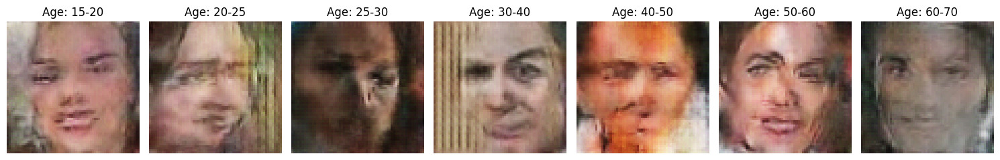

Saved checkpoint for epoch 123 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_123.pth
[Epoch 124/150] [Batch 1/79] [D loss: 0.009696144610643387] [G loss: 5.680134296417236]
[Epoch 124/150] [Batch 2/79] [D loss: 0.027277497574687004] [G loss: 6.405874252319336]
[Epoch 124/150] [Batch 3/79] [D loss: 0.006368373520672321] [G loss: 6.774155616760254]
[Epoch 124/150] [Batch 4/79] [D loss: 0.0194377601146698] [G loss: 6.066557884216309]
[Epoch 124/150] [Batch 5/79] [D loss: 0.012835131958127022] [G loss: 6.87359619140625]
[Epoch 124/150] [Batch 6/79] [D loss: 0.013017278164625168] [G loss: 6.3921709060668945]
[Epoch 124/150] [Batch 7/79] [D loss: 0.011371596716344357] [G loss: 5.8864617347717285]
[Epoch 124/150] [Batch 8/79] [D loss: 0.013061579316854477] [G loss: 5.907598972320557]
[Epoch 124/150] [Batch 9/79] [D loss: 0.04459162428975105] [G loss: 4.5967559814453125]
[Epoch 124/150] [Batch 10/79] [D loss: 0.10536888986825943] [G loss: 8.225030899047852]
[Ep

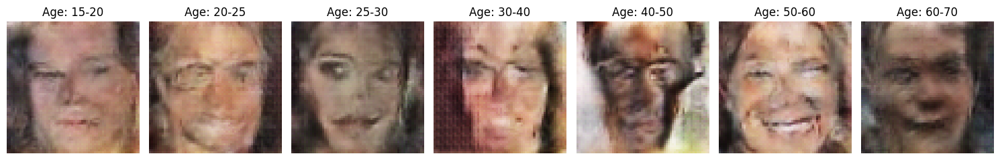

Saved checkpoint for epoch 124 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_124.pth
[Epoch 125/150] [Batch 1/79] [D loss: 0.039149679243564606] [G loss: 4.564764976501465]
[Epoch 125/150] [Batch 2/79] [D loss: 0.03173321485519409] [G loss: 4.597998142242432]
[Epoch 125/150] [Batch 3/79] [D loss: 0.03975008428096771] [G loss: 4.465081214904785]
[Epoch 125/150] [Batch 4/79] [D loss: 0.02861490286886692] [G loss: 5.061251163482666]
[Epoch 125/150] [Batch 5/79] [D loss: 0.020900219678878784] [G loss: 5.061587333679199]
[Epoch 125/150] [Batch 6/79] [D loss: 0.028483323752880096] [G loss: 4.644577980041504]
[Epoch 125/150] [Batch 7/79] [D loss: 0.02567923069000244] [G loss: 4.569184303283691]
[Epoch 125/150] [Batch 8/79] [D loss: 0.05146590620279312] [G loss: 4.1186981201171875]
[Epoch 125/150] [Batch 9/79] [D loss: 0.07121393084526062] [G loss: 5.771607398986816]
[Epoch 125/150] [Batch 10/79] [D loss: 0.03619297593832016] [G loss: 5.712005615234375]
[Epoch 

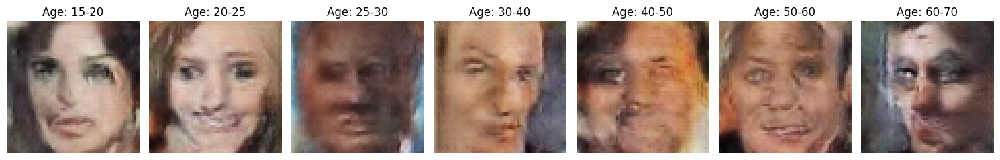

Saved checkpoint for epoch 125 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_125.pth
[Epoch 126/150] [Batch 1/79] [D loss: 0.09146318584680557] [G loss: 4.073195934295654]
[Epoch 126/150] [Batch 2/79] [D loss: 0.11309308558702469] [G loss: 4.044483184814453]
[Epoch 126/150] [Batch 3/79] [D loss: 0.02901674620807171] [G loss: 4.409238815307617]
[Epoch 126/150] [Batch 4/79] [D loss: 0.04479716345667839] [G loss: 4.411330223083496]
[Epoch 126/150] [Batch 5/79] [D loss: 0.025950461626052856] [G loss: 4.526091575622559]
[Epoch 126/150] [Batch 6/79] [D loss: 0.024035219103097916] [G loss: 4.4151291847229]
[Epoch 126/150] [Batch 7/79] [D loss: 0.032226212322711945] [G loss: 4.037794589996338]
[Epoch 126/150] [Batch 8/79] [D loss: 0.021718371659517288] [G loss: 4.580828666687012]
[Epoch 126/150] [Batch 9/79] [D loss: 0.028114138171076775] [G loss: 3.9909310340881348]
[Epoch 126/150] [Batch 10/79] [D loss: 0.037806008011102676] [G loss: 3.8326399326324463]
[Epoc

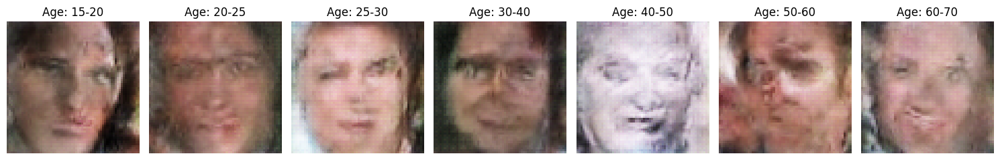

Saved checkpoint for epoch 126 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_126.pth
[Epoch 127/150] [Batch 1/79] [D loss: 0.05005719140172005] [G loss: 5.105864524841309]
[Epoch 127/150] [Batch 2/79] [D loss: 0.017404012382030487] [G loss: 5.342185020446777]
[Epoch 127/150] [Batch 3/79] [D loss: 0.024339741095900536] [G loss: 5.0131635665893555]
[Epoch 127/150] [Batch 4/79] [D loss: 0.08502233773469925] [G loss: 3.326004981994629]
[Epoch 127/150] [Batch 5/79] [D loss: 0.06938062608242035] [G loss: 4.842602729797363]
[Epoch 127/150] [Batch 6/79] [D loss: 0.0278038177639246] [G loss: 5.007658004760742]
[Epoch 127/150] [Batch 7/79] [D loss: 0.019973760470747948] [G loss: 4.700956344604492]
[Epoch 127/150] [Batch 8/79] [D loss: 0.03712068498134613] [G loss: 4.753817558288574]
[Epoch 127/150] [Batch 9/79] [D loss: 0.07403100281953812] [G loss: 3.267382860183716]
[Epoch 127/150] [Batch 10/79] [D loss: 0.11105840653181076] [G loss: 6.534846305847168]
[Epoch 1

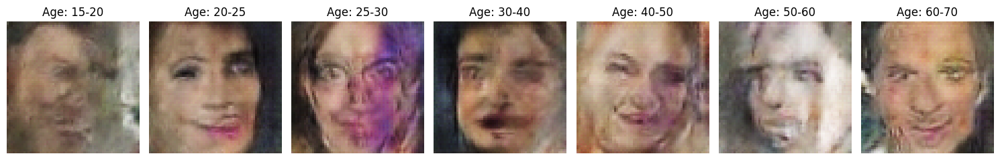

Saved checkpoint for epoch 127 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_127.pth
[Epoch 128/150] [Batch 1/79] [D loss: 0.06053360551595688] [G loss: 3.400268077850342]
[Epoch 128/150] [Batch 2/79] [D loss: 0.06680528819561005] [G loss: 3.6791982650756836]
[Epoch 128/150] [Batch 3/79] [D loss: 0.07344628870487213] [G loss: 3.6719768047332764]
[Epoch 128/150] [Batch 4/79] [D loss: 0.07822733372449875] [G loss: 3.74369478225708]
[Epoch 128/150] [Batch 5/79] [D loss: 0.0476052388548851] [G loss: 3.73331880569458]
[Epoch 128/150] [Batch 6/79] [D loss: 0.091196209192276] [G loss: 3.571072816848755]
[Epoch 128/150] [Batch 7/79] [D loss: 0.07785598933696747] [G loss: 3.7647793292999268]
[Epoch 128/150] [Batch 8/79] [D loss: 0.08739002048969269] [G loss: 3.9463634490966797]
[Epoch 128/150] [Batch 9/79] [D loss: 0.04693114757537842] [G loss: 4.016822338104248]
[Epoch 128/150] [Batch 10/79] [D loss: 0.03712188079953194] [G loss: 3.925614833831787]
[Epoch 128/1

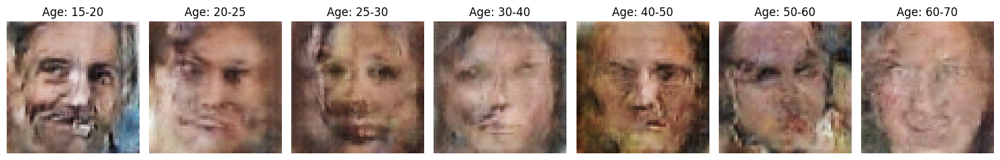

Saved checkpoint for epoch 128 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_128.pth
[Epoch 129/150] [Batch 1/79] [D loss: 0.04885079711675644] [G loss: 3.9028067588806152]
[Epoch 129/150] [Batch 2/79] [D loss: 0.058811087161302567] [G loss: 3.365677833557129]
[Epoch 129/150] [Batch 3/79] [D loss: 0.04048337787389755] [G loss: 3.6447272300720215]
[Epoch 129/150] [Batch 4/79] [D loss: 0.024876315146684647] [G loss: 4.107114791870117]
[Epoch 129/150] [Batch 5/79] [D loss: 0.027303876355290413] [G loss: 4.13247537612915]
[Epoch 129/150] [Batch 6/79] [D loss: 0.02683810144662857] [G loss: 3.904790163040161]
[Epoch 129/150] [Batch 7/79] [D loss: 0.037083134055137634] [G loss: 3.7914514541625977]
[Epoch 129/150] [Batch 8/79] [D loss: 0.034036606550216675] [G loss: 4.264958381652832]
[Epoch 129/150] [Batch 9/79] [D loss: 0.022978655993938446] [G loss: 4.210460662841797]
[Epoch 129/150] [Batch 10/79] [D loss: 0.04883868619799614] [G loss: 3.636446952819824]
[Ep

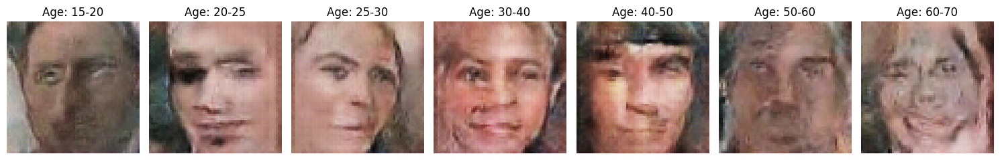

Saved checkpoint for epoch 129 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_129.pth
[Epoch 130/150] [Batch 1/79] [D loss: 0.5254476070404053] [G loss: 10.235538482666016]
[Epoch 130/150] [Batch 2/79] [D loss: 2.1488423347473145] [G loss: 9.45595932006836]
[Epoch 130/150] [Batch 3/79] [D loss: 0.2905997931957245] [G loss: 7.920196056365967]
[Epoch 130/150] [Batch 4/79] [D loss: 0.001788976602256298] [G loss: 6.692986488342285]
[Epoch 130/150] [Batch 5/79] [D loss: 0.005151557270437479] [G loss: 5.66689395904541]
[Epoch 130/150] [Batch 6/79] [D loss: 0.03728625550866127] [G loss: 4.690793991088867]
[Epoch 130/150] [Batch 7/79] [D loss: 0.026855414733290672] [G loss: 4.979536056518555]
[Epoch 130/150] [Batch 8/79] [D loss: 0.012850564904510975] [G loss: 5.316401958465576]
[Epoch 130/150] [Batch 9/79] [D loss: 0.09626932442188263] [G loss: 6.570690631866455]
[Epoch 130/150] [Batch 10/79] [D loss: 0.014121023938059807] [G loss: 7.104891777038574]
[Epoch 130

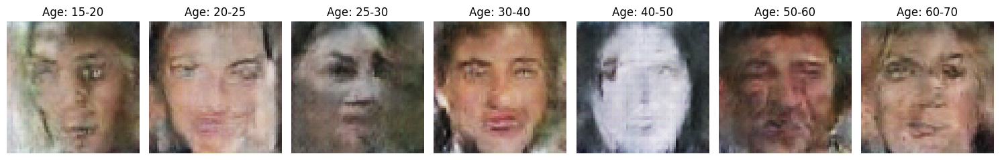

Saved checkpoint for epoch 130 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_130.pth
[Epoch 131/150] [Batch 1/79] [D loss: 0.01757102645933628] [G loss: 4.82340145111084]
[Epoch 131/150] [Batch 2/79] [D loss: 0.018695402890443802] [G loss: 4.888815879821777]
[Epoch 131/150] [Batch 3/79] [D loss: 0.0460045263171196] [G loss: 4.071585655212402]
[Epoch 131/150] [Batch 4/79] [D loss: 0.03844870626926422] [G loss: 4.073127269744873]
[Epoch 131/150] [Batch 5/79] [D loss: 0.06420020014047623] [G loss: 4.652170658111572]
[Epoch 131/150] [Batch 6/79] [D loss: 0.04440515488386154] [G loss: 4.924289226531982]
[Epoch 131/150] [Batch 7/79] [D loss: 0.03635866940021515] [G loss: 4.335328102111816]
[Epoch 131/150] [Batch 8/79] [D loss: 0.03931239992380142] [G loss: 4.045235633850098]
[Epoch 131/150] [Batch 9/79] [D loss: 0.07082679867744446] [G loss: 5.365412712097168]
[Epoch 131/150] [Batch 10/79] [D loss: 0.12819479405879974] [G loss: 4.118584632873535]
[Epoch 131/1

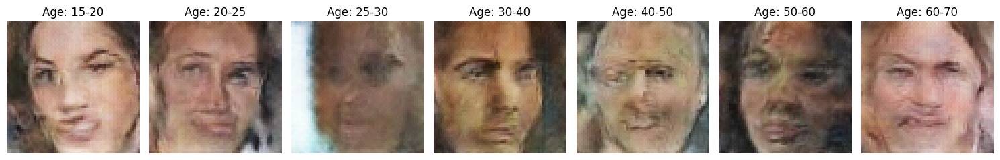

Saved checkpoint for epoch 131 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_131.pth
[Epoch 132/150] [Batch 1/79] [D loss: 0.03801439702510834] [G loss: 4.42623233795166]
[Epoch 132/150] [Batch 2/79] [D loss: 0.03547299653291702] [G loss: 4.254706382751465]
[Epoch 132/150] [Batch 3/79] [D loss: 0.07081913203001022] [G loss: 3.688417911529541]
[Epoch 132/150] [Batch 4/79] [D loss: 0.03763395920395851] [G loss: 4.084327697753906]
[Epoch 132/150] [Batch 5/79] [D loss: 0.036687951534986496] [G loss: 4.176656723022461]
[Epoch 132/150] [Batch 6/79] [D loss: 0.08858148753643036] [G loss: 3.806550979614258]
[Epoch 132/150] [Batch 7/79] [D loss: 0.0712280422449112] [G loss: 4.6158294677734375]
[Epoch 132/150] [Batch 8/79] [D loss: 0.07291825860738754] [G loss: 4.131807804107666]
[Epoch 132/150] [Batch 9/79] [D loss: 0.062467310577631] [G loss: 2.772064208984375]
[Epoch 132/150] [Batch 10/79] [D loss: 0.1869499385356903] [G loss: 7.236164093017578]
[Epoch 132/150

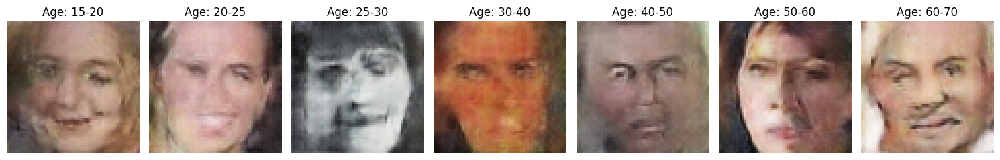

Saved checkpoint for epoch 132 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_132.pth
[Epoch 133/150] [Batch 1/79] [D loss: 0.3388920724391937] [G loss: 9.57992172241211]
[Epoch 133/150] [Batch 2/79] [D loss: 1.1830416917800903] [G loss: 7.9309611320495605]
[Epoch 133/150] [Batch 3/79] [D loss: 0.6602932214736938] [G loss: 5.534443378448486]
[Epoch 133/150] [Batch 4/79] [D loss: 0.17191219329833984] [G loss: 6.282034873962402]
[Epoch 133/150] [Batch 5/79] [D loss: 0.0601828470826149] [G loss: 6.479269981384277]
[Epoch 133/150] [Batch 6/79] [D loss: 0.09550002962350845] [G loss: 6.117159366607666]
[Epoch 133/150] [Batch 7/79] [D loss: 0.044157352298498154] [G loss: 5.557826042175293]
[Epoch 133/150] [Batch 8/79] [D loss: 0.024756165221333504] [G loss: 5.422901153564453]
[Epoch 133/150] [Batch 9/79] [D loss: 0.03206922858953476] [G loss: 5.064237594604492]
[Epoch 133/150] [Batch 10/79] [D loss: 0.05427521839737892] [G loss: 4.910041809082031]
[Epoch 133/15

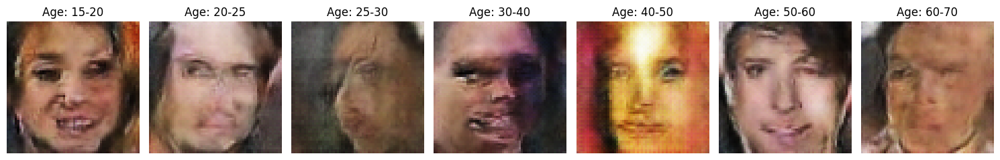

Saved checkpoint for epoch 133 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_133.pth
[Epoch 134/150] [Batch 1/79] [D loss: 0.0175709817558527] [G loss: 3.8013570308685303]
[Epoch 134/150] [Batch 2/79] [D loss: 0.15721294283866882] [G loss: 9.07557201385498]
[Epoch 134/150] [Batch 3/79] [D loss: 0.1609853208065033] [G loss: 8.81378173828125]
[Epoch 134/150] [Batch 4/79] [D loss: 0.016839738935232162] [G loss: 7.660769462585449]
[Epoch 134/150] [Batch 5/79] [D loss: 0.01757841557264328] [G loss: 6.317198753356934]
[Epoch 134/150] [Batch 6/79] [D loss: 0.025618400424718857] [G loss: 6.589591979980469]
[Epoch 134/150] [Batch 7/79] [D loss: 0.017481736838817596] [G loss: 5.983097076416016]
[Epoch 134/150] [Batch 8/79] [D loss: 0.044786058366298676] [G loss: 5.574978828430176]
[Epoch 134/150] [Batch 9/79] [D loss: 0.05552974343299866] [G loss: 6.999591827392578]
[Epoch 134/150] [Batch 10/79] [D loss: 0.043551329523324966] [G loss: 6.465737342834473]
[Epoch 13

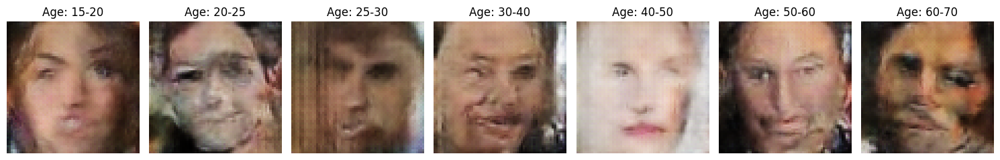

Saved checkpoint for epoch 134 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_134.pth
[Epoch 135/150] [Batch 1/79] [D loss: 0.02483472414314747] [G loss: 5.449014663696289]
[Epoch 135/150] [Batch 2/79] [D loss: 0.01618827134370804] [G loss: 5.054308891296387]
[Epoch 135/150] [Batch 3/79] [D loss: 0.031680501997470856] [G loss: 5.603209972381592]
[Epoch 135/150] [Batch 4/79] [D loss: 0.013779852539300919] [G loss: 5.965561866760254]
[Epoch 135/150] [Batch 5/79] [D loss: 0.006880161818116903] [G loss: 6.122381210327148]
[Epoch 135/150] [Batch 6/79] [D loss: 0.02678026631474495] [G loss: 4.976787567138672]
[Epoch 135/150] [Batch 7/79] [D loss: 0.012124953791499138] [G loss: 5.244009017944336]
[Epoch 135/150] [Batch 8/79] [D loss: 0.025770578533411026] [G loss: 5.199679374694824]
[Epoch 135/150] [Batch 9/79] [D loss: 0.043073251843452454] [G loss: 5.1934309005737305]
[Epoch 135/150] [Batch 10/79] [D loss: 0.02639983408153057] [G loss: 6.2481489181518555]
[Ep

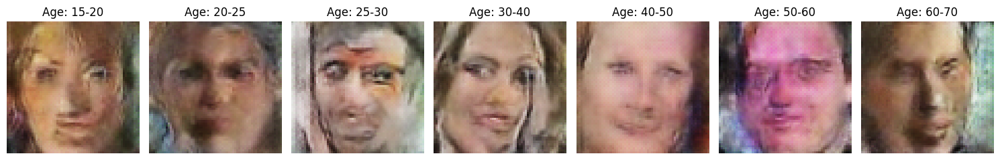

Saved checkpoint for epoch 135 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_135.pth
[Epoch 136/150] [Batch 1/79] [D loss: 0.04008590802550316] [G loss: 5.103738784790039]
[Epoch 136/150] [Batch 2/79] [D loss: 0.020897846668958664] [G loss: 5.385339736938477]
[Epoch 136/150] [Batch 3/79] [D loss: 0.02139119990170002] [G loss: 5.458302021026611]
[Epoch 136/150] [Batch 4/79] [D loss: 0.02067337930202484] [G loss: 4.896398067474365]
[Epoch 136/150] [Batch 5/79] [D loss: 0.03448592871427536] [G loss: 5.0722455978393555]
[Epoch 136/150] [Batch 6/79] [D loss: 0.04506688565015793] [G loss: 5.269930839538574]
[Epoch 136/150] [Batch 7/79] [D loss: 0.022679461166262627] [G loss: 5.715491771697998]
[Epoch 136/150] [Batch 8/79] [D loss: 0.01950696110725403] [G loss: 4.865911483764648]
[Epoch 136/150] [Batch 9/79] [D loss: 0.030943434685468674] [G loss: 4.7909440994262695]
[Epoch 136/150] [Batch 10/79] [D loss: 0.041690271347761154] [G loss: 5.704194068908691]
[Epoc

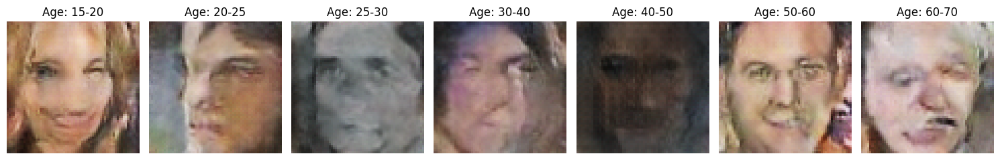

Saved checkpoint for epoch 136 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_136.pth
[Epoch 137/150] [Batch 1/79] [D loss: 1.0962706804275513] [G loss: 11.522186279296875]
[Epoch 137/150] [Batch 2/79] [D loss: 2.8759288787841797] [G loss: 10.397579193115234]
[Epoch 137/150] [Batch 3/79] [D loss: 2.272495985031128] [G loss: 7.891160011291504]
[Epoch 137/150] [Batch 4/79] [D loss: 0.915917694568634] [G loss: 5.744866371154785]
[Epoch 137/150] [Batch 5/79] [D loss: 0.26440146565437317] [G loss: 3.7121946811676025]
[Epoch 137/150] [Batch 6/79] [D loss: 0.17717748880386353] [G loss: 3.6713459491729736]
[Epoch 137/150] [Batch 7/79] [D loss: 0.062444932758808136] [G loss: 4.183313846588135]
[Epoch 137/150] [Batch 8/79] [D loss: 0.02906598336994648] [G loss: 4.624631404876709]
[Epoch 137/150] [Batch 9/79] [D loss: 0.03234390169382095] [G loss: 4.153972148895264]
[Epoch 137/150] [Batch 10/79] [D loss: 0.030310099944472313] [G loss: 4.322976112365723]
[Epoch 137/

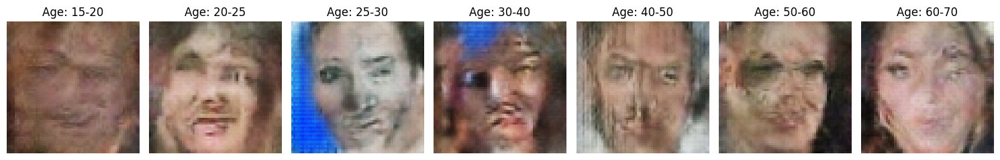

Saved checkpoint for epoch 137 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_137.pth
[Epoch 138/150] [Batch 1/79] [D loss: 0.038728017359972] [G loss: 5.9610066413879395]
[Epoch 138/150] [Batch 2/79] [D loss: 0.031333036720752716] [G loss: 5.9531941413879395]
[Epoch 138/150] [Batch 3/79] [D loss: 0.0089600570499897] [G loss: 5.43510627746582]
[Epoch 138/150] [Batch 4/79] [D loss: 0.00938256923109293] [G loss: 4.943990707397461]
[Epoch 138/150] [Batch 5/79] [D loss: 0.013650663197040558] [G loss: 4.701634407043457]
[Epoch 138/150] [Batch 6/79] [D loss: 0.017322642728686333] [G loss: 4.9058427810668945]
[Epoch 138/150] [Batch 7/79] [D loss: 0.024877840653061867] [G loss: 4.61907958984375]
[Epoch 138/150] [Batch 8/79] [D loss: 0.03757563233375549] [G loss: 4.127958297729492]
[Epoch 138/150] [Batch 9/79] [D loss: 0.027714885771274567] [G loss: 5.225495338439941]
[Epoch 138/150] [Batch 10/79] [D loss: 0.013797378167510033] [G loss: 5.349469184875488]
[Epoch 

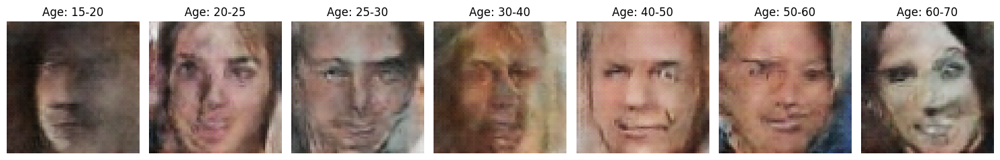

Saved checkpoint for epoch 138 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_138.pth
[Epoch 139/150] [Batch 1/79] [D loss: 0.024342428892850876] [G loss: 4.049290657043457]
[Epoch 139/150] [Batch 2/79] [D loss: 0.037201616913080215] [G loss: 4.076539039611816]
[Epoch 139/150] [Batch 3/79] [D loss: 0.08917050808668137] [G loss: 4.047708034515381]
[Epoch 139/150] [Batch 4/79] [D loss: 0.02640991285443306] [G loss: 4.444705009460449]
[Epoch 139/150] [Batch 5/79] [D loss: 0.04352440685033798] [G loss: 4.19990348815918]
[Epoch 139/150] [Batch 6/79] [D loss: 0.04088588431477547] [G loss: 3.9432075023651123]
[Epoch 139/150] [Batch 7/79] [D loss: 0.03604598715901375] [G loss: 4.136398792266846]
[Epoch 139/150] [Batch 8/79] [D loss: 0.04533951357007027] [G loss: 3.9961814880371094]
[Epoch 139/150] [Batch 9/79] [D loss: 0.09470493346452713] [G loss: 4.006471633911133]
[Epoch 139/150] [Batch 10/79] [D loss: 0.09456279873847961] [G loss: 3.782667636871338]
[Epoch 1

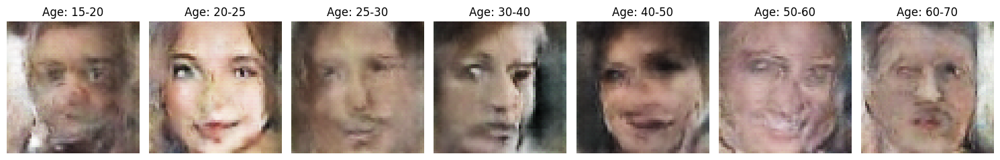

Saved checkpoint for epoch 139 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_139.pth
[Epoch 140/150] [Batch 1/79] [D loss: 0.01397155225276947] [G loss: 5.107460975646973]
[Epoch 140/150] [Batch 2/79] [D loss: 0.02040913701057434] [G loss: 4.730311393737793]
[Epoch 140/150] [Batch 3/79] [D loss: 0.022758398205041885] [G loss: 4.945306777954102]
[Epoch 140/150] [Batch 4/79] [D loss: 0.017316091805696487] [G loss: 5.190098762512207]
[Epoch 140/150] [Batch 5/79] [D loss: 0.02871815487742424] [G loss: 4.430710792541504]
[Epoch 140/150] [Batch 6/79] [D loss: 0.02494056150317192] [G loss: 5.428732872009277]
[Epoch 140/150] [Batch 7/79] [D loss: 0.03439848870038986] [G loss: 4.874551773071289]
[Epoch 140/150] [Batch 8/79] [D loss: 0.05555359646677971] [G loss: 2.9240708351135254]
[Epoch 140/150] [Batch 9/79] [D loss: 0.16768021881580353] [G loss: 9.42816162109375]
[Epoch 140/150] [Batch 10/79] [D loss: 1.2744150161743164] [G loss: 7.996203899383545]
[Epoch 140

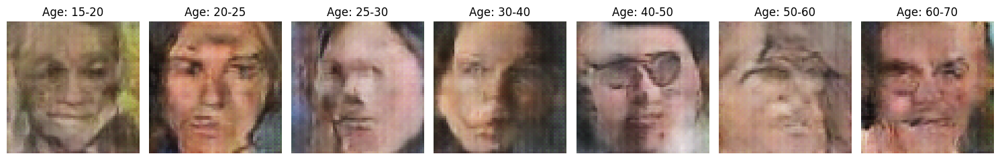

Saved checkpoint for epoch 140 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_140.pth
[Epoch 141/150] [Batch 1/79] [D loss: 0.9979617595672607] [G loss: 3.7046988010406494]
[Epoch 141/150] [Batch 2/79] [D loss: 0.5269426107406616] [G loss: 2.7216646671295166]
[Epoch 141/150] [Batch 3/79] [D loss: 0.5030936002731323] [G loss: 2.313851833343506]
[Epoch 141/150] [Batch 4/79] [D loss: 0.3018973171710968] [G loss: 2.3759474754333496]
[Epoch 141/150] [Batch 5/79] [D loss: 0.17650946974754333] [G loss: 2.7395498752593994]
[Epoch 141/150] [Batch 6/79] [D loss: 0.19114291667938232] [G loss: 2.777977705001831]
[Epoch 141/150] [Batch 7/79] [D loss: 0.22079721093177795] [G loss: 2.288261890411377]
[Epoch 141/150] [Batch 8/79] [D loss: 0.14085152745246887] [G loss: 2.5716404914855957]
[Epoch 141/150] [Batch 9/79] [D loss: 0.12403124570846558] [G loss: 2.726029872894287]
[Epoch 141/150] [Batch 10/79] [D loss: 0.14606508612632751] [G loss: 2.686347007751465]
[Epoch 141

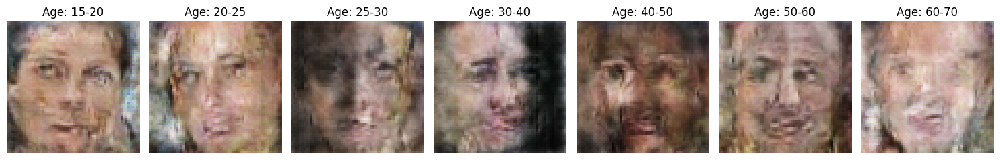

Saved checkpoint for epoch 141 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_141.pth
[Epoch 142/150] [Batch 1/79] [D loss: 0.016831116750836372] [G loss: 5.392751693725586]
[Epoch 142/150] [Batch 2/79] [D loss: 0.06185048818588257] [G loss: 5.351432800292969]
[Epoch 142/150] [Batch 3/79] [D loss: 0.033826157450675964] [G loss: 5.488857269287109]
[Epoch 142/150] [Batch 4/79] [D loss: 0.02900247648358345] [G loss: 4.886283874511719]
[Epoch 142/150] [Batch 5/79] [D loss: 0.06711441278457642] [G loss: 4.314972877502441]
[Epoch 142/150] [Batch 6/79] [D loss: 0.10339612513780594] [G loss: 4.608464241027832]
[Epoch 142/150] [Batch 7/79] [D loss: 0.11094021052122116] [G loss: 4.375149726867676]
[Epoch 142/150] [Batch 8/79] [D loss: 0.05897316709160805] [G loss: 4.282530307769775]
[Epoch 142/150] [Batch 9/79] [D loss: 0.04610460624098778] [G loss: 4.40443229675293]
[Epoch 142/150] [Batch 10/79] [D loss: 0.07672277837991714] [G loss: 4.693741798400879]
[Epoch 142

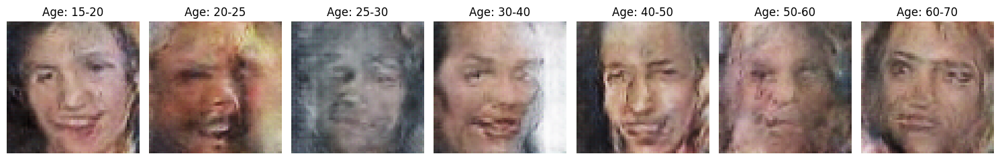

Saved checkpoint for epoch 142 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_142.pth
[Epoch 143/150] [Batch 1/79] [D loss: 0.03233063220977783] [G loss: 5.242212772369385]
[Epoch 143/150] [Batch 2/79] [D loss: 0.05386880785226822] [G loss: 5.0192646980285645]
[Epoch 143/150] [Batch 3/79] [D loss: 0.0874795988202095] [G loss: 5.838406562805176]
[Epoch 143/150] [Batch 4/79] [D loss: 0.008563627488911152] [G loss: 6.52431058883667]
[Epoch 143/150] [Batch 5/79] [D loss: 0.009152465499937534] [G loss: 6.065852165222168]
[Epoch 143/150] [Batch 6/79] [D loss: 0.016070403158664703] [G loss: 5.550351619720459]
[Epoch 143/150] [Batch 7/79] [D loss: 0.007214855868369341] [G loss: 5.481938362121582]
[Epoch 143/150] [Batch 8/79] [D loss: 0.010389738716185093] [G loss: 4.870959758758545]
[Epoch 143/150] [Batch 9/79] [D loss: 0.016347423195838928] [G loss: 4.419368743896484]
[Epoch 143/150] [Batch 10/79] [D loss: 0.02009458839893341] [G loss: 4.249326705932617]
[Epoch

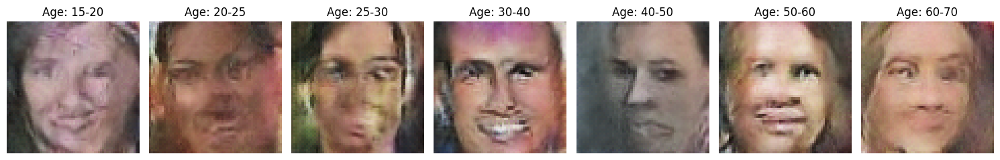

Saved checkpoint for epoch 143 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_143.pth
[Epoch 144/150] [Batch 1/79] [D loss: 0.03514660894870758] [G loss: 5.057109355926514]
[Epoch 144/150] [Batch 2/79] [D loss: 0.02105265110731125] [G loss: 5.433143615722656]
[Epoch 144/150] [Batch 3/79] [D loss: 0.053065016865730286] [G loss: 5.077117443084717]
[Epoch 144/150] [Batch 4/79] [D loss: 0.03993342071771622] [G loss: 6.312271595001221]
[Epoch 144/150] [Batch 5/79] [D loss: 0.07399627566337585] [G loss: 5.210126876831055]
[Epoch 144/150] [Batch 6/79] [D loss: 0.023241085931658745] [G loss: 4.069577693939209]
[Epoch 144/150] [Batch 7/79] [D loss: 0.019995147362351418] [G loss: 5.100399017333984]
[Epoch 144/150] [Batch 8/79] [D loss: 0.05640481412410736] [G loss: 7.614484786987305]
[Epoch 144/150] [Batch 9/79] [D loss: 0.19811443984508514] [G loss: 4.437206268310547]
[Epoch 144/150] [Batch 10/79] [D loss: 0.009949196130037308] [G loss: 4.503167152404785]
[Epoch 

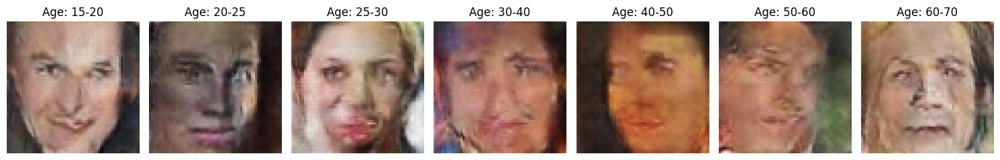

Saved checkpoint for epoch 144 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_144.pth
[Epoch 145/150] [Batch 1/79] [D loss: 0.035716064274311066] [G loss: 5.346527576446533]
[Epoch 145/150] [Batch 2/79] [D loss: 0.030008427798748016] [G loss: 4.684293270111084]
[Epoch 145/150] [Batch 3/79] [D loss: 0.015018058009445667] [G loss: 4.66461181640625]
[Epoch 145/150] [Batch 4/79] [D loss: 0.026680894196033478] [G loss: 5.088973045349121]
[Epoch 145/150] [Batch 5/79] [D loss: 0.0806831493973732] [G loss: 2.3571178913116455]
[Epoch 145/150] [Batch 6/79] [D loss: 0.2313878834247589] [G loss: 9.580533981323242]
[Epoch 145/150] [Batch 7/79] [D loss: 1.1270984411239624] [G loss: 8.082464218139648]
[Epoch 145/150] [Batch 8/79] [D loss: 0.2185964733362198] [G loss: 6.03846549987793]
[Epoch 145/150] [Batch 9/79] [D loss: 0.039829403162002563] [G loss: 4.698312282562256]
[Epoch 145/150] [Batch 10/79] [D loss: 0.06855607777833939] [G loss: 6.085413932800293]
[Epoch 145/

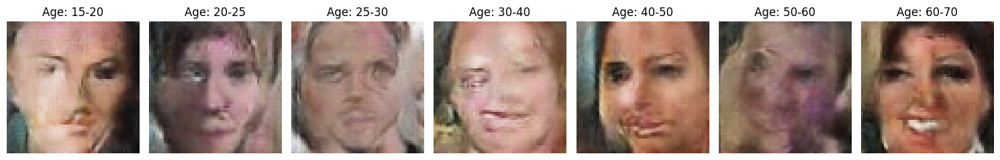

Saved checkpoint for epoch 145 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_145.pth
[Epoch 146/150] [Batch 1/79] [D loss: 0.010886570438742638] [G loss: 5.573429107666016]
[Epoch 146/150] [Batch 2/79] [D loss: 0.24616985023021698] [G loss: 10.754866600036621]
[Epoch 146/150] [Batch 3/79] [D loss: 1.5260955095291138] [G loss: 9.572900772094727]
[Epoch 146/150] [Batch 4/79] [D loss: 0.6205285787582397] [G loss: 7.374532699584961]
[Epoch 146/150] [Batch 5/79] [D loss: 0.018327120691537857] [G loss: 4.713602066040039]
[Epoch 146/150] [Batch 6/79] [D loss: 0.22849972546100616] [G loss: 8.723981857299805]
[Epoch 146/150] [Batch 7/79] [D loss: 0.015920130535960197] [G loss: 9.20988655090332]
[Epoch 146/150] [Batch 8/79] [D loss: 0.09487595409154892] [G loss: 8.818964004516602]
[Epoch 146/150] [Batch 9/79] [D loss: 0.01663348264992237] [G loss: 8.479806900024414]
[Epoch 146/150] [Batch 10/79] [D loss: 0.015074240043759346] [G loss: 7.630941390991211]
[Epoch 14

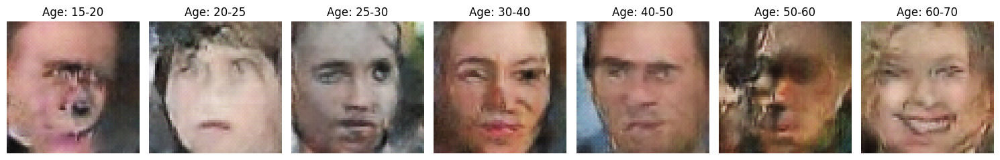

Saved checkpoint for epoch 146 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_146.pth
[Epoch 147/150] [Batch 1/79] [D loss: 0.04901273176074028] [G loss: 5.788504600524902]
[Epoch 147/150] [Batch 2/79] [D loss: 0.026628335937857628] [G loss: 5.2919416427612305]
[Epoch 147/150] [Batch 3/79] [D loss: 0.022429637610912323] [G loss: 5.250431060791016]
[Epoch 147/150] [Batch 4/79] [D loss: 0.043352216482162476] [G loss: 4.0764336585998535]
[Epoch 147/150] [Batch 5/79] [D loss: 0.020840216428041458] [G loss: 4.854333877563477]
[Epoch 147/150] [Batch 6/79] [D loss: 0.02482862025499344] [G loss: 5.947258472442627]
[Epoch 147/150] [Batch 7/79] [D loss: 0.039569322019815445] [G loss: 5.0054450035095215]
[Epoch 147/150] [Batch 8/79] [D loss: 0.04033201187849045] [G loss: 4.595400810241699]
[Epoch 147/150] [Batch 9/79] [D loss: 0.04021066799759865] [G loss: 5.748427391052246]
[Epoch 147/150] [Batch 10/79] [D loss: 0.02739734761416912] [G loss: 5.473973274230957]
[Ep

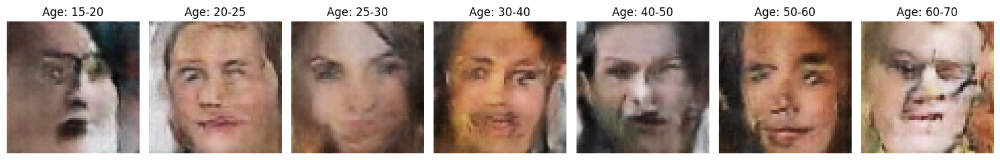

Saved checkpoint for epoch 147 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_147.pth
[Epoch 148/150] [Batch 1/79] [D loss: 0.23088613152503967] [G loss: 3.2681870460510254]
[Epoch 148/150] [Batch 2/79] [D loss: 0.15640300512313843] [G loss: 4.074106216430664]
[Epoch 148/150] [Batch 3/79] [D loss: 0.05538535118103027] [G loss: 4.245563983917236]
[Epoch 148/150] [Batch 4/79] [D loss: 0.05058674514293671] [G loss: 3.9916892051696777]
[Epoch 148/150] [Batch 5/79] [D loss: 0.031308092176914215] [G loss: 4.30957555770874]
[Epoch 148/150] [Batch 6/79] [D loss: 0.04184671491384506] [G loss: 3.94490909576416]
[Epoch 148/150] [Batch 7/79] [D loss: 0.07076834887266159] [G loss: 3.5983057022094727]
[Epoch 148/150] [Batch 8/79] [D loss: 0.03823232650756836] [G loss: 4.191686630249023]
[Epoch 148/150] [Batch 9/79] [D loss: 0.06470061838626862] [G loss: 3.895237922668457]
[Epoch 148/150] [Batch 10/79] [D loss: 0.04819478467106819] [G loss: 3.649099826812744]
[Epoch 14

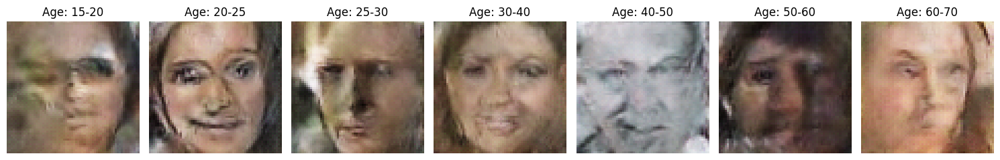

Saved checkpoint for epoch 148 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_148.pth
[Epoch 149/150] [Batch 1/79] [D loss: 0.036920659244060516] [G loss: 6.347855567932129]
[Epoch 149/150] [Batch 2/79] [D loss: 0.02054530382156372] [G loss: 6.5921950340271]
[Epoch 149/150] [Batch 3/79] [D loss: 0.07989335805177689] [G loss: 3.743655204772949]
[Epoch 149/150] [Batch 4/79] [D loss: 0.11275053769350052] [G loss: 9.429338455200195]
[Epoch 149/150] [Batch 5/79] [D loss: 0.2995690405368805] [G loss: 7.229740619659424]
[Epoch 149/150] [Batch 6/79] [D loss: 0.013884411193430424] [G loss: 6.068847179412842]
[Epoch 149/150] [Batch 7/79] [D loss: 0.3384649455547333] [G loss: 9.351800918579102]
[Epoch 149/150] [Batch 8/79] [D loss: 1.6699283123016357] [G loss: 8.158525466918945]
[Epoch 149/150] [Batch 9/79] [D loss: 0.8080881834030151] [G loss: 6.612527370452881]
[Epoch 149/150] [Batch 10/79] [D loss: 0.05354699864983559] [G loss: 4.639081001281738]
[Epoch 149/150]

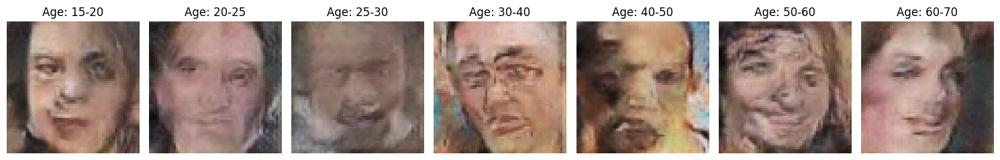

Saved checkpoint for epoch 149 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_149.pth
[Epoch 150/150] [Batch 1/79] [D loss: 0.039262764155864716] [G loss: 6.501491069793701]
[Epoch 150/150] [Batch 2/79] [D loss: 0.025053570047020912] [G loss: 6.080635070800781]
[Epoch 150/150] [Batch 3/79] [D loss: 0.01275816559791565] [G loss: 5.455016136169434]
[Epoch 150/150] [Batch 4/79] [D loss: 0.008553850464522839] [G loss: 5.396142482757568]
[Epoch 150/150] [Batch 5/79] [D loss: 0.013453157618641853] [G loss: 5.366622447967529]
[Epoch 150/150] [Batch 6/79] [D loss: 0.029883287847042084] [G loss: 5.7842607498168945]
[Epoch 150/150] [Batch 7/79] [D loss: 0.026401570066809654] [G loss: 5.167691707611084]
[Epoch 150/150] [Batch 8/79] [D loss: 0.024363534525036812] [G loss: 4.859475135803223]
[Epoch 150/150] [Batch 9/79] [D loss: 0.008380310609936714] [G loss: 5.286882400512695]
[Epoch 150/150] [Batch 10/79] [D loss: 0.006467876024544239] [G loss: 5.473818778991699]
[

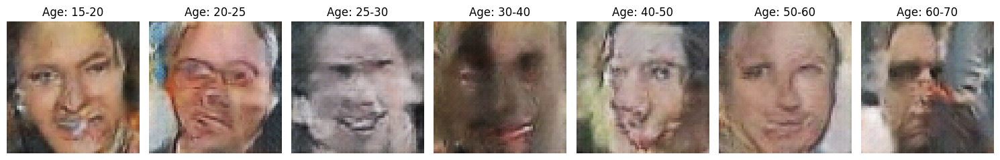

Saved checkpoint for epoch 150 to /content/drive/My Drive/CV_team_project2/model_checkpoints/checkpoint_epoch_150.pth


In [20]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)

criterion = nn.BCELoss()
optimizer_G = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Initialize metrics
fid = FrechetInceptionDistance(feature=2048).to(device)  # Feature size of InceptionNet
inception = InceptionScore().to(device)

# Initialize lists to store metrics
fid_scores = []

epochs = 150
latent_dim = 100

checkpoint_dir = "/content/drive/My Drive/CV_team_project2/model_checkpoints"
os.makedirs(checkpoint_dir, exist_ok=True)

# Initialize lists to store losses
d_losses = []
g_losses = []

for epoch in range(epochs):
    epoch_d_loss = 0
    epoch_g_loss = 0
    for i, (imgs, labels) in enumerate(train_loader):
        batch_size = imgs.size(0)
        imgs, labels = imgs.to(device), labels.to(device)

        # Real and fake labels
        valid = torch.ones((batch_size, 1), requires_grad=False).to(device)
        fake = torch.zeros((batch_size, 1), requires_grad=False).to(device)

        # Train Discriminator
        optimizer_D.zero_grad()
        real_loss = criterion(discriminator(imgs, labels), valid)

        noise = torch.randn(batch_size, latent_dim, 1, 1).to(device)
        gen_labels = torch.randint(0, num_classes, (batch_size,)).to(device)
        fake_imgs = generator(noise, gen_labels)
        fake_loss = criterion(discriminator(fake_imgs.detach(), gen_labels), fake)

        d_loss = (real_loss + fake_loss) / 2
        d_loss.backward()
        optimizer_D.step()

        # Train Generator
        optimizer_G.zero_grad()
        g_loss = criterion(discriminator(fake_imgs, gen_labels), valid)
        g_loss.backward()
        optimizer_G.step()

        # Accumulate losses for the epoch
        epoch_d_loss += d_loss.item()
        epoch_g_loss += g_loss.item()

        print(f"[Epoch {epoch+1}/{epochs}] [Batch {i+1}/{len(train_loader)}] [D loss: {d_loss.item()}] [G loss: {g_loss.item()}]")

    # Average losses for the epoch
    d_losses.append(epoch_d_loss / len(train_loader))
    g_losses.append(epoch_g_loss / len(train_loader))

    # Visualization of generated images
    generator.eval()
    with torch.no_grad():
        # FID computation
        imgs = (imgs * 255).clamp(0, 255).byte()  # Convert real images to uint8
        fake_imgs = ((fake_imgs + 1) / 2 * 255).clamp(0, 255).byte()

        fid.update(imgs, real=True)  # Real images
        fid.update(fake_imgs, real=False)  # Generated images
        current_fid = fid.compute().item()
        fid_scores.append(current_fid)

        # Inception Score computation
        inception.update(fake_imgs)
        current_inception_score, _ = inception.compute()  # Extract only the score
        fixed_noise = torch.randn(7, latent_dim, 1, 1).to(device)  # Generate 7 random noise vectors
        fixed_labels = torch.arange(0, 7).to(device)  # Labels for each age range
        generated_images = generator(fixed_noise, fixed_labels)
        generated_images = (generated_images + 1) / 2  # Rescale to [0, 1]

        # Display images inline
        grid_img = generated_images.cpu().permute(0,2,3,1)  # Convert to (N, H, W, C)
        plt.figure(figsize=(15, 5))
        for idx, img in enumerate(grid_img):
            plt.subplot(1, 7, idx + 1)
            plt.imshow(img.numpy())
            plt.axis("off")
            plt.title(f"Age: {list(age_range_to_label.keys())[idx]}")
        plt.tight_layout()
        plt.show()

    generator.train()

    # Save model checkpoints
    checkpoint_path = os.path.join(checkpoint_dir, f"checkpoint_epoch_{epoch+1}.pth")
    torch.save({
        'epoch': epoch + 1,
        'generator_state_dict': generator.state_dict(),
        'discriminator_state_dict': discriminator.state_dict(),
        'optimizer_G_state_dict': optimizer_G.state_dict(),
        'optimizer_D_state_dict': optimizer_D.state_dict(),
        'g_loss': epoch_g_loss / len(train_loader),
        'd_loss': epoch_d_loss / len(train_loader),
    }, checkpoint_path)
    print(f"Saved checkpoint for epoch {epoch+1} to {checkpoint_path}")


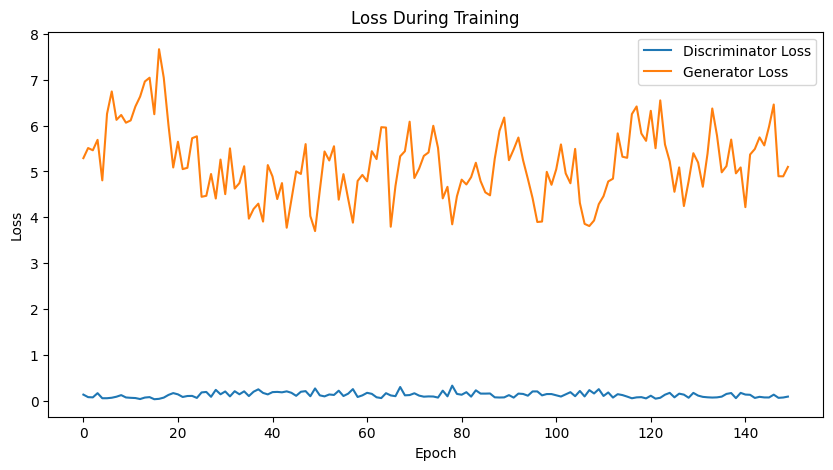

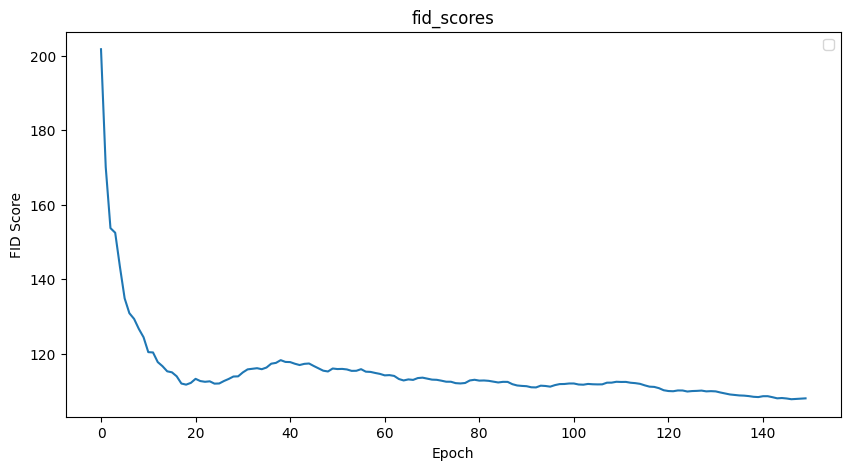

In [23]:
# Plot losses after all epochs
fid_scores = [score.cpu().item() if torch.is_tensor(score) else score for score in fid_scores]

plt.figure(figsize=(10, 5))
plt.plot(d_losses, label="Discriminator Loss")
plt.plot(g_losses, label="Generator Loss")
plt.title("Loss During Training")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.show()

plt.figure(figsize=(10, 5))
plt.plot(fid_scores)
plt.title("fid_scores")
plt.xlabel("Epoch")
plt.ylabel("FID Score")
plt.legend()
plt.show()